In [1]:
import os
import re
import pandas as pd
import seaborn as sns
from sklearn.cluster import DBSCAN
import geopandas as gpd
import matplotlib.pyplot as plt
from matplotlib.colors import to_rgb, to_hex
from PIL import Image
import numpy as np
import numpy as np   
import xarray as xr  # xarray is a package to interact with large geophysical datasets
import datetime
import matplotlib.pyplot as plt  # ploting package 
import os  # import os commands for making paths
import cartopy.crs as ccrs  # for plotting maps
import cartopy.feature as cfeat # for plotting maps
import seaborn as sns 
from glob import glob
import matplotlib.colors as colors
from sklearn.cluster import KMeans
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from matplotlib import pyplot as plt
import plotly.graph_objects as go
import matplotlib.cm as cm
%matplotlib inline

# this is the package that runs a Self ORganizinag Map on the data
from minisom import MiniSom    # specialised minisom calculation

from minisom import MiniSom

import pandas as pd
import numpy as np


import matplotlib.pyplot as plt
from matplotlib.patches import RegularPolygon, Ellipse
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import cm, colorbar
from matplotlib.lines import Line2D
from sklearn.preprocessing import StandardScaler
from scipy.interpolate import griddata

# display matplotlib plots in notebook
%matplotlib inline


In [9]:
df=pd.read_csv(r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 5 - 1891-01-11 to 1891-01-17.csv')
df.head()

x=df[['Latitude','Longitude','Rainfall 1891-01-17']]
x.head()

x_cleaned=x.dropna()
x_cleaned.head(10)



,Latitude,Longitude,Rainfall 1891-01-17
0,-28.2333,153.4667,0.0
1,-34.7000,150.6833,69.3
2,-34.5845,150.5926,88.9
3,-28.2025,153.5502,6.9
5,-30.5000,152.9000,58.4
6,-28.3167,153.4333,2.5
7,-28.3167,153.4000,35.6
8,-30.7241,152.9168,6.4
9,-30.6500,152.8486,55.9
10,-34.6500,150.7833,43.7


Text(0, 0.5, 'Latitude')

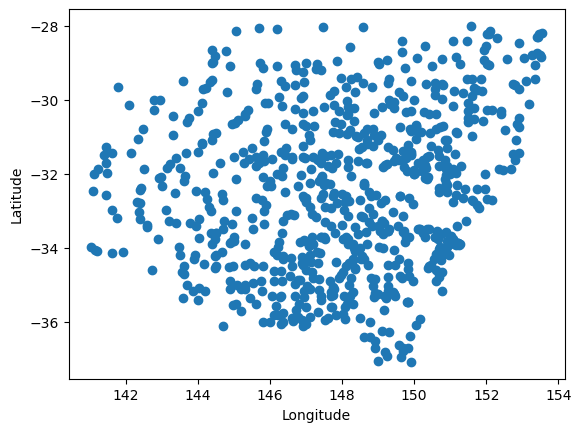

In [11]:
plt.scatter(x_cleaned.Longitude,x_cleaned.Latitude)
plt.xlabel('Longitude')
plt.ylabel('Latitude')

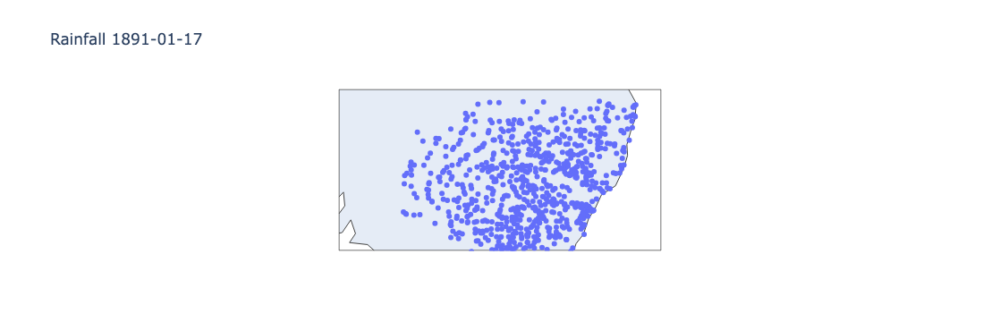

In [21]:
fig = go.Figure(data=go.Scattergeo(
        lon = x_cleaned['Longitude'],
        lat = x_cleaned['Latitude'],
        text = x_cleaned['Rainfall 1891-01-17'],
        mode = 'markers',
        marker_color = 25129,
        ))

fig.update_layout(
        title = 'Rainfall 1891-01-17',
        geo_scope='world',
    )
fig.show()

C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.

C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. Y

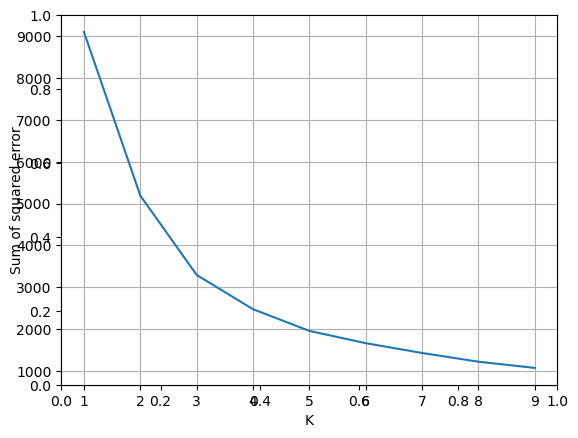

In [24]:
#Elbow Plot
sse = []
K = []
k_rng = range(1,10)
for k in k_rng:
    km = KMeans(n_clusters=k)
    km.fit(x_cleaned[['Latitude','Longitude']])
    sse.append(km.inertia_)
    K.append(k)

plt.xlabel('K')
plt.ylabel('Sum of squared error')
axes= plt.axes()
axes.set_xticks(K)
plt.grid()
plt.plot(k_rng,sse)
#plt.scatter(k_rng,sse,color='green')

In [25]:
km = KMeans(n_clusters=3)
y_predicted = km.fit_predict(x_cleaned[['Latitude','Longitude']])
y_predicted

C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.



array([2, 1, 1, 2, 2, 2, 2, 2, 2, 1, 1, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 2,
       1, 2, 1, 1, 1, 2, 1, 1, 1, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 2,
       2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 1, 2, 1, 2, 2, 1,
       1, 1, 2, 1, 2, 1, 2, 2, 2, 2, 1, 1, 1, 2, 2, 1, 1, 1, 1, 2, 1, 2,
       1, 1, 2, 1, 2, 2, 1, 1, 1, 2, 2, 1, 1, 2, 2, 2, 1, 2, 2, 1, 2, 2,
       2, 0, 2, 2, 2, 2, 1, 2, 2, 2, 1, 1, 0, 2, 0, 2, 0, 0, 1, 2, 2, 1,
       2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 1, 2, 2, 0, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 0, 2, 2, 2, 2,
       1, 2, 1, 2, 1, 2, 0, 2, 2, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 2,
       2, 1, 2, 0, 2, 1, 0, 2, 2, 2, 2, 2, 1, 2, 0, 2, 2, 2, 2, 2, 2, 2,
       1, 1, 0, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 1, 2, 2, 0, 2, 2,
       2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 1, 2, 2, 1,
       1, 2, 2, 1, 0, 0, 2, 0, 1, 0, 1, 0, 1, 1, 1, 2, 0, 2, 2, 2, 2, 2,
       2, 2, 0, 2, 0, 2, 0, 1, 1, 2, 2, 0, 2, 1, 2,

In [26]:
x_cleaned['cluster']=y_predicted
x_cleaned.head()
     

C:\Users\RUCHITSANDIP\AppData\Local\Temp\ipykernel_10884\2186038440.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Latitude,Longitude,Rainfall 1891-01-17,cluster
0,-28.2333,153.4667,0.0,2
1,-34.7000,150.6833,69.3,1
2,-34.5845,150.5926,88.9,1
3,-28.2025,153.5502,6.9,2
5,-30.5000,152.9000,58.4,2


In [27]:
km.cluster_centers_
     

array([[-32.08589211, 144.73126667],
       [-34.37495833, 148.45792153],
       [-30.57327269, 150.41121723]])

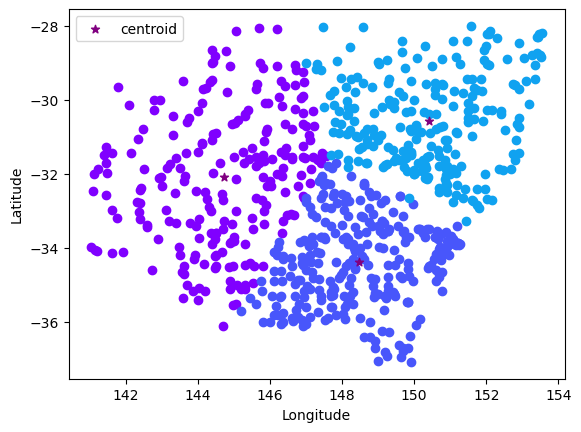

In [33]:
x_c = {}
colors = cm.rainbow(np.linspace(0, 1,10))
for c in range(0,10):
  x_c[c] = x_cleaned[x_cleaned.cluster==c]
  plt.scatter(x_c[c].Longitude,x_c[c].Latitude,color=colors[c])

plt.scatter(km.cluster_centers_[:,1],km.cluster_centers_[:,0],color='purple',marker='*',label='centroid')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend()

C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.

C:\Users\RUCHITSANDIP\AppData\Local\Temp\ipykernel_10884\2551468026.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



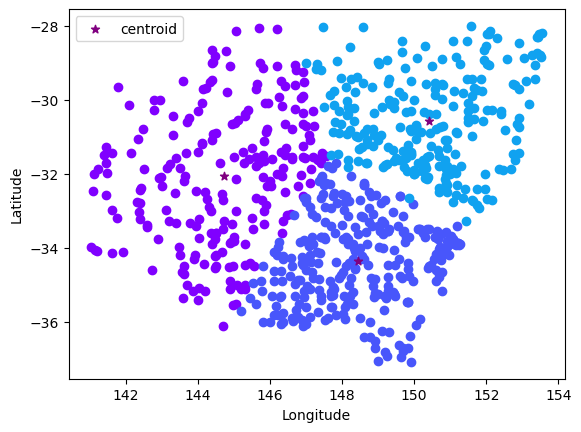

In [35]:
y=df[['Latitude','Longitude','Rainfall 1891-01-16']]

y_cleaned=y.dropna()

km = KMeans(n_clusters=3)
y_predicted = km.fit_predict(y_cleaned[['Latitude','Longitude']])


y_cleaned['cluster']=y_predicted

y_c = {}
colors = cm.rainbow(np.linspace(0, 1,10))
for c in range(0,10):
  y_c[c] = y_cleaned[y_cleaned.cluster==c]
  plt.scatter(y_c[c].Longitude,y_c[c].Latitude,color=colors[c])

plt.scatter(km.cluster_centers_[:,1],km.cluster_centers_[:,0],color='purple',marker='*',label='centroid')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend()


In [1]:
import os
import re
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from matplotlib.colors import to_rgb, to_hex
from PIL import Image

# Path to the combined shapefile
combined_shapefile = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\combined_shapefile.shp'

# Read the combined shapefile
combined_gdf = gpd.read_file(combined_shapefile)

# Path to the Excel file containing event data
excel_file = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\R1_99_New Events.xlsx'

# Read the Excel file, considering the sheet with event group information
event_df = pd.read_excel(excel_file, sheet_name='Sheet2')



# Read the station data
station_df = pd.read_excel(r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Station_list_names.xlsx')
station_df['Latitude '] = station_df['Latitude '].astype(str).str.replace(r'[^\d.-]', '', regex=True).astype(float)
station_df['Longitude '] = station_df['Longitude '].astype(str).str.replace(r'[^\d.-]', '', regex=True).astype(float)

# Define colors for each day
day_colors = ['orange', 'red', 'blue', 'green', 'purple', 'brown', 'pink']

def extract_date_range(event_text):
    if pd.isna(event_text):
        return None, None
    pattern = r'\d{4}-\d{2}-\d{2}'
    dates = re.findall(pattern, event_text)
    if len(dates) == 2:
        return pd.to_datetime(dates[0]), pd.to_datetime(dates[1])
    else:
        return None, None

def blend_colors(colors):
    rgb_colors = [to_rgb(color) for color in colors]
    avg_rgb = [sum(component) / len(component) for component in zip(*rgb_colors)]
    return to_hex(avg_rgb)

# Function to plot and return combined map frames for all days
def plot_combined_map(date_range, stations_by_day):
    station_colors = {}

    for day_index, (date, stations) in enumerate(stations_by_day.items()):
        for station in stations:
            station_id = station['Station Number']
            if station_id not in station_colors:
                station_colors[station_id] = []
            station_colors[station_id].append(day_colors[day_index % len(day_colors)])
    
    # Create frames for each day
    frames = []
    for day_index, (date, stations) in enumerate(stations_by_day.items()):
        fig, ax = plt.subplots(figsize=(15, 10))
        fig.patch.set_facecolor('white')
        ax.set_facecolor('white')
        combined_gdf.plot(ax=ax, color='gray', alpha=0.5, edgecolor='none')

        for _, station in station_df.iterrows():
            station_id = station['Bureau of Meteorology Station Number']
            latitude = station['Latitude ']
            longitude = station['Longitude ']
            color = 'lightgrey' if station_id not in station_colors else blend_colors(station_colors[station_id])
            ax.scatter(longitude, latitude, color=color, s=50, zorder=5)

        for station in stations:
            station_id = station['Station Number']
            latitude = station['Latitude']
            longitude = station['Longitude']
            ax.scatter(longitude, latitude, color=day_colors[day_index % len(day_colors)], s=100, edgecolor='black', zorder=10)

        ax.set_axis_off()
        ax.grid(True, color='black', linestyle='--', linewidth=0.5)

        # Add legend
        handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=day_colors[i], markersize=10) for i in range(len(day_colors))]
        labels = [f'Day {i + 1}' for i in range(len(day_colors))]
        ax.legend(handles, labels, loc='lower right')

        # Convert plot to an image and append to frames
        fig.canvas.draw()
        image = Image.frombytes('RGB', fig.canvas.get_width_height(), fig.canvas.tostring_rgb())
        frames.append(image)
        plt.close()

    return frames

# Function to parse event groups from the provided DataFrame
def parse_event_groups(event_df):
    events = {}
    current_event = None
    for index, row in event_df.iterrows():
        event_text = row['Event']
        if pd.notna(event_text) and 'Event' in event_text:
            current_event = event_text
            events[current_event] = []
        else:
            if current_event is not None:
                station_number = row['Station Number'].split(": ")[1]
                date = pd.to_datetime(row['Date'].split(": ")[1])
                rainfall = float(row['Rainfall'].split(": ")[1])
                latitude = station_df[station_df['Bureau of Meteorology Station Number'] == int(station_number)]['Latitude '].values[0]
                longitude = station_df[station_df['Bureau of Meteorology Station Number'] == int(station_number)]['Longitude '].values[0]
                events[current_event].append({'Station Number': station_number, 'Date': date, 'Rainfall': rainfall, 'Latitude': latitude, 'Longitude': longitude})
    return events

# Extract event groups
events = parse_event_groups(event_df)

# Iterate through each event and generate maps
for event_text, stations in events.items():
    start_date, end_date = extract_date_range(event_text)
    
    if start_date is not None and end_date is not None:
        # Accumulate station data for each day
        stations_by_day = {}
        current_date = start_date
        while current_date <= end_date:
            # Filter stations to only include those with rainfall data on the current date
            stations_with_rainfall = [station for station in stations if station['Date'] == current_date]
            if stations_with_rainfall:
                stations_by_day[current_date] = stations_with_rainfall
            current_date += pd.Timedelta(days=1)
        
        # Plot and return the combined map frames
        frames = plot_combined_map((start_date, end_date), stations_by_day)

# Example usage:
# frames = plot_combined_map((start_date, end_date), stations_by_day)
# Display frames
for frame in frames:
    frame.show()


C:\Users\RUCHITSANDIP\AppData\Local\Temp\ipykernel_19936\486924446.py:88: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed two minor releases later. Use buffer_rgba instead.
  image = Image.frombytes('RGB', fig.canvas.get_width_height(), fig.canvas.tostring_rgb())
C:\Users\RUCHITSANDIP\AppData\Local\Temp\ipykernel_19936\486924446.py:88: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed two minor releases later. Use buffer_rgba instead.
  image = Image.frombytes('RGB', fig.canvas.get_width_height(), fig.canvas.tostring_rgb())
C:\Users\RUCHITSANDIP\AppData\Local\Temp\ipykernel_19936\486924446.py:88: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed two minor releases later. Use buffer_rgba instead.
  image = Image.frombytes('RGB', fig.canvas.get_width_height(), fig.canvas.tostring_rgb())
C:\Users\RUCHITSANDIP\App

KeyboardInterrupt: 

Error in callback <function flush_figures at 0x00000189C404A7A0> (for post_execute), with arguments args (),kwargs {}:


KeyboardInterrupt: 

In [2]:
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

In [107]:
df=pd.read_csv(r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Station_list_names.csv')

In [112]:
x=df[['Latitude ','Longitude ']]
x.head()

,Latitude,Longitude
0,-28.2333,153.4667
1,-34.7000,150.6833
2,-34.5845,150.5926
3,-28.2025,153.5502
4,-28.3000,153.5500


In [113]:
model=KMeans(n_clusters=5)
y_means=model.fit_predict(x)

C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(


In [115]:
df['y']=y_means


,Record identifier,Bureau of Meteorology Station Number,Rainfall district code,Station Name,Month/Year site opened. (MM/YYYY),Month/Year site closed. (MM/YYYY),Latitude,Longitude,Method by which latitude/longitude was derived,State,...,Percentage of values with quality flag 'N',Percentage of values with quality flag 'W',Percentage of values with quality flag 'S',Percentage of values with quality flag 'I',Unnamed: 21,R1_99,R1_95,R3_95,R3_99,y
0,st,58142,58,BILAMBIL,01/1888,1914-12-01 00:00:00,-28.2333,153.4667,,NSW,...,,,,,#,126.42,53.50,102.27,230.13,2
1,st,68137,68,BROGERS CREEK UPPER (COOKVILLE),01/1890,1930-12-01 00:00:00,-34.7000,150.6833,,NSW,...,,,,,#,125.34,52.32,92.32,215.17,0
2,st,68054,68,ROBERTSON (CAALONG STREET),01/1890,2017-08-01 00:00:00,-34.5845,150.5926,GPS,NSW,...,,,,,#,116.35,47.66,84.46,207.33,0
3,st,58056,58,TWEED HEADS GOLF CLUB,01/1886,,-28.2025,153.5502,GPS,NSW,...,,,,,#,112.60,49.49,92.67,198.14,2
4,st,58017,58,CUDGEN PLANTATION,01/1885,1959-12-01 00:00:00,-28.3000,153.5500,,NSW,...,,,,,#,112.56,49.35,93.17,199.43,2


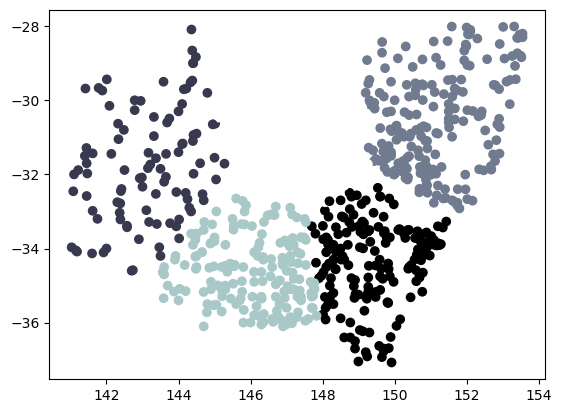

In [119]:
plt.scatter(df['Longitude '],df['Latitude '],c=df['y'])

C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(


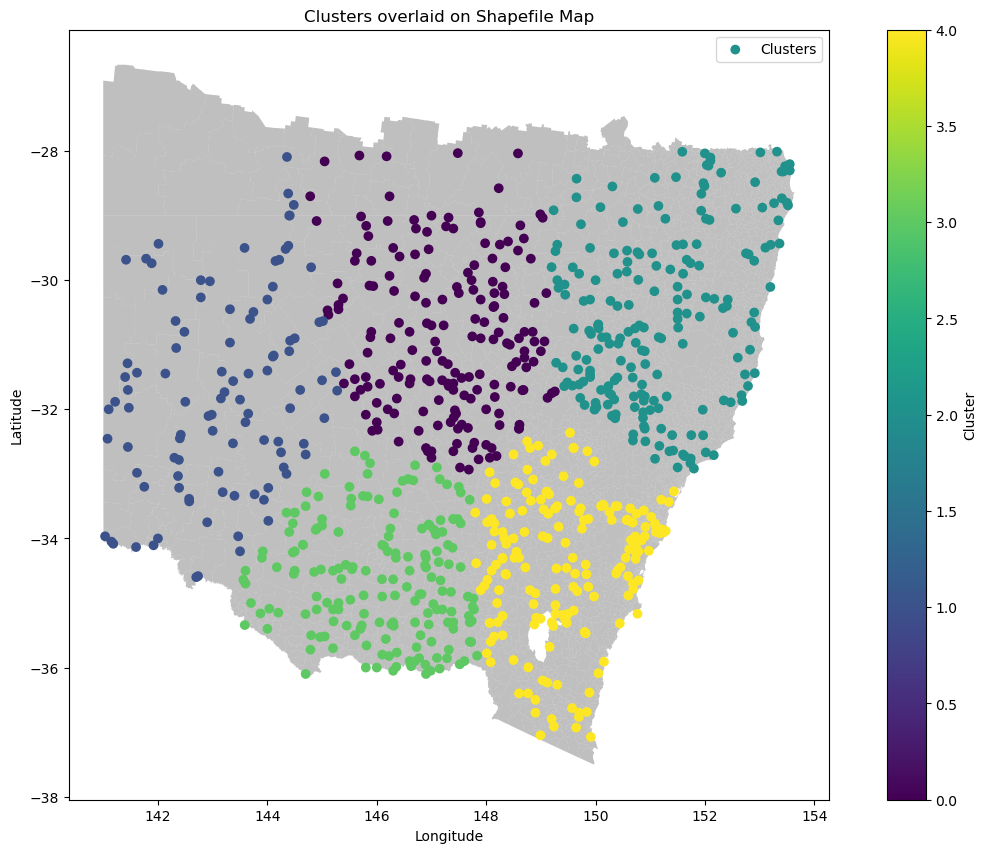

In [120]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Load your CSV data
df = pd.read_csv(r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Station_list_names.csv')

# Extract coordinates
x = df[['Latitude ', 'Longitude ']]

# Perform clustering
model = KMeans(n_clusters=5)
y_means = model.fit_predict(x)
df['Cluster'] = y_means

# Load the shapefile
combined_shapefile = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\combined_shapefile.shp'
combined_gdf = gpd.read_file(combined_shapefile)

# Plotting
fig, ax = plt.subplots(figsize=(15, 10))
fig.patch.set_facecolor('white')
ax.set_facecolor('white')

# Plot the shapefile
combined_gdf.plot(ax=ax, color='gray', alpha=0.5, edgecolor='none')

# Plot the clustered points
scatter = ax.scatter(df['Longitude '], df['Latitude '], c=df['Cluster'], cmap='viridis', label='Clusters')
plt.colorbar(scatter, ax=ax, label='Cluster')

plt.title('Clusters overlaid on Shapefile Map')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend()
plt.show()


In [123]:
# Path to your Excel file
excel_file = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\R1_99_New Events.xlsx'

# Load the Excel file
df2 = pd.read_excel(excel_file)

df2

,Event,Station Number,Date,Rainfall
0,Event 1 - 1889-07-14 to 1889-07-20,NaN,NaN,NaN
1,NaN,Station Number: 58142,Date: 1889-07-17,Rainfall: 156.7
2,NaN,Station Number: 58013,Date: 1889-07-18,Rainfall: 156.7
3,NaN,Station Number: 58018,Date: 1889-07-18,Rainfall: 95.3
4,NaN,Station Number: 58085,Date: 1889-07-18,Rainfall: 114.6
...,...,...,...,...
19497,NaN,Station Number: 74186,Date: 1886-09-03,Rainfall: 31.2
19498,Event 1099 - 1897-06-29 to 1897-07-05,NaN,NaN,NaN
19499,NaN,Station Number: 75020,Date: 1897-07-02,Rainfall: 51.8
19500,Event 1100 - 1884-03-07 to 1884-03-13,NaN,NaN,NaN


In [3]:
from sklearn import cluster

In [6]:
df=pd.read_csv(r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 5 - 1891-01-11 to 1891-01-17.csv')
df.head()

,Station Number,Station Name,Latitude,Longitude,Rainfall 1891-01-11,Rainfall 1891-01-12,Rainfall 1891-01-13,Rainfall 1891-01-14,Rainfall 1891-01-15,Rainfall 1891-01-16,Rainfall 1891-01-17
0,58142,BILAMBIL,-28.2333,153.4667,14.7,0.0,10.2,132.1,147.8,43.7,0.0
1,68137,BROGERS CREEK UPPER (COOKVILLE),-34.7000,150.6833,21.6,0.5,0.0,4.1,5.3,0.0,69.3
2,68054,ROBERTSON (CAALONG STREET),-34.5845,150.5926,19.1,1.3,0.0,0.5,0.3,1.3,88.9
3,58056,TWEED HEADS GOLF CLUB,-28.2025,153.5502,6.4,7.1,9.4,16.0,133.9,53.1,6.9
4,58017,CUDGEN PLANTATION,-28.3000,153.5500,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [12]:
x=df.iloc[:,2:4].values
print(x.shape)

(837, 2)


In [14]:
from sklearn.neighbors import NearestNeighbors
neighbors = NearestNeighbors(n_neighbors=4)
neighbors_fit = neighbors.fit(x)
distances, indices = neighbors_fit.kneighbors(x)

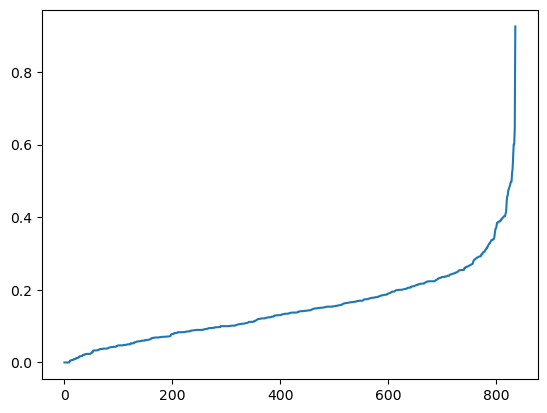

In [17]:
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

In [41]:
!pip install kneed

In [58]:
eps=0.7000
min_samples=7
dbscan = cluster.DBSCAN(eps=eps, min_samples=min_samples)
clustering_labels = dbscan.fit_predict(x)

In [59]:
df['labels'] = clustering_labels

In [60]:
from sklearn import metrics
metrics.silhouette_score(x, df['labels'])

0.2950237726371929

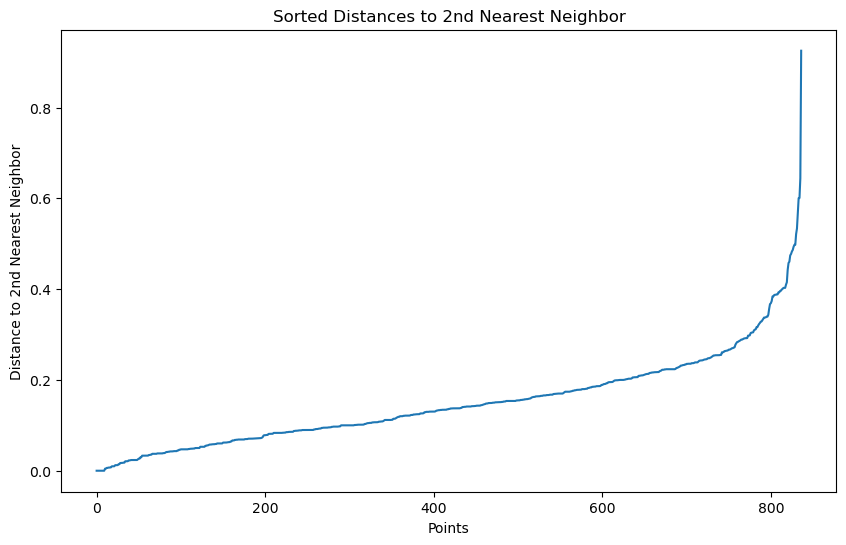

In [61]:
# Plot the sorted distances
plt.figure(figsize=(10, 6))
plt.plot(distances)
plt.xlabel('Points')
plt.ylabel('Distance to 2nd Nearest Neighbor')
plt.title('Sorted Distances to 2nd Nearest Neighbor')
plt.show()

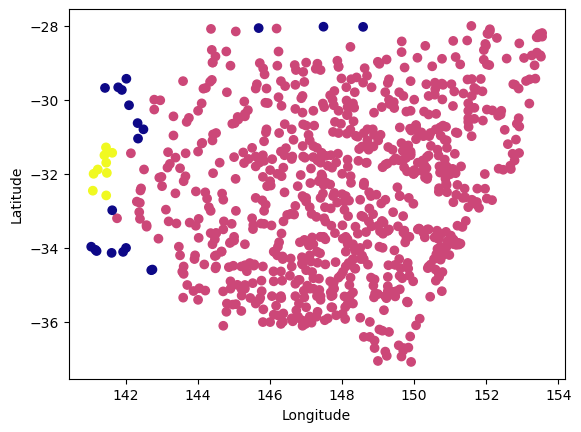

In [68]:
from sklearn.cluster import DBSCAN
# cluster the data into five clusters
dbscan = DBSCAN(eps = 0.700, min_samples = 7).fit(x) # fitting the model
labels = dbscan.labels_ # getting the labels

plt.scatter(x[:, 1], x[:,0], c = labels, cmap= "plasma") # plotting the clusters
plt.xlabel("Longitude") # X-axis label
plt.ylabel("Latitude") # Y-axis label
plt.show() # showing the plot
    


In [75]:
df=pd.read_csv(r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 5 - 1891-01-11 to 1891-01-17.csv')
df.head()

df_drop=df.drop(columns=['Station Number','Station Name'])
# Drop rows with NaN values
df_cleaned = df_drop.dropna()

# Display the first few rows of the cleaned DataFrame
print("\nDataFrame after dropping NaN values:")
df_cleaned.head()


DataFrame after dropping NaN values:


,Latitude,Longitude,Rainfall 1891-01-11,Rainfall 1891-01-12,Rainfall 1891-01-13,Rainfall 1891-01-14,Rainfall 1891-01-15,Rainfall 1891-01-16,Rainfall 1891-01-17
0,-28.2333,153.4667,14.7,0.0,10.2,132.1,147.8,43.7,0.0
1,-34.7000,150.6833,21.6,0.5,0.0,4.1,5.3,0.0,69.3
2,-34.5845,150.5926,19.1,1.3,0.0,0.5,0.3,1.3,88.9
3,-28.2025,153.5502,6.4,7.1,9.4,16.0,133.9,53.1,6.9
5,-30.5000,152.9000,31.8,71.9,0.0,45.2,25.9,53.3,58.4


In [76]:
print(df_cleaned.shape)

(750, 9)


In [85]:
df_orig=df_cleaned.copy()

# Columns to scale
columns_to_scale = df_orig.columns.difference(['Latitude', 'Longitude'])

from sklearn.preprocessing import StandardScaler
# Scaling the data
scaler = StandardScaler()

df_sc=df_orig.copy()

df_sc[columns_to_scale]=pd.DataFrame(scaler.fit_transform(df_orig[columns_to_scale]))

display("original",df_orig.head(5),"scaled",df_sc.head(5))
                        

'original'

,Latitude,Longitude,Rainfall 1891-01-11,Rainfall 1891-01-12,Rainfall 1891-01-13,Rainfall 1891-01-14,Rainfall 1891-01-15,Rainfall 1891-01-16,Rainfall 1891-01-17
0,-28.2333,153.4667,14.7,0.0,10.2,132.1,147.8,43.7,0.0
1,-34.7000,150.6833,21.6,0.5,0.0,4.1,5.3,0.0,69.3
2,-34.5845,150.5926,19.1,1.3,0.0,0.5,0.3,1.3,88.9
3,-28.2025,153.5502,6.4,7.1,9.4,16.0,133.9,53.1,6.9
5,-30.5000,152.9000,31.8,71.9,0.0,45.2,25.9,53.3,58.4


'scaled'

,Latitude,Longitude,Rainfall 1891-01-11,Rainfall 1891-01-12,Rainfall 1891-01-13,Rainfall 1891-01-14,Rainfall 1891-01-15,Rainfall 1891-01-16,Rainfall 1891-01-17
0,-28.2333,153.4667,0.280168,-0.297962,0.696841,8.270328,7.171743,0.714138,-1.176016
1,-34.7000,150.6833,0.691947,-0.244035,-0.412294,-0.225157,-0.125891,-0.705897,0.901748
2,-34.5845,150.5926,0.542752,-0.157753,-0.412294,-0.464092,-0.381949,-0.663653,1.489398
3,-28.2025,153.5502,-0.215159,0.467794,0.609850,0.564658,6.459904,1.019592,-0.969140
5,-30.5000,152.9000,1.252920,0.165806,1.294904,5.350005,6.951534,1.373788,-1.101061


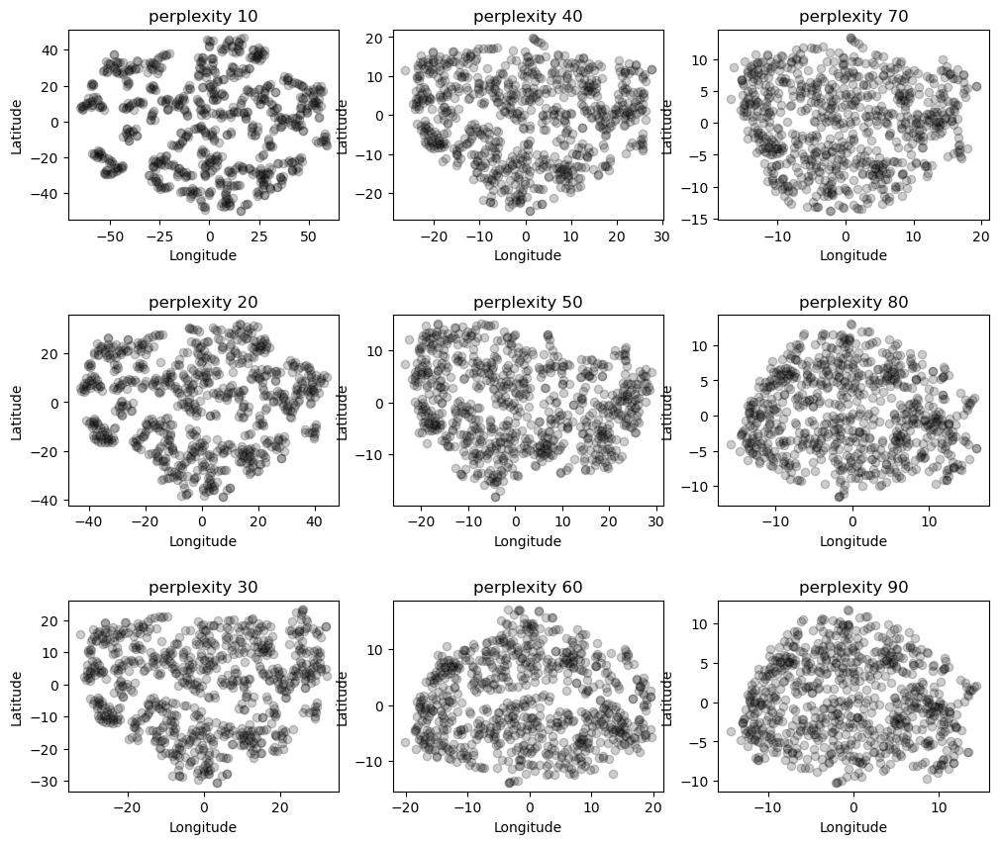

In [92]:
import math
from sklearn.manifold import TSNE
plot_x=df_sc.copy()

plot_x_cleaned = plot_x.dropna()
plot_x_cleaned = plot_x.fillna(0)  # or plot_x.fillna(plot_x.mean())

ps=[10,20,30,40,50,60,70,80,90]

fig,ax=plt.subplots(3,3,figsize=(12,10))
plt.subplots_adjust(hspace=.5)

for i,perplexity in enumerate(ps):
    tsne=TSNE(n_components=2,perplexity=perplexity)
    tsneComponents=tsne.fit_transform(plot_x_cleaned)
    TSNE_components=pd.DataFrame(tsneComponents)
    ax[i%3][math.floor(i/3)].set_title(f'perplexity {perplexity}')
    ax[i%3][math.floor(i/3)].scatter(TSNE_components[0],TSNE_components[1],alpha=.2,color='black')
    ax[i%3][math.floor(i/3)].set(xlabel='Longitude')
    ax[i%3][math.floor(i/3)].set(ylabel='Latitude')
    

In [97]:
!pip install product

  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for product: filename=product-0.1.1.1-py3-none-any.whl size=1182 sha256=d9b191c54017b97558f2f088a76862a52f7961f4bb3ebe18994595386aca1fc1
  Stored in directory: c:\users\ruchitsandip\appdata\local\pip\cache\wheels\24\ed\00\f5da5323fb0dc8ff9cb40279f9b231ed307270b26b5acdd3cd
Successfully built product


KeyError: 0

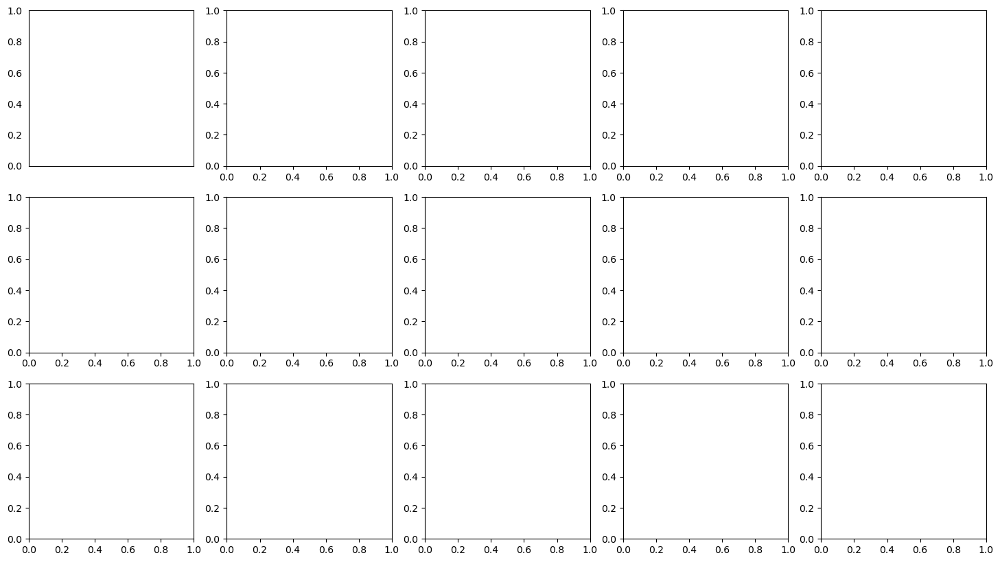

In [100]:
import math
from itertools import product
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN
import pandas as pd

samp_list = [2, 3, 4]
eps_list = [0.8, 1.0, 1.25, 1.5, 1.75]
rows = len(samp_list)

fig, ax = plt.subplots(len(samp_list), len(eps_list), figsize=(18, 10))

for k, (eps, samp) in enumerate(product(eps_list, samp_list)):
    ax[k % rows][math.floor(k / rows)].tick_params(axis='both', which='both', bottom=False, top=False, left=False, labelbottom=False)
    TSNE_df = TSNE_components.copy()
    clustering = DBSCAN(eps=eps, min_samples=samp).fit(TSNE_df)
    TSNE_df.insert(0, 'cluster', clustering.labels_)
    datas = [[TSNE_df[TSNE_df['cluster'] == i][j] for j in range(2)] for i in range(len(set(clustering.labels_)))]
    colors = ('green', 'red', 'blue', 'orange', 'yellow', 'purple')
    groups = [str(i) for i in range(len(set(clustering.labels_)))]
    for data, color, group in zip(datas, colors, groups):
        ax[k % rows][math.floor(k / rows)].scatter(data[0], data[1], alpha=0.5, c=color, edgecolors='none', s=100, label=group)
        ax[k % rows][math.floor(k / rows)].set_title(f'DBS eps: {eps}, samp: {samp}')

plt.tight_layout()
plt.show()


#SELF ORGANISING MAP

In [51]:
df=pd.read_csv(r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 5 - 1891-01-11 to 1891-01-17.csv')
df.head()

x=df[['Latitude','Longitude','Rainfall 1891-01-17']]
x.head()

x_cleaned=x.dropna()

# Remove rows where rainfall is 0 mm
x_cleaned = x_cleaned[x_cleaned['Rainfall 1891-01-17'] > 0]

# Add the 'Target' column
def assign_target(rainfall):
    if rainfall >= 10:
        return 2
    elif rainfall >= 5:
        return 1
    elif rainfall > 0:
        return 0
    else:
        return -1  # This is to handle cases with 0mm rainfall if any

x_cleaned['Target'] = x_cleaned['Rainfall 1891-01-17'].apply(assign_target)

# Display the first 10 rows of the cleaned data with the new column
x_cleaned.head(10)



,Latitude,Longitude,Rainfall 1891-01-17,Target
1,-34.7000,150.6833,69.3,2
2,-34.5845,150.5926,88.9,2
3,-28.2025,153.5502,6.9,1
5,-30.5000,152.9000,58.4,2
6,-28.3167,153.4333,2.5,0
7,-28.3167,153.4000,35.6,2
8,-30.7241,152.9168,6.4,1
9,-30.6500,152.8486,55.9,2
10,-34.6500,150.7833,43.7,2
11,-34.1908,150.9746,64.8,2


In [52]:
t = x_cleaned['Target'].values
x_cleaned = x_cleaned[x_cleaned.columns[:-1]]

# Normalize only the "Rainfall" column
mean_rainfall = np.mean(x_cleaned['Rainfall 1891-01-17'])
std_rainfall = np.std(x_cleaned['Rainfall 1891-01-17'])
x_cleaned['Rainfall 1891-01-17'] = (x_cleaned['Rainfall 1891-01-17'] - mean_rainfall) / std_rainfall

# If you want to convert the DataFrame to a NumPy array
x_cleaned_values = x_cleaned.values

print(x_cleaned_values)

# initialization and training of 15x15 SOM
som = MiniSom(15, 15, x_cleaned_values.shape[1], sigma=1.5, learning_rate=.7, activation_distance='euclidean',
              topology='hexagonal', neighborhood_function='gaussian', random_seed=10)

som.train(x_cleaned_values, 1000, verbose=True)

[[-34.7        150.6833       0.77578428]
 [-34.5845     150.5926       1.38483431]
 [-28.2025     153.5502      -1.16323217]
 ...
 [-34.9667     146.7          1.30714936]
 [-34.05       141.15        -1.33103167]
 [-33.9667     141.0333      -1.32170947]]
 [ 1000 / 1000 ] 100% - 0:00:00 left 
 quantization error: 0.585510952104236


In [53]:
xx, yy = som.get_euclidean_coordinates()
umatrix = som.distance_map()
weights = som.get_weights()

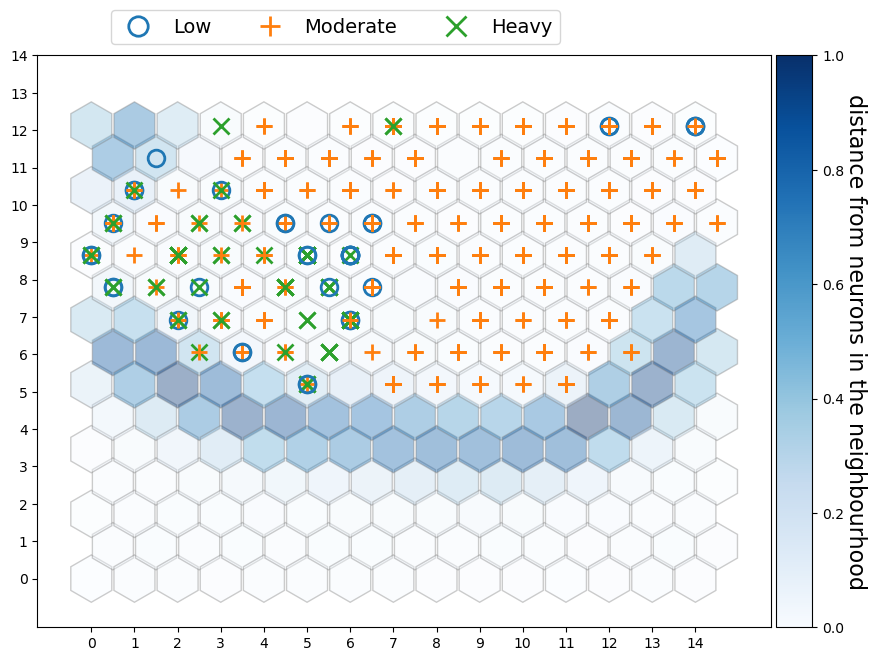

In [54]:
f = plt.figure(figsize=(10,10))
ax = f.add_subplot(111)

ax.set_aspect('equal')

# iteratively add hexagons
for i in range(weights.shape[0]):
    for j in range(weights.shape[1]):
        wy = yy[(i, j)] * np.sqrt(3) / 2
        hex = RegularPolygon((xx[(i, j)], wy), 
                             numVertices=6, 
                             radius=.95 / np.sqrt(3),
                             facecolor=cm.Blues(umatrix[i, j]), 
                             alpha=.4, 
                             edgecolor='gray')
        ax.add_patch(hex)

markers = ['o', '+', 'x']
colors = ['C0', 'C1', 'C2']
for cnt, x in enumerate(x_cleaned_values):
    # getting the winner
    w = som.winner(x)
    # place a marker on the winning position for the sample xx
    wx, wy = som.convert_map_to_euclidean(w) 
    wy = wy * np.sqrt(3) / 2
    plt.plot(wx, wy, 
             markers[t[cnt]-1], 
             markerfacecolor='None',
             markeredgecolor=colors[t[cnt]-1], 
             markersize=12, 
             markeredgewidth=2)

xrange = np.arange(weights.shape[0])
yrange = np.arange(weights.shape[1])
plt.xticks(xrange-.5, xrange)
plt.yticks(yrange * np.sqrt(3) / 2, yrange)

divider = make_axes_locatable(plt.gca())
ax_cb = divider.new_horizontal(size="5%", pad=0.05)    
cb1 = colorbar.ColorbarBase(ax_cb, cmap=cm.Blues, 
                            orientation='vertical', alpha=.4)
cb1.ax.get_yaxis().labelpad = 16
cb1.ax.set_ylabel('distance from neurons in the neighbourhood',
                  rotation=270, fontsize=16)
plt.gcf().add_axes(ax_cb)

legend_elements = [Line2D([0], [0], marker='o', color='C0', label='Low',
                   markerfacecolor='w', markersize=14, linestyle='None', markeredgewidth=2),
                   Line2D([0], [0], marker='+', color='C1', label='Moderate',
                   markerfacecolor='w', markersize=14, linestyle='None', markeredgewidth=2),
                   Line2D([0], [0], marker='x', color='C2', label='Heavy',
                   markerfacecolor='w', markersize=14, linestyle='None', markeredgewidth=2)]
ax.legend(handles=legend_elements, bbox_to_anchor=(0.1, 1.08), loc='upper left', 
          borderaxespad=0., ncol=3, fontsize=14)


plt.show()

C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\RUCHITSANDIP\AppData\Local\Temp\ipykernel_14456\2150269123.py:14: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
  contour = sns.kdeplot(
C:\Users\RUCHITSANDIP\AppData\Local\Temp\ipykernel_14456\2150269123.py:14: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
 

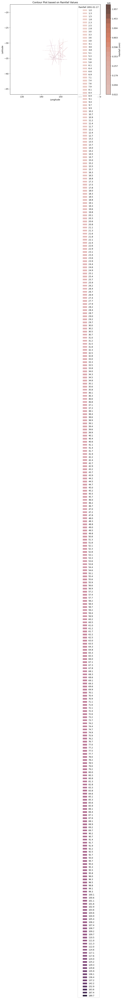

In [96]:
df=pd.read_csv(r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 5 - 1891-01-11 to 1891-01-17.csv')
df.head()

x=df[['Latitude','Longitude','Rainfall 1891-01-17']]
x.head()

x_cleaned=x.dropna()

# Remove rows where rainfall is 0 mm
x_cleaned = x_cleaned[x_cleaned['Rainfall 1891-01-17'] >=1]

# Plot contour based on latitude, longitude, and rainfall
plt.figure(figsize=(10, 8))
contour = sns.kdeplot(
    data=x_cleaned,
    x='Longitude',
    y='Latitude',
    hue='Rainfall 1891-01-17',  # Use Rainfall values for color coding
    fill=True,     # Fill the contour
    cmap='viridis',# Color map
    levels=20,      # Number of contour levels
    thresh=0.05,   # Threshold for contour lines
    linewidths=1   # Line width for contour lines
)
plt.title('Contour Plot based on Rainfall Values')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Add colorbar
cbar = plt.colorbar(contour.collections[0], label='Rainfall (mm)')
cbar.set_label('Rainfall (mm)')
plt.show()


In [105]:
df=pd.read_csv(r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 5 - 1891-01-11 to 1891-01-17.csv')
df.head()

x=df[['Latitude','Longitude','Rainfall 1891-01-17']]
x.head()

x_cleaned=x.dropna()

# Remove rows where rainfall is 0 mm
x_cleaned = x_cleaned[x_cleaned['Rainfall 1891-01-17'] >=1]

# Add the 'Target' column
def assign_target(rainfall):
    if rainfall >=25:
        return 2
    elif rainfall >= 15:
        return 1
    elif rainfall >=1:
        return 0
    else:
        return -1  # This is to handle cases with 0mm rainfall if any

x_cleaned['Target'] = x_cleaned['Rainfall 1891-01-17'].apply(assign_target)

x_cleaned.head(10)
x_cleaned.shape

(654, 4)

C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\seaborn\distributions.py:1138: UserWarning: cmap parameter ignored when using hue mapping.
  warnings.warn(msg, UserWarning)
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\seaborn\distributions.py:1185: UserWarning: linewidths is ignored by contourf
  cset = contour_func(


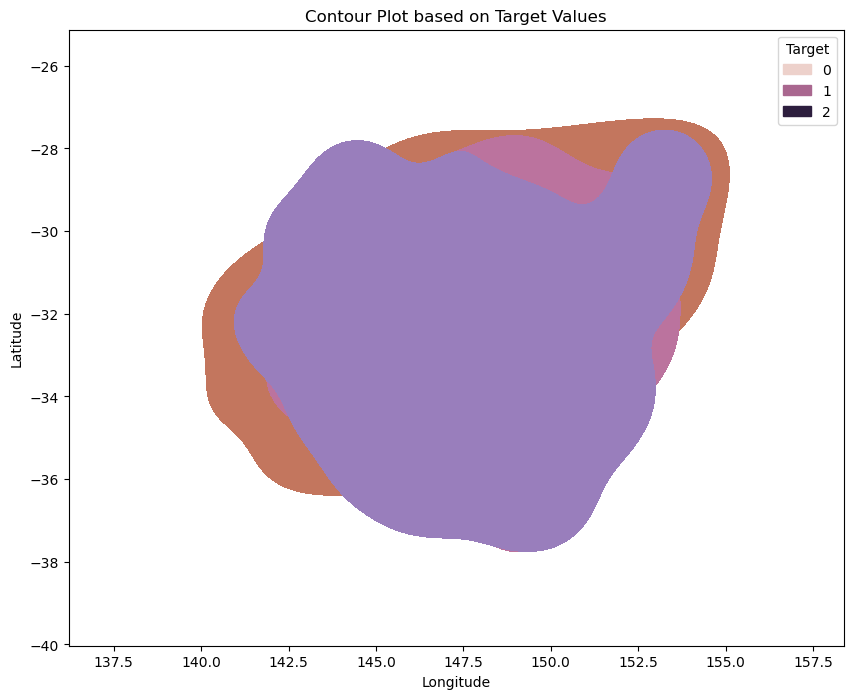

In [109]:
# Plot contour based on latitude, longitude, and Target
plt.figure(figsize=(10, 8))
sns.kdeplot(
    data=x_cleaned, 
    x='Longitude', 
    y='Latitude', 
    hue='Target',  # Use Target column for color coding
    fill=True,     # Fill the contour
    cmap='viridis',# Color map
    levels=2,      # Number of contour levels
    thresh=0.05,   # Threshold for contour lines
    linewidths=1   # Line width for contour lines
)
plt.title('Contour Plot based on Target Values')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\seaborn\distributions.py:1138: UserWarning: cmap parameter ignored when using hue mapping.
  warnings.warn(msg, UserWarning)
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\seaborn\distributions.py:1185: UserWarning: linewidths is ignored by contourf
  cset = contour_func(


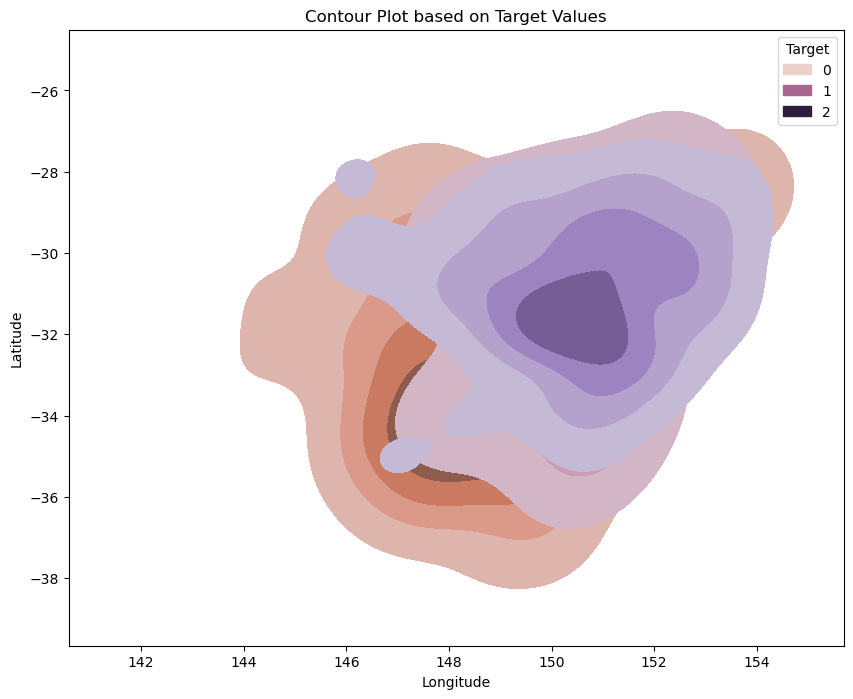

In [97]:
df=pd.read_csv(r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 5 - 1891-01-11 to 1891-01-17.csv')
df.head()

x=df[['Latitude','Longitude','Rainfall 1891-01-11']]
x.head()

x_cleaned=x.dropna()

# Remove rows where rainfall is 0 mm
x_cleaned = x_cleaned[x_cleaned['Rainfall 1891-01-11'] >=1]

# Add the 'Target' column
def assign_target(rainfall):
    if rainfall >=25:
        return 2
    elif rainfall >= 15:
        return 1
    elif rainfall >=1:
        return 0
    else:
        return -1  # This is to handle cases with 0mm rainfall if any

x_cleaned['Target'] = x_cleaned['Rainfall 1891-01-11'].apply(assign_target)

x_cleaned.head(10)
x_cleaned.shape

# Plot contour based on latitude, longitude, and Target
plt.figure(figsize=(10, 8))
sns.kdeplot(
    data=x_cleaned, 
    x='Longitude', 
    y='Latitude', 
    hue='Target',  # Use Target column for color coding
    fill=True,     # Fill the contour
    cmap='viridis',# Color map
    levels=5,      # Number of contour levels
    thresh=0.05,   # Threshold for contour lines
    linewidths=1   # Line width for contour lines
)
plt.title('Contour Plot based on Target Values')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

In [76]:
# Standardize the rainfall values
scaler = StandardScaler()
x_cleaned[['Rainfall 1891-01-17','Target']] = scaler.fit_transform(x_cleaned[['Rainfall 1891-01-17','Target']])

x_cleaned.head(10)


,Latitude,Longitude,Rainfall 1891-01-17,Target
1,-34.7000,150.6833,0.753883,0.636388
2,-34.5845,150.5926,1.368845,0.636388
3,-28.2025,153.5502,-1.203955,-1.948693
5,-30.5000,152.9000,0.411889,0.636388
6,-28.3167,153.4333,-1.342008,-1.948693
7,-28.3167,153.4000,-0.303475,0.636388
8,-30.7241,152.9168,-1.219643,-1.948693
9,-30.6500,152.8486,0.333450,0.636388
10,-34.6500,150.7833,-0.049333,0.636388
11,-34.1908,150.9746,0.612693,0.636388


C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(


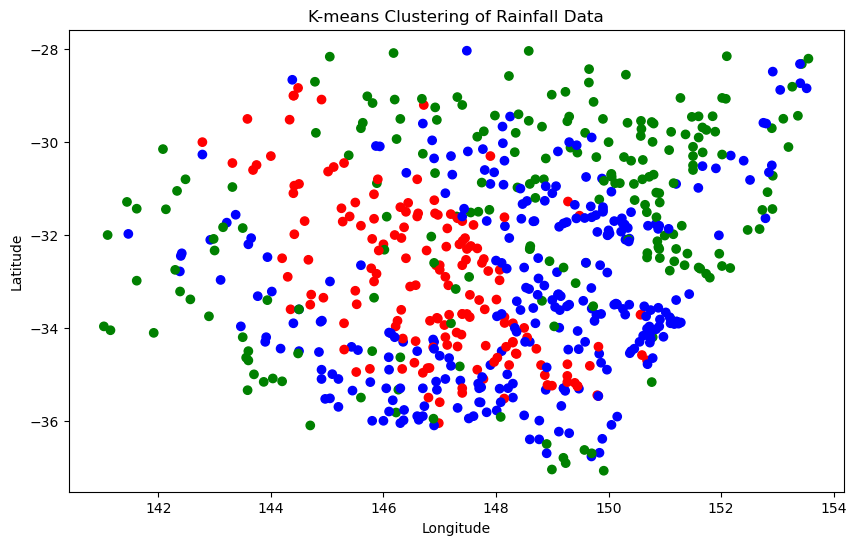

In [77]:
# Perform K-means clustering
kmeans = KMeans(n_clusters=3)  # You can change the number of clusters
x_cleaned['Cluster'] = kmeans.fit_predict(x_cleaned[['Rainfall 1891-01-17','Target']])

x_cleaned.head(10)

# Scatter plot
colors = {0: 'green', 1: 'blue', 2: 'red'}
plt.figure(figsize=(10, 6))
plt.scatter(x_cleaned['Longitude'], x_cleaned['Latitude'], c=x_cleaned['Cluster'].map(colors))
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('K-means Clustering of Rainfall Data')
plt.show()


C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when the

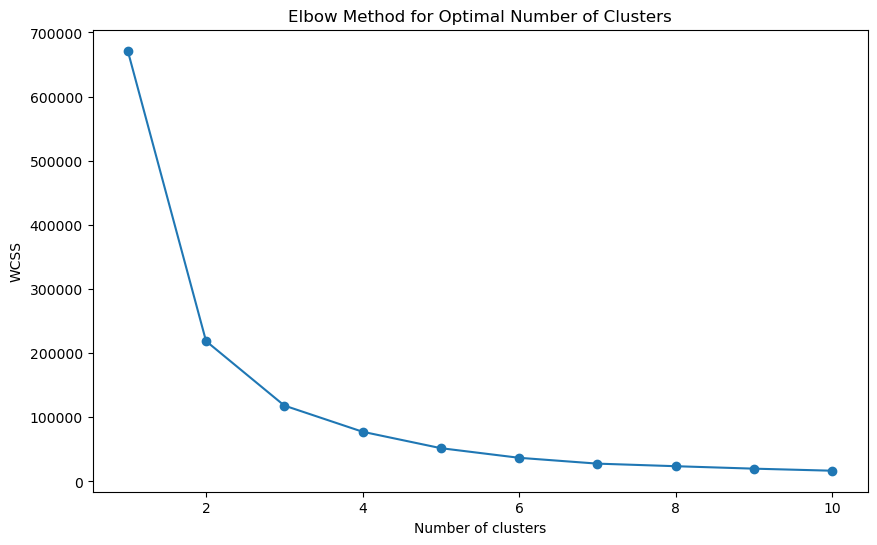

C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when the

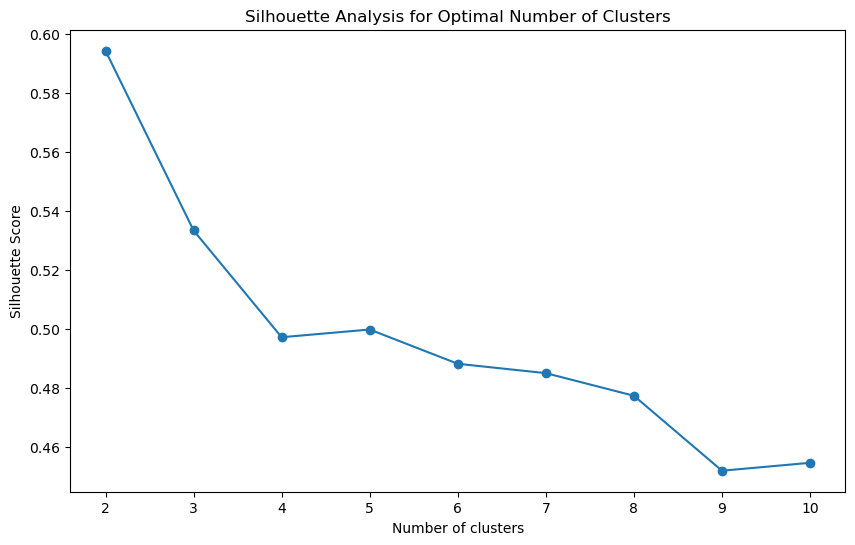

In [112]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# Assuming x_cleaned is your DataFrame with the necessary columns
data = x_cleaned[['Latitude','Longitude','Rainfall 1891-01-17']]

# Elbow method to determine the optimal number of clusters
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, random_state=42)
    kmeans.fit(data)
    wcss.append(kmeans.inertia_)

plt.figure(figsize=(10, 6))
plt.plot(range(1, 11), wcss, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.title('Elbow Method for Optimal Number of Clusters')
plt.show()

# Silhouette method to determine the optimal number of clusters
silhouette_scores = []
for i in range(2, 11):
    kmeans = KMeans(n_clusters=i, random_state=42)
    cluster_labels = kmeans.fit_predict(data)
    silhouette_avg = silhouette_score(data, cluster_labels)
    silhouette_scores.append(silhouette_avg)

plt.figure(figsize=(10, 6))
plt.plot(range(2, 11), silhouette_scores, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Analysis for Optimal Number of Clusters')
plt.show()


C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(


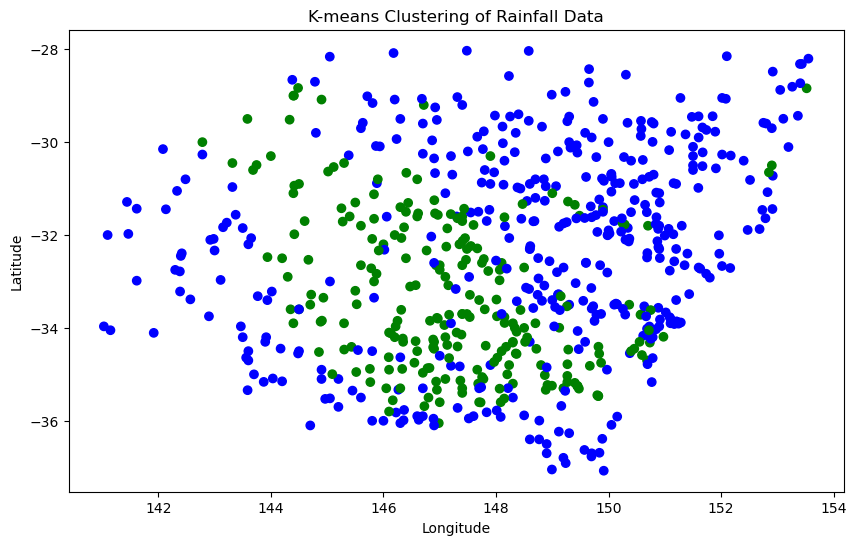

In [111]:
# Perform K-means clustering
kmeans = KMeans(n_clusters=2)  # You can change the number of clusters
x_cleaned['Cluster'] = kmeans.fit_predict(x_cleaned[['Rainfall 1891-01-17']])

# Scatter plot
colors = {0: 'green', 1: 'blue', 2: 'red'}
plt.figure(figsize=(10, 6))
plt.scatter(x_cleaned['Longitude'], x_cleaned['Latitude'], c=x_cleaned['Cluster'].map(colors))
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('K-means Clustering of Rainfall Data')
plt.show()

C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(


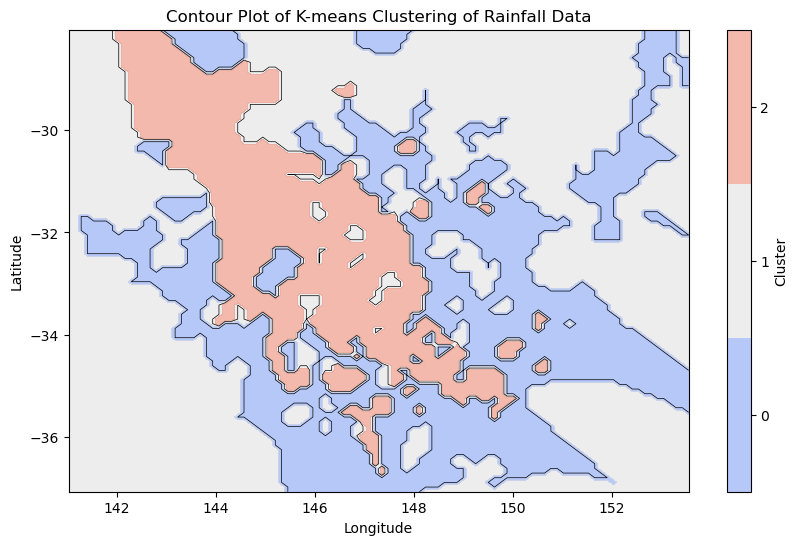

In [82]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from scipy.interpolate import griddata

# Load the data
df = pd.read_csv(r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 5 - 1891-01-11 to 1891-01-17.csv')

# Select relevant columns
x = df[['Latitude', 'Longitude', 'Rainfall 1891-01-17']]
x_cleaned = x.dropna()
x_cleaned = x_cleaned[x_cleaned['Rainfall 1891-01-17'] >= 1]

# Add the 'Target' column
def assign_target(rainfall):
    if rainfall >= 25:
        return 2
    elif rainfall >= 15:
        return 1
    elif rainfall >= 1:
        return 0
    else:
        return -1

x_cleaned['Target'] = x_cleaned['Rainfall 1891-01-17'].apply(assign_target)

# Standardize the rainfall values
scaler = StandardScaler()
x_cleaned[['Rainfall 1891-01-17', 'Target']] = scaler.fit_transform(x_cleaned[['Rainfall 1891-01-17', 'Target']])

# Perform K-means clustering
kmeans = KMeans(n_clusters=3)
x_cleaned['Cluster'] = kmeans.fit_predict(x_cleaned[['Rainfall 1891-01-17', 'Target']])

# Create a grid for contour plot
grid_x, grid_y = np.mgrid[x_cleaned['Longitude'].min():x_cleaned['Longitude'].max():100j, 
                          x_cleaned['Latitude'].min():x_cleaned['Latitude'].max():100j]

# Interpolate the cluster values onto the grid
grid_cluster = griddata((x_cleaned['Longitude'], x_cleaned['Latitude']), x_cleaned['Cluster'], (grid_x, grid_y), method='nearest')

# Plot the contour plot
plt.figure(figsize=(10, 6))
contour = plt.contourf(grid_x, grid_y, grid_cluster, levels=[-0.5, 0.5, 1.5, 2.5], cmap='coolwarm', alpha=0.5)
plt.contour(grid_x, grid_y, grid_cluster, levels=[0, 1, 2], colors='black', linewidths=0.5)
plt.colorbar(contour, ticks=[0, 1, 2], label='Cluster')

plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Contour Plot of K-means Clustering of Rainfall Data')
plt.show()


C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(


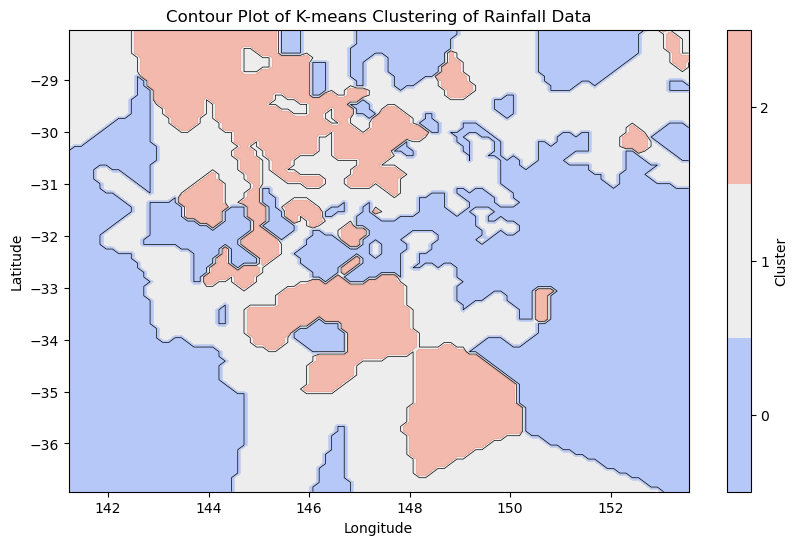

In [83]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from scipy.interpolate import griddata

# Load the data
df = pd.read_csv(r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 5 - 1891-01-11 to 1891-01-17.csv')

# Select relevant columns
x = df[['Latitude', 'Longitude', 'Rainfall 1891-01-16']]
x_cleaned = x.dropna()
x_cleaned = x_cleaned[x_cleaned['Rainfall 1891-01-16'] >= 1]

# Add the 'Target' column
def assign_target(rainfall):
    if rainfall >= 25:
        return 2
    elif rainfall >= 15:
        return 1
    elif rainfall >= 1:
        return 0
    else:
        return -1

x_cleaned['Target'] = x_cleaned['Rainfall 1891-01-16'].apply(assign_target)

# Standardize the rainfall values
scaler = StandardScaler()
x_cleaned[['Rainfall 1891-01-16', 'Target']] = scaler.fit_transform(x_cleaned[['Rainfall 1891-01-16', 'Target']])

# Perform K-means clustering
kmeans = KMeans(n_clusters=3)
x_cleaned['Cluster'] = kmeans.fit_predict(x_cleaned[['Rainfall 1891-01-16', 'Target']])

# Create a grid for contour plot
grid_x, grid_y = np.mgrid[x_cleaned['Longitude'].min():x_cleaned['Longitude'].max():100j, 
                          x_cleaned['Latitude'].min():x_cleaned['Latitude'].max():100j]

# Interpolate the cluster values onto the grid
grid_cluster = griddata((x_cleaned['Longitude'], x_cleaned['Latitude']), x_cleaned['Cluster'], (grid_x, grid_y), method='nearest')

# Plot the contour plot
plt.figure(figsize=(10, 6))
contour = plt.contourf(grid_x, grid_y, grid_cluster, levels=[-0.5, 0.5, 1.5, 2.5], cmap='coolwarm', alpha=0.5)
plt.contour(grid_x, grid_y, grid_cluster, levels=[0, 1, 2], colors='black', linewidths=0.5)
plt.colorbar(contour, ticks=[0, 1, 2], label='Cluster')

plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Contour Plot of K-means Clustering of Rainfall Data')
plt.show()


C:\Users\RUCHITSANDIP\AppData\Local\Temp\ipykernel_14456\1756118638.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('viridis', len(unique_clusters))
C:\Users\RUCHITSANDIP\AppData\Local\Temp\ipykernel_14456\1756118638.py:8: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(cluster_data['Longitude'], cluster_data['Latitude'], label=f'Cluster {cluster}', cmap=colors(cluster))


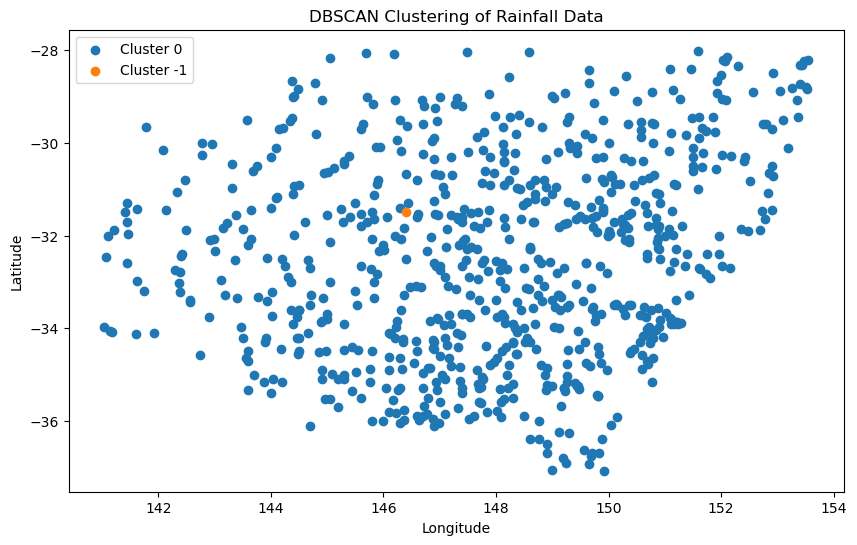

In [39]:
# Scatter plot
unique_clusters = x_cleaned['Cluster'].unique()
colors = plt.cm.get_cmap('viridis', len(unique_clusters))

plt.figure(figsize=(10, 6))
for cluster in unique_clusters:
    cluster_data = x_cleaned[x_cleaned['Cluster'] == cluster]
    plt.scatter(cluster_data['Longitude'], cluster_data['Latitude'], label=f'Cluster {cluster}', cmap=colors(cluster))

plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('DBSCAN Clustering of Rainfall Data')
plt.legend()
plt.show()

##KERNEL DENSTIY ESTIMATION

In [3]:
df=pd.read_csv(r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 5 - 1891-01-11 to 1891-01-17.csv')
df.head()

x=df[['Latitude','Longitude','Rainfall 1891-01-17']]
x.head()

x_cleaned=x.dropna()
x_cleaned.head(10)

,Latitude,Longitude,Rainfall 1891-01-17
0,-28.2333,153.4667,0.0
1,-34.7000,150.6833,69.3
2,-34.5845,150.5926,88.9
3,-28.2025,153.5502,6.9
5,-30.5000,152.9000,58.4
6,-28.3167,153.4333,2.5
7,-28.3167,153.4000,35.6
8,-30.7241,152.9168,6.4
9,-30.6500,152.8486,55.9
10,-34.6500,150.7833,43.7


C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


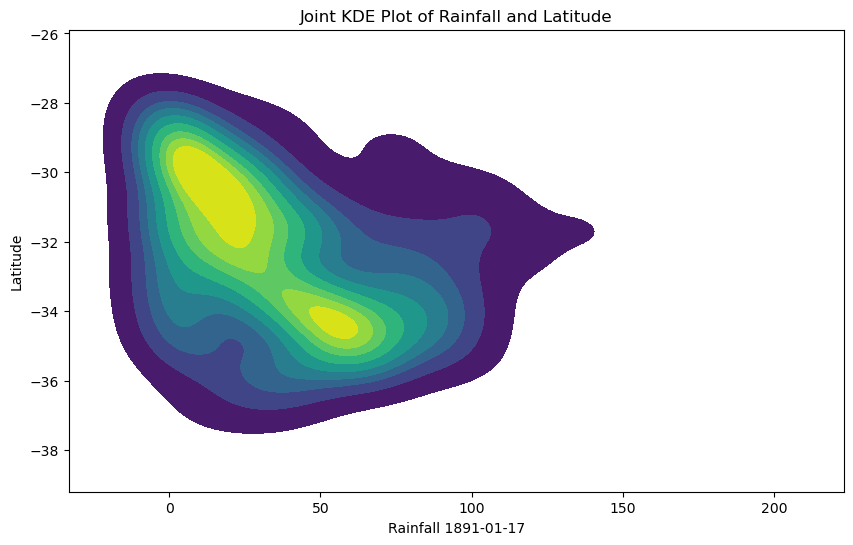

In [4]:
# Joint KDE plot for Rainfall and Latitude
plt.figure(figsize=(10, 6))
sns.kdeplot(
    x=x_cleaned['Rainfall 1891-01-17'], 
    y=x_cleaned['Latitude'], 
    cmap="viridis", 
    fill=True
)
plt.xlabel('Rainfall 1891-01-17')
plt.ylabel('Latitude')
plt.title('Joint KDE Plot of Rainfall and Latitude')
plt.show()


C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated

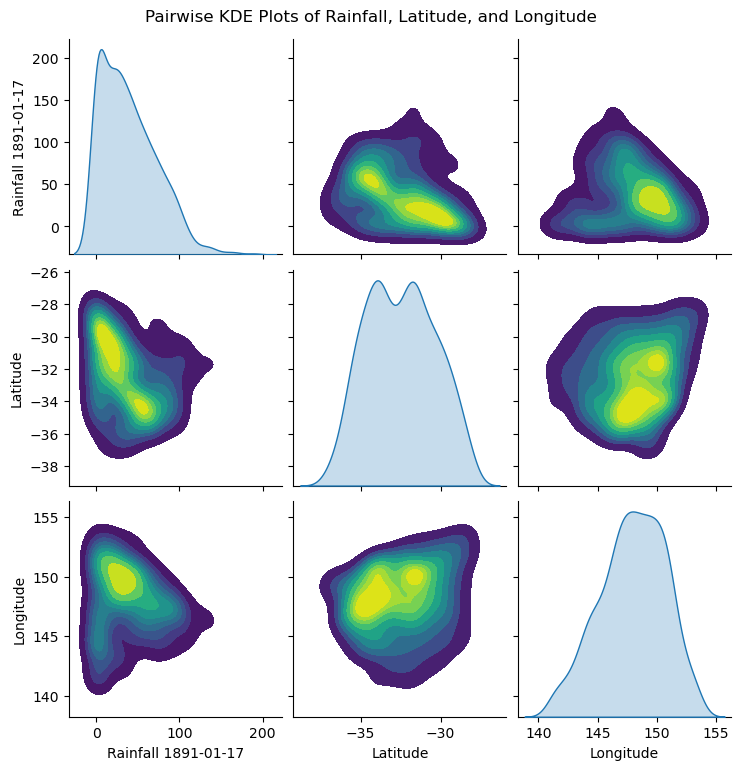

In [5]:
import seaborn as sns

# Pairwise KDE plots for Rainfall, Latitude, and Longitude
sns.pairplot(
    x_cleaned[['Rainfall 1891-01-17', 'Latitude', 'Longitude']], 
    kind='kde',
    plot_kws={'fill': True, 'cmap': 'viridis'}
)
plt.suptitle('Pairwise KDE Plots of Rainfall, Latitude, and Longitude', y=1.02)
plt.show()


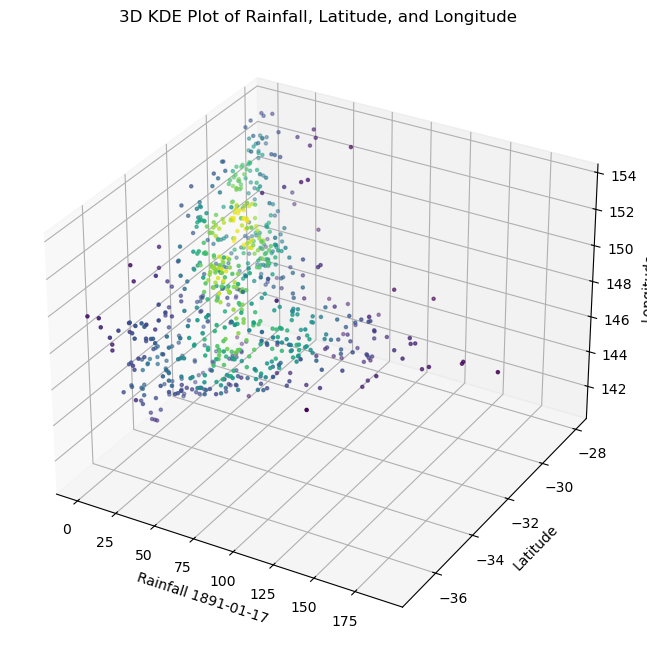

In [6]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.stats import gaussian_kde

# Extract the necessary columns
rainfall = x_cleaned['Rainfall 1891-01-17']
latitude = x_cleaned['Latitude']
longitude = x_cleaned['Longitude']

# Create a grid of points
x = rainfall.values
y = latitude.values
z = longitude.values

# Perform kernel density estimate
xyz = np.vstack([x, y, z])
kde = gaussian_kde(xyz)
density = kde(xyz)

# Plot the 3D KDE
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x, y, z, c=density, cmap='viridis', s=5)
ax.set_xlabel('Rainfall 1891-01-17')
ax.set_ylabel('Latitude')
ax.set_zlabel('Longitude')
ax.set_title('3D KDE Plot of Rainfall, Latitude, and Longitude')
plt.show()


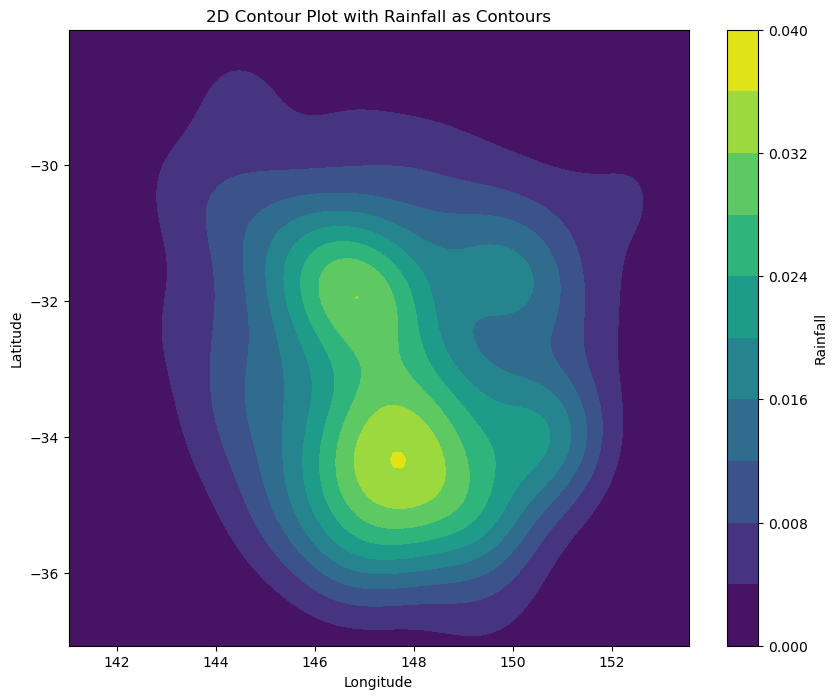

In [7]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

# Extract the necessary columns
rainfall = x_cleaned['Rainfall 1891-01-17']
latitude = x_cleaned['Latitude']
longitude = x_cleaned['Longitude']

# Create a grid of points
x = longitude.values
y = latitude.values
z = rainfall.values

# Perform kernel density estimate
xy = np.vstack([x, y])
kde = gaussian_kde(xy, weights=z, bw_method='scott')
xi, yi = np.meshgrid(np.linspace(x.min(), x.max(), 100), np.linspace(y.min(), y.max(), 100))
zi = kde(np.vstack([xi.ravel(), yi.ravel()]))

# Plot the 2D KDE with rainfall as contours
plt.figure(figsize=(10, 8))
contour = plt.contourf(xi, yi, zi.reshape(xi.shape), levels=10, cmap="viridis")
plt.colorbar(contour, label='Rainfall')

plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('2D Contour Plot with Rainfall as Contours')
plt.show()


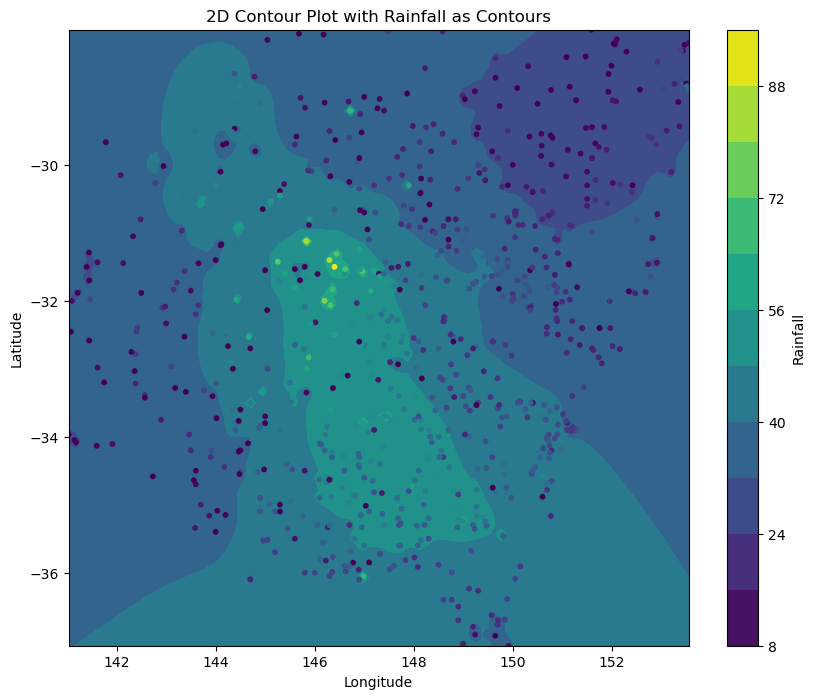

In [8]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

# Extract the necessary columns
rainfall = x_cleaned['Rainfall 1891-01-17']
latitude = x_cleaned['Latitude']
longitude = x_cleaned['Longitude']

# Create a grid of points
x = longitude.values
y = latitude.values
z = rainfall.values

# Create a grid of points
xi, yi = np.meshgrid(np.linspace(x.min(), x.max(), 100), np.linspace(y.min(), y.max(), 100))
zi = np.zeros(xi.shape)

# Interpolate the rainfall data on the grid
for i in range(len(xi)):
    for j in range(len(yi)):
        distances = np.sqrt((x - xi[i, j])**2 + (y - yi[i, j])**2)
        weights = 1 / (distances + 1e-6)
        zi[i, j] = np.sum(weights * z) / np.sum(weights)

# Plot the 2D contour plot with rainfall as contours
plt.figure(figsize=(10, 8))
contour = plt.contourf(xi, yi, zi, levels=10, cmap="viridis")
plt.colorbar(contour, label='Rainfall')
plt.scatter(x, y, c=z, cmap='viridis', s=10)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('2D Contour Plot with Rainfall as Contours')
plt.show()


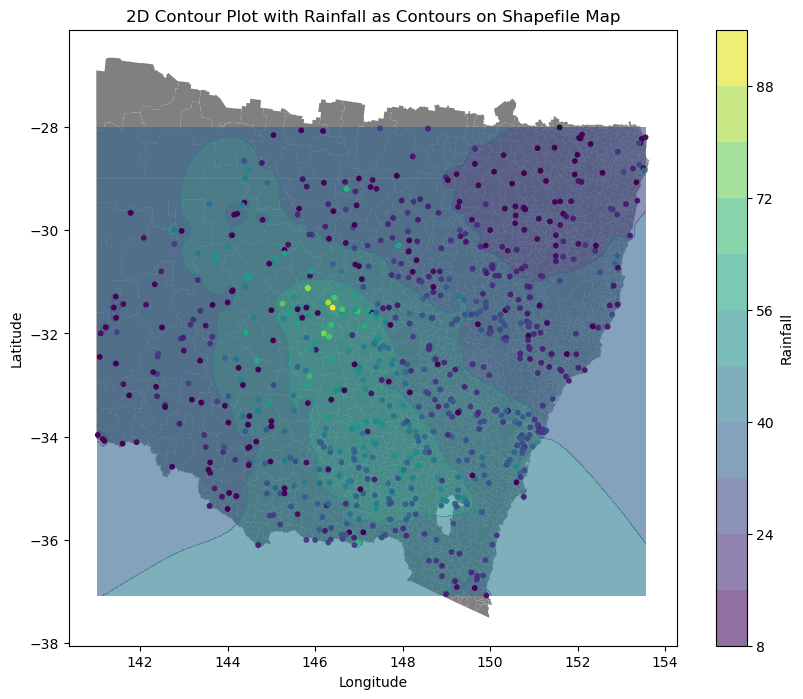

In [9]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas as gpd

# Extract the necessary columns
rainfall = x_cleaned['Rainfall 1891-01-17']
latitude = x_cleaned['Latitude']
longitude = x_cleaned['Longitude']

# Create a grid of points
x = longitude.values
y = latitude.values
z = rainfall.values

# Create a grid of points
xi, yi = np.meshgrid(np.linspace(x.min(), x.max(), 100), np.linspace(y.min(), y.max(), 100))
zi = np.zeros(xi.shape)

# Interpolate the rainfall data on the grid
for i in range(len(xi)):
    for j in range(len(yi)):
        distances = np.sqrt((x - xi[i, j])**2 + (y - yi[i, j])**2)
        weights = 1 / (distances + 1e-6)
        zi[i, j] = np.sum(weights * z) / np.sum(weights)

# Read the shapefile
shapefile_path = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\combined_shapefile.shp'  # Replace with the path to your shapefile
gdf = gpd.read_file(shapefile_path)

# Plot the shapefile map
fig, ax = plt.subplots(figsize=(10, 8))
gdf.plot(ax=ax, color='gray', edgecolor='none')

# Plot the 2D contour plot with rainfall as contours
contour = ax.contourf(xi, yi, zi, levels=10, cmap="viridis", alpha=0.6)
plt.colorbar(contour, ax=ax, label='Rainfall')
ax.scatter(x, y, c=z, cmap='viridis', s=10)

ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_title('2D Contour Plot with Rainfall as Contours on Shapefile Map')
plt.show()


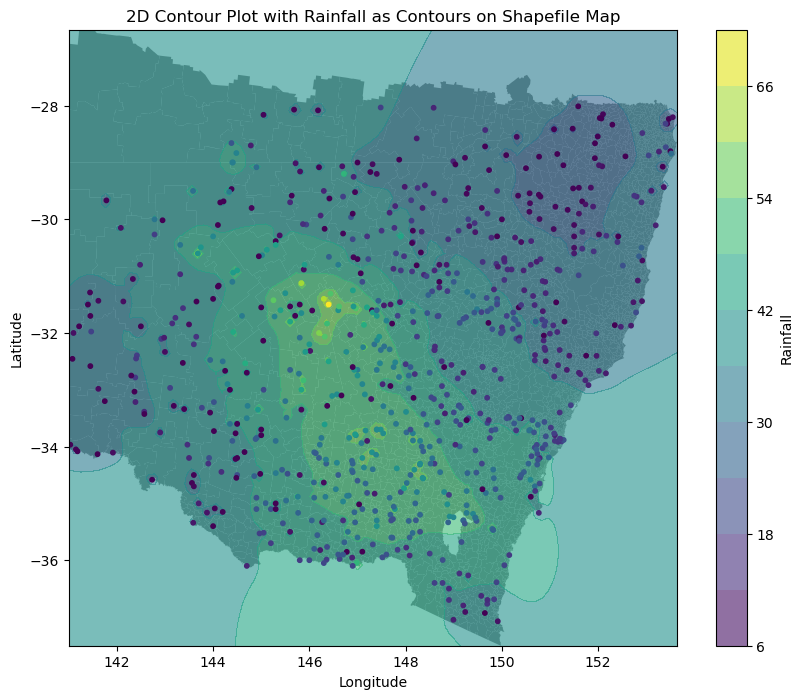

In [10]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas as gpd

# Extract the necessary columns
rainfall = x_cleaned['Rainfall 1891-01-17']
latitude = x_cleaned['Latitude']
longitude = x_cleaned['Longitude']

# Read the shapefile
shapefile_path = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\combined_shapefile.shp'  # Replace with the path to your shapefile
gdf = gpd.read_file(shapefile_path)

# Get the bounds of the shapefile
minx, miny, maxx, maxy = gdf.total_bounds

# Create a grid of points within the bounds
xi, yi = np.meshgrid(np.linspace(minx, maxx, 100), np.linspace(miny, maxy, 100))
zi = np.zeros(xi.shape)

# Interpolate the rainfall data on the grid
for i in range(len(xi)):
    for j in range(len(yi)):
        distances = np.sqrt((longitude.values - xi[i, j])**2 + (latitude.values - yi[i, j])**2)
        weights = 1 / (distances + 1e-6)
        zi[i, j] = np.sum(weights * rainfall.values) / np.sum(weights)

# Plot the shapefile map
fig, ax = plt.subplots(figsize=(10, 8))
gdf.plot(ax=ax, color='gray', edgecolor='none')

# Plot the 2D contour plot with rainfall as contours
contour = ax.contourf(xi, yi, zi, levels=10, cmap="viridis", alpha=0.6)
plt.colorbar(contour, ax=ax, label='Rainfall')
ax.scatter(longitude, latitude, c=rainfall, cmap='viridis', s=10)

ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_title('2D Contour Plot with Rainfall as Contours on Shapefile Map')
plt.show()


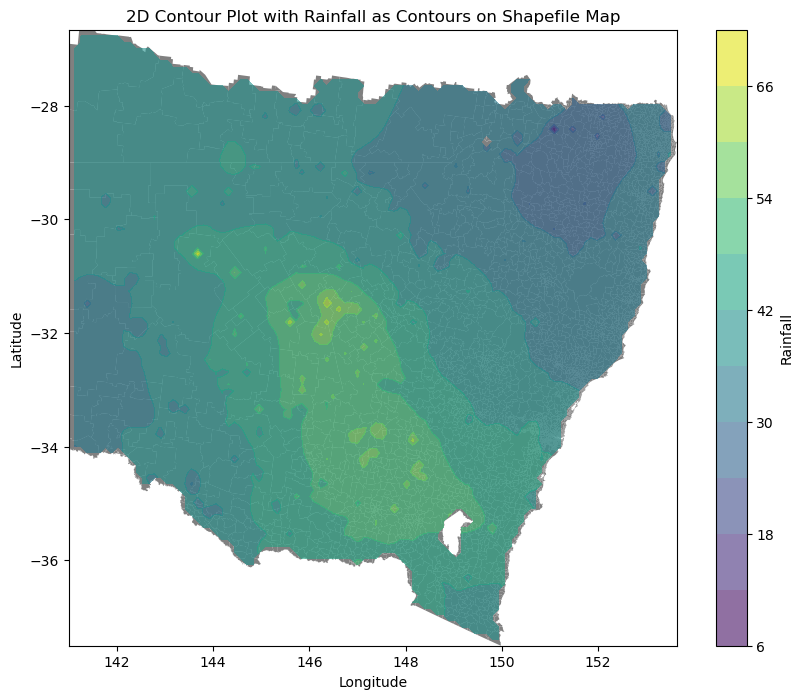

In [12]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point

# Extract the necessary columns
rainfall = x_cleaned['Rainfall 1891-01-17']
latitude = x_cleaned['Latitude']
longitude = x_cleaned['Longitude']

# Read the shapefile
shapefile_path = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\combined_shapefile.shp' # Replace with the path to your shapefile
gdf = gpd.read_file(shapefile_path)

# Get the bounds of the shapefile
minx, miny, maxx, maxy = gdf.total_bounds

# Create a grid of points within the bounds
xi, yi = np.meshgrid(np.linspace(minx, maxx, 100), np.linspace(miny, maxy, 100))
zi = np.zeros(xi.shape)

# Mask the grid to include only points inside the shapefile geometry
points = np.vstack((xi.flatten(), yi.flatten())).T
mask = np.array([gdf.contains(Point(point)).any() for point in points])
mask = mask.reshape(xi.shape)

# Interpolate the rainfall data on the masked grid
for i in range(len(xi)):
    for j in range(len(yi)):
        if mask[i, j]:  # Only interpolate if the point is inside the shapefile geometry
            distances = np.sqrt((longitude.values - xi[i, j])**2 + (latitude.values - yi[i, j])**2)
            weights = 1 / (distances + 1e-6)
            zi[i, j] = np.sum(weights * rainfall.values) / np.sum(weights)
        else:
            zi[i, j] = np.nan  # Assign NaN to points outside the geometry

# Plot the shapefile map
fig, ax = plt.subplots(figsize=(10, 8))
gdf.plot(ax=ax, color='gray', edgecolor='none')

# Plot the 2D contour plot with rainfall as contours
contour = ax.contourf(xi, yi, zi, levels=10, cmap="viridis", alpha=0.6)
plt.colorbar(contour, ax=ax, label='Rainfall')


ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_title('2D Contour Plot with Rainfall as Contours on Shapefile Map')
plt.show()


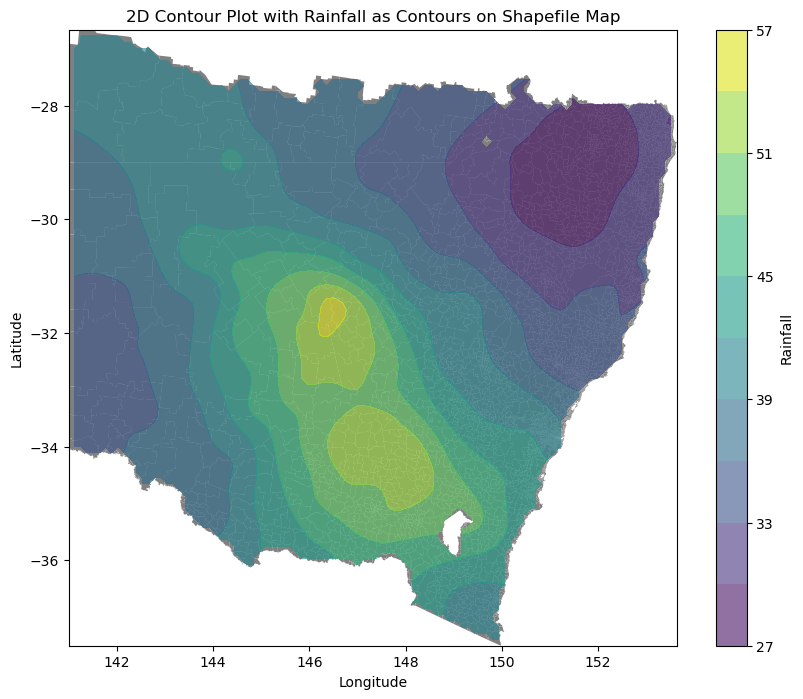

In [10]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
from scipy.ndimage import gaussian_filter

# Load the CSV file
df = pd.read_csv(r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 5 - 1891-01-11 to 1891-01-17.csv')

# Extract necessary columns
x = df[['Latitude', 'Longitude', 'Rainfall 1891-01-17']]
x_cleaned = x.dropna()

# Extract the necessary columns
rainfall = x_cleaned['Rainfall 1891-01-17']
latitude = x_cleaned['Latitude']
longitude = x_cleaned['Longitude']

# Read the shapefile
shapefile_path = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\combined_shapefile.shp'
gdf = gpd.read_file(shapefile_path)

# Get the bounds of the shapefile
minx, miny, maxx, maxy = gdf.total_bounds

# Create a grid of points within the bounds
xi, yi = np.meshgrid(np.linspace(minx, maxx, 100), np.linspace(miny, maxy, 100))
zi = np.zeros(xi.shape)

# Interpolate the rainfall data on the grid
for i in range(len(xi)):
    for j in range(len(yi)):
        distances = np.sqrt((longitude.values - xi[i, j])**2 + (latitude.values - yi[i, j])**2)
        weights = 1 / (distances + 1e-6)
        zi[i, j] = np.sum(weights * rainfall.values) / np.sum(weights)

# Apply Gaussian filtering to smooth the data
zi_smoothed = gaussian_filter(zi, sigma=2)

# Mask the grid to include only points inside the shapefile geometry
points = np.vstack((xi.flatten(), yi.flatten())).T
mask = np.array([gdf.contains(Point(point)).any() for point in points])
mask = mask.reshape(xi.shape)
zi_smoothed = np.where(mask, zi_smoothed, np.nan)

# Plot the shapefile map
fig, ax = plt.subplots(figsize=(10, 8))
gdf.plot(ax=ax, color='gray', edgecolor='none')

# Plot the 2D contour plot with rainfall as contours
contour = ax.contourf(xi, yi, zi_smoothed, levels=10, cmap="viridis", alpha=0.6)
plt.colorbar(contour, ax=ax, label='Rainfall')

ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_title('2D Contour Plot with Rainfall as Contours on Shapefile Map')
plt.show()


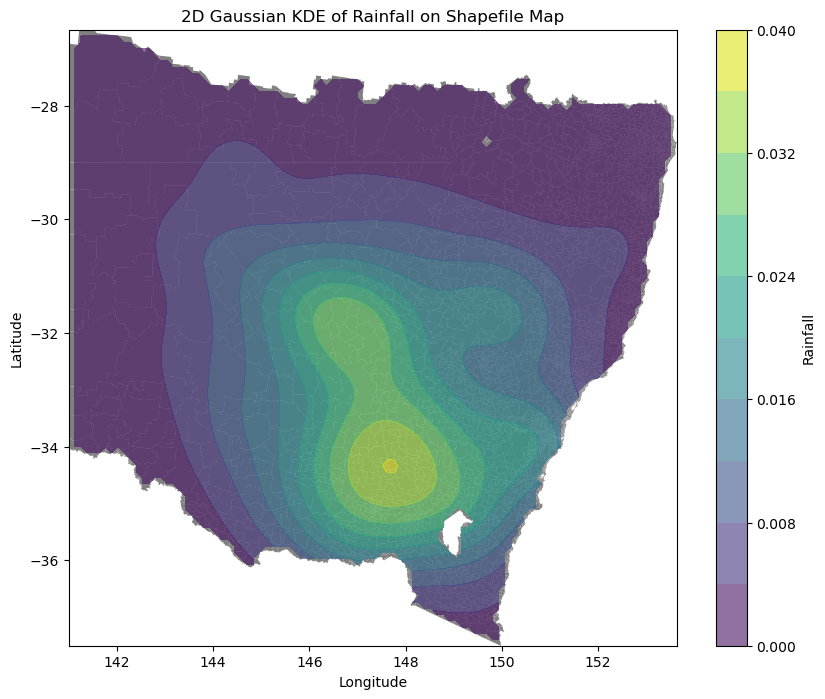

In [13]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
from scipy.stats import gaussian_kde

# Extract the necessary columns
rainfall = x_cleaned['Rainfall 1891-01-17']
latitude = x_cleaned['Latitude']
longitude = x_cleaned['Longitude']

# Read the shapefile
shapefile_path = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\combined_shapefile.shp'  # Replace with the path to your shapefile
gdf = gpd.read_file(shapefile_path)

# Get the bounds of the shapefile
minx, miny, maxx, maxy = gdf.total_bounds

# Create a grid of points within the bounds
xi, yi = np.meshgrid(np.linspace(minx, maxx, 100), np.linspace(miny, maxy, 100))

# Flatten the grid to pass into the KDE function
positions = np.vstack([xi.ravel(), yi.ravel()])

# Perform Gaussian KDE on the rainfall data
values = np.vstack([longitude, latitude])
kde = gaussian_kde(values, weights=rainfall, bw_method='scott')
zi = kde(positions).reshape(xi.shape)

# Mask the grid to include only points inside the shapefile geometry
points = np.vstack((xi.flatten(), yi.flatten())).T
mask = np.array([gdf.contains(Point(point)).any() for point in points])
mask = mask.reshape(xi.shape)
zi = np.where(mask, zi, np.nan)

# Plot the shapefile map
fig, ax = plt.subplots(figsize=(10, 8))
gdf.plot(ax=ax, color='gray', edgecolor='none')

# Plot the 2D contour plot with rainfall as contours
contour = ax.contourf(xi, yi, zi, levels=10, cmap="viridis", alpha=0.6)
plt.colorbar(contour, ax=ax, label='Rainfall')

ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_title('2D Gaussian KDE of Rainfall on Shapefile Map')
plt.show()


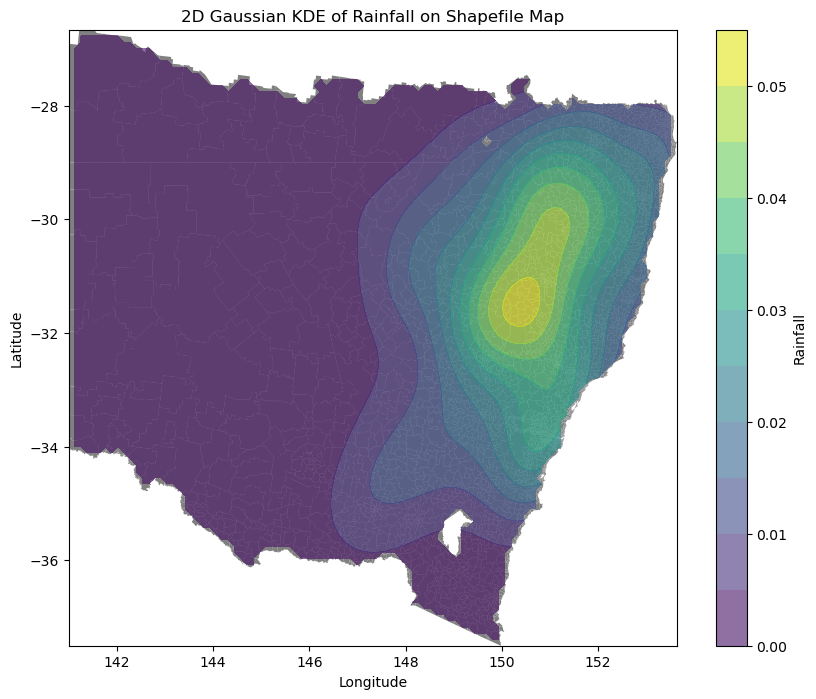

In [16]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
from scipy.stats import gaussian_kde

df=pd.read_csv(r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 5 - 1891-01-11 to 1891-01-17.csv')
df.head()

x=df[['Latitude','Longitude','Rainfall 1891-01-11']]
x.head()

x_cleaned=x.dropna()
x_cleaned.head(10)
# Extract the necessary columns
rainfall = x_cleaned['Rainfall 1891-01-11']
latitude = x_cleaned['Latitude']
longitude = x_cleaned['Longitude']

# Read the shapefile
shapefile_path = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\combined_shapefile.shp'  # Replace with the path to your shapefile
gdf = gpd.read_file(shapefile_path)

# Get the bounds of the shapefile
minx, miny, maxx, maxy = gdf.total_bounds

# Create a grid of points within the bounds
xi, yi = np.meshgrid(np.linspace(minx, maxx, 100), np.linspace(miny, maxy, 100))

# Flatten the grid to pass into the KDE function
positions = np.vstack([xi.ravel(), yi.ravel()])

# Perform Gaussian KDE on the rainfall data
values = np.vstack([longitude, latitude])
kde = gaussian_kde(values, weights=rainfall, bw_method='scott')
zi = kde(positions).reshape(xi.shape)

# Mask the grid to include only points inside the shapefile geometry
points = np.vstack((xi.flatten(), yi.flatten())).T
mask = np.array([gdf.contains(Point(point)).any() for point in points])
mask = mask.reshape(xi.shape)
zi = np.where(mask, zi, np.nan)

# Plot the shapefile map
fig, ax = plt.subplots(figsize=(10, 8))
gdf.plot(ax=ax, color='gray', edgecolor='none')

# Plot the 2D contour plot with rainfall as contours
contour = ax.contourf(xi, yi, zi, levels=10, cmap="viridis", alpha=0.6)
plt.colorbar(contour, ax=ax, label='Rainfall')

ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_title('2D Gaussian KDE of Rainfall on Shapefile Map')
plt.show()


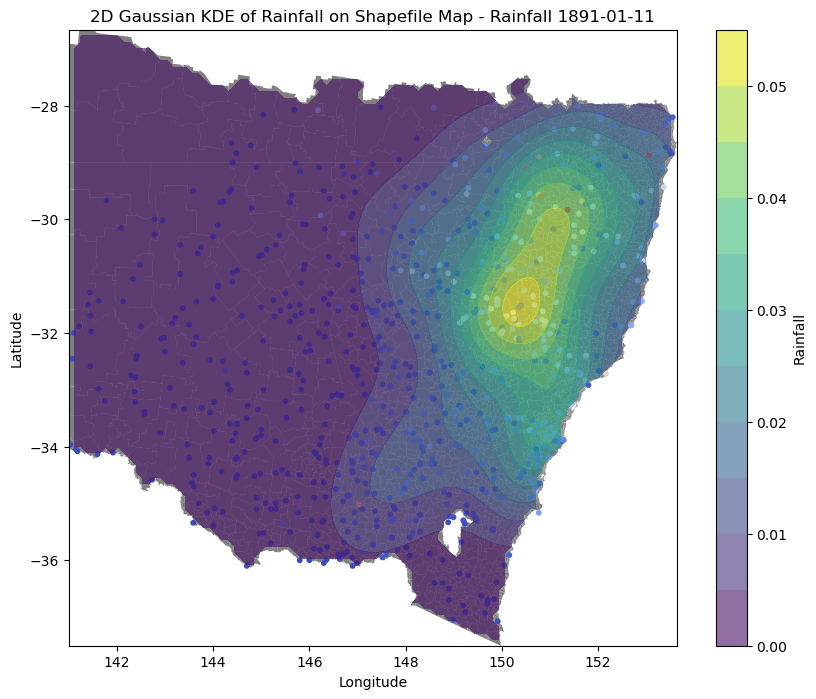

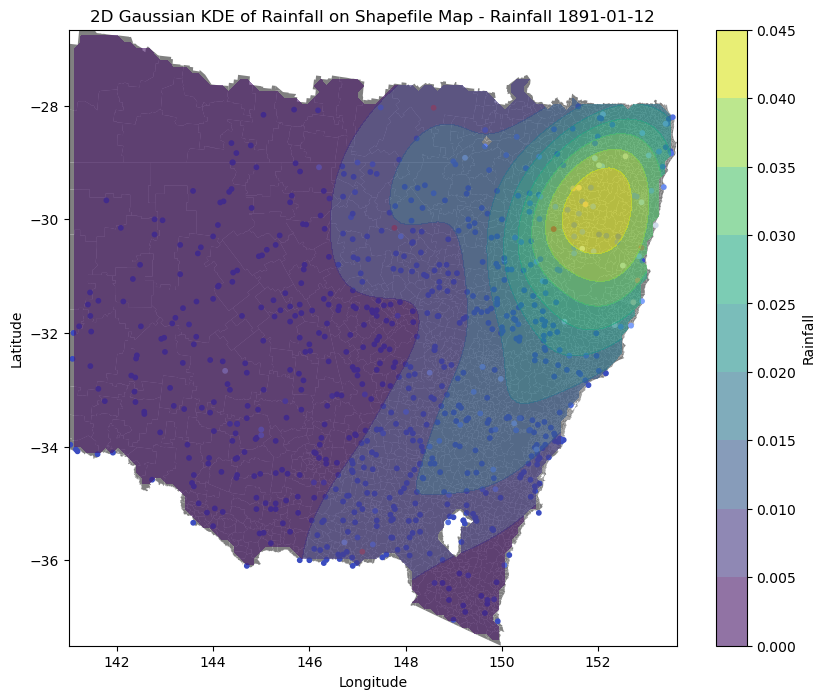

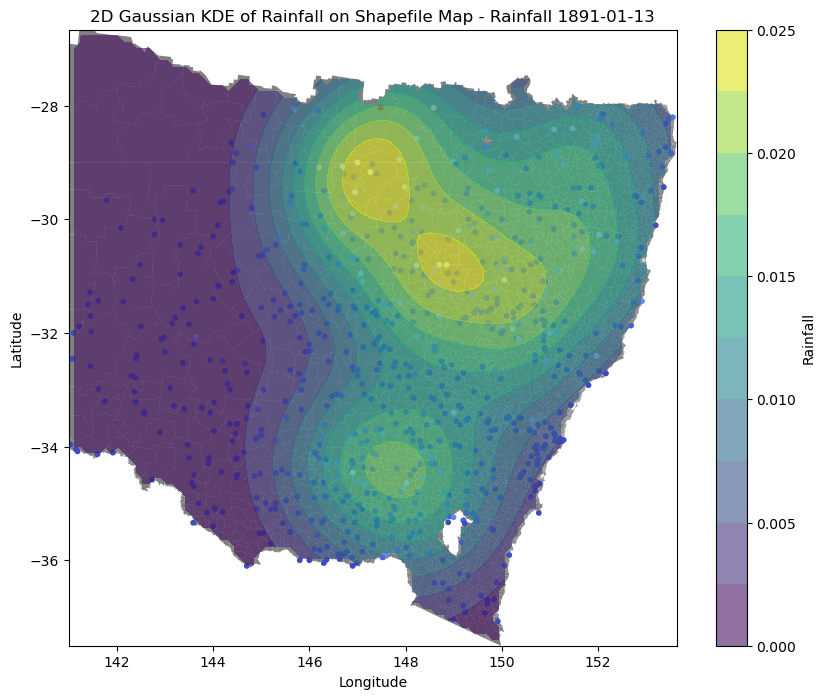

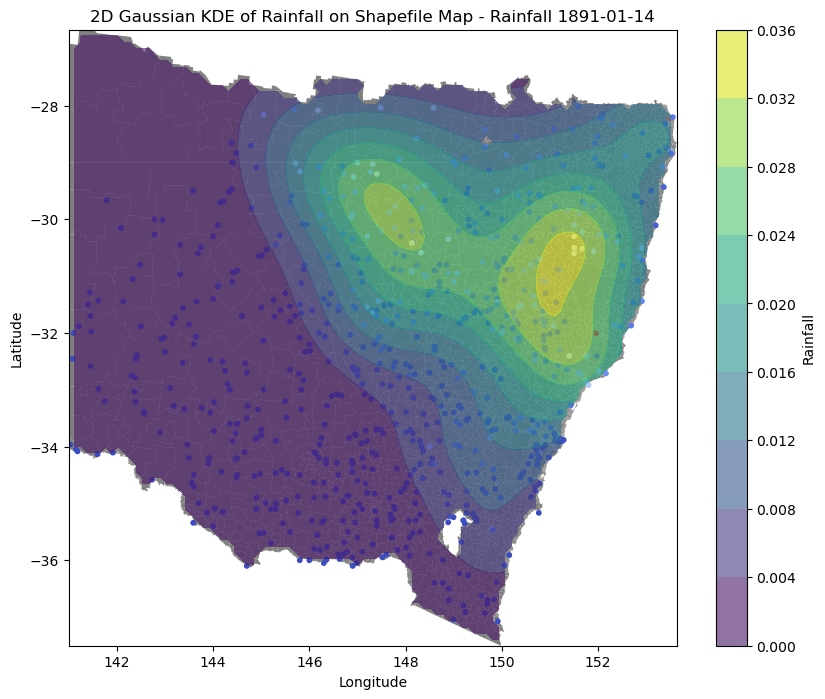

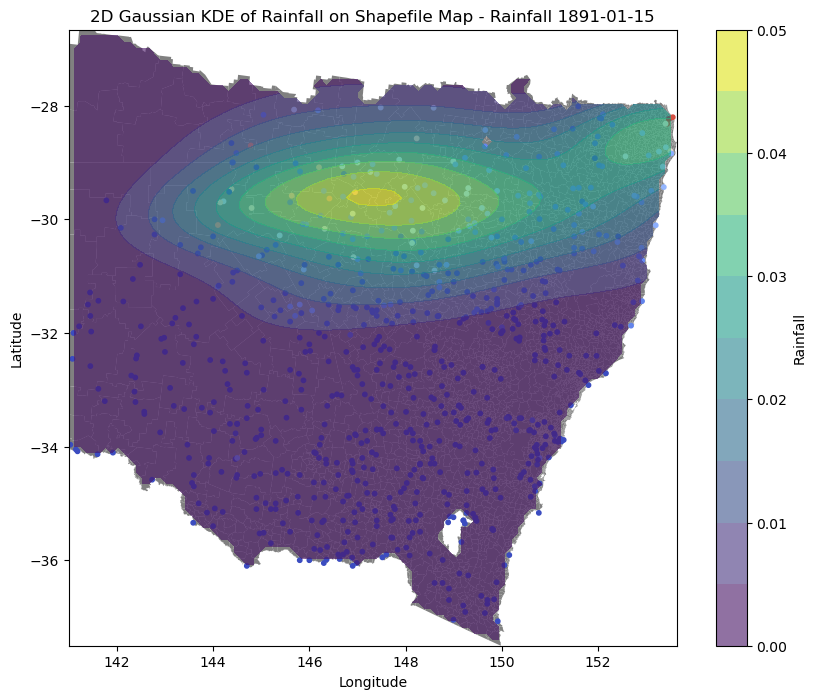

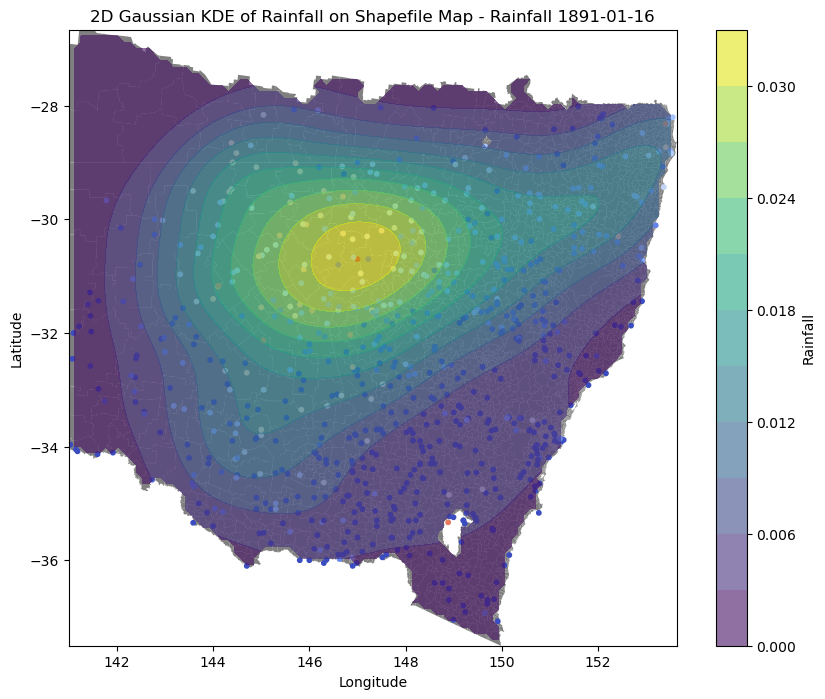

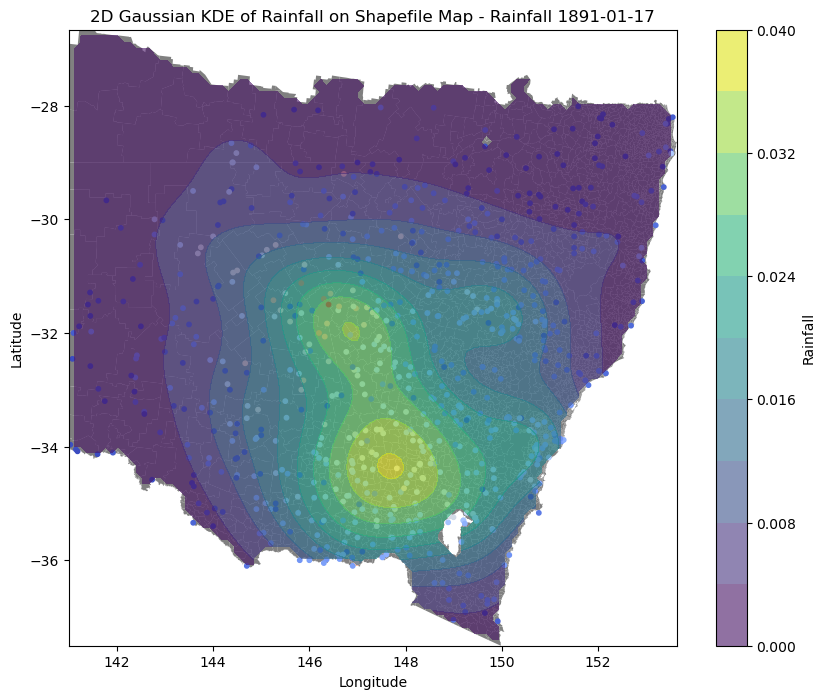

In [123]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
from scipy.stats import gaussian_kde

# Load the CSV file
df = pd.read_csv(r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 5 - 1891-01-11 to 1891-01-17.csv')
x = df[['Latitude', 'Longitude', 'Rainfall 1891-01-11', 'Rainfall 1891-01-12', 'Rainfall 1891-01-13', 'Rainfall 1891-01-14', 'Rainfall 1891-01-15', 'Rainfall 1891-01-16', 'Rainfall 1891-01-17']]
x_cleaned = x.dropna()

# Extract the necessary columns for latitude and longitude
latitude = x_cleaned['Latitude']
longitude = x_cleaned['Longitude']

# Read the shapefile
shapefile_path = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\combined_shapefile.shp'  # Replace with the path to your shapefile
gdf = gpd.read_file(shapefile_path)

# Get the bounds of the shapefile
minx, miny, maxx, maxy = gdf.total_bounds

# Create a grid of points within the bounds
xi, yi = np.meshgrid(np.linspace(minx, maxx, 100), np.linspace(miny, maxy, 100))

# Flatten the grid to pass into the KDE function
positions = np.vstack([xi.ravel(), yi.ravel()])

# Loop through each day's rainfall column and generate plots
rainfall_columns = ['Rainfall 1891-01-11', 'Rainfall 1891-01-12', 'Rainfall 1891-01-13', 'Rainfall 1891-01-14', 'Rainfall 1891-01-15', 'Rainfall 1891-01-16', 'Rainfall 1891-01-17']

for col in rainfall_columns:
    rainfall = x_cleaned[col]

    # Perform Gaussian KDE on the rainfall data
    values = np.vstack([longitude, latitude])
    kde = gaussian_kde(values, weights=rainfall, bw_method='scott')
    zi = kde(positions).reshape(xi.shape)

    # Mask the grid to include only points inside the shapefile geometry
    points = np.vstack((xi.flatten(), yi.flatten())).T
    mask = np.array([gdf.contains(Point(point)).any() for point in points])
    mask = mask.reshape(xi.shape)
    zi = np.where(mask, zi, np.nan)

    # Plot the shapefile map
    fig, ax = plt.subplots(figsize=(10, 8))
    gdf.plot(ax=ax, color='gray', edgecolor='none')

    # Plot the 2D contour plot with rainfall as contours
    ax.scatter(longitude, latitude, c=rainfall, cmap='coolwarm', s=10)
    contour = ax.contourf(xi, yi, zi, levels=10, cmap="viridis", alpha=0.6)
    plt.colorbar(contour, ax=ax, label='Rainfall')

    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_title(f'2D Gaussian KDE of Rainfall on Shapefile Map - {col}')
    plt.show()


In [34]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
from scipy.stats import gaussian_kde
import imageio
import os

# Load the CSV file
csv_file = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 5 - 1891-01-11 to 1891-01-17.csv'
df = pd.read_csv(csv_file)
x = df[['Latitude', 'Longitude', 'Rainfall 1891-01-11', 'Rainfall 1891-01-12', 'Rainfall 1891-01-13', 'Rainfall 1891-01-14', 'Rainfall 1891-01-15', 'Rainfall 1891-01-16', 'Rainfall 1891-01-17']]
x_cleaned = x.dropna()

# Extract the necessary columns for latitude and longitude
latitude = x_cleaned['Latitude']
longitude = x_cleaned['Longitude']

# Read the shapefile
shapefile_path = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\combined_shapefile.shp'  # Replace with the path to your shapefile
gdf = gpd.read_file(shapefile_path)

# Get the bounds of the shapefile
minx, miny, maxx, maxy = gdf.total_bounds

# Create a grid of points within the bounds
xi, yi = np.meshgrid(np.linspace(minx, maxx, 100), np.linspace(miny, maxy, 100))

# Flatten the grid to pass into the KDE function
positions = np.vstack([xi.ravel(), yi.ravel()])

# Loop through each day's rainfall column and generate plots
rainfall_columns = ['Rainfall 1891-01-11', 'Rainfall 1891-01-12', 'Rainfall 1891-01-13', 'Rainfall 1891-01-14', 'Rainfall 1891-01-15', 'Rainfall 1891-01-16', 'Rainfall 1891-01-17']

# User-defined directory to save the GIF and folder
output_directory = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Map_KDE_Plots'
excel_file_name = os.path.splitext(os.path.basename(csv_file))[0]
folder_path = os.path.join(output_directory, excel_file_name)

# Create the directory if it doesn't exist
os.makedirs(folder_path, exist_ok=True)

# GIF filename
gif_filename = os.path.join(folder_path, 'rainfall_animation.gif')

images = []

# Loop through each column and generate plots
for col in rainfall_columns:
    rainfall = x_cleaned[col]

    # Perform Gaussian KDE on the rainfall data
    values = np.vstack([longitude, latitude])
    kde = gaussian_kde(values, weights=rainfall, bw_method='scott')
    zi = kde(positions).reshape(xi.shape)

    # Mask the grid to include only points inside the shapefile geometry
    points = np.vstack((xi.flatten(), yi.flatten())).T
    mask = np.array([gdf.contains(Point(point)).any() for point in points])
    mask = mask.reshape(xi.shape)
    zi = np.where(mask, zi, np.nan)

    # Plot the shapefile map
    fig, ax = plt.subplots(figsize=(10, 8))
    gdf.plot(ax=ax, color='gray', edgecolor='none')

    # Plot the 2D contour plot with rainfall as contours
    contour = ax.contourf(xi, yi, zi, levels=10, cmap="viridis", alpha=0.6)
    plt.colorbar(contour, ax=ax, label='Rainfall')

    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_title(f'2D Gaussian KDE of Rainfall on Shapefile Map - {col}')

    # Save the current plot as an image
    image_path = os.path.join(folder_path, f'rainfall_{col}.png')
    plt.savefig(image_path)
    plt.close(fig)

    # Append the image path to the list
    images.append(imageio.imread(image_path))

# Create a GIF from the images with reduced duration for each frame
imageio.mimsave(gif_filename, images, duration=1000,loop=0)

print(f"GIF saved at {gif_filename}")


C:\Users\RUCHITSANDIP\AppData\Local\Temp\ipykernel_7360\909013822.py:83: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(image_path))
C:\Users\RUCHITSANDIP\AppData\Local\Temp\ipykernel_7360\909013822.py:83: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(image_path))
C:\Users\RUCHITSANDIP\AppData\Local\Temp\ipykernel_7360\909013822.py:83: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio

GIF saved at C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Map_KDE_Plots\Event 5 - 1891-01-11 to 1891-01-17\rainfall_animation.gif


In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
from scipy.stats import gaussian_kde
import imageio
import os

# Load the CSV file
csv_file = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 5 - 1891-01-11 to 1891-01-17.csv'
df = pd.read_csv(csv_file)
x = df[['Latitude', 'Longitude', 'Rainfall 1891-01-11', 'Rainfall 1891-01-12', 'Rainfall 1891-01-13', 'Rainfall 1891-01-14', 'Rainfall 1891-01-15', 'Rainfall 1891-01-16', 'Rainfall 1891-01-17']]
x_cleaned = x.dropna()

# Extract the necessary columns for latitude and longitude
latitude = x_cleaned['Latitude']
longitude = x_cleaned['Longitude']

# Read the shapefile
shapefile_path = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\combined_shapefile.shp'  # Replace with the path to your shapefile
gdf = gpd.read_file(shapefile_path)

# Get the bounds of the shapefile
minx, miny, maxx, maxy = gdf.total_bounds

# Create a grid of points within the bounds
xi, yi = np.meshgrid(np.linspace(minx, maxx, 100), np.linspace(miny, maxy, 100))

# Flatten the grid to pass into the KDE function
positions = np.vstack([xi.ravel(), yi.ravel()])

# Loop through each day's rainfall column and generate plots
rainfall_columns = ['Rainfall 1891-01-11', 'Rainfall 1891-01-12', 'Rainfall 1891-01-13', 'Rainfall 1891-01-14', 'Rainfall 1891-01-15', 'Rainfall 1891-01-16', 'Rainfall 1891-01-17']

# User-defined directory to save the GIF and folder
output_directory = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Map_KDE_Plots'
excel_file_name = os.path.splitext(os.path.basename(csv_file))[0]
folder_path = os.path.join(output_directory, excel_file_name)

# Create the directory if it doesn't exist
os.makedirs(folder_path, exist_ok=True)

# GIF filename
gif_filename = os.path.join(folder_path, 'rainfall_animation.gif')

images = []

# Loop through each column and generate plots
for col in rainfall_columns:
    rainfall = x_cleaned[col]

    # Perform Gaussian KDE on the rainfall data
    values = np.vstack([longitude, latitude])
    kde = gaussian_kde(values, weights=rainfall, bw_method='scott')
    zi = kde(positions).reshape(xi.shape)

    # Mask the grid to include only points inside the shapefile geometry
    points = np.vstack((xi.flatten(), yi.flatten())).T
    mask = np.array([gdf.contains(Point(point)).any() for point in points])
    mask = mask.reshape(xi.shape)
    zi = np.where(mask, zi, np.nan)

    # Plot the shapefile map
    fig, ax = plt.subplots(figsize=(10, 8))
    gdf.plot(ax=ax, color='gray', edgecolor='none')

    # Plot the 2D contour plot with rainfall as contours
    contour = ax.contourf(xi, yi, zi, levels=10, cmap="viridis", alpha=0.6)
    

    

    # Save the current plot as an image
    image_path = os.path.join(folder_path, f'rainfall_{col}.png')
    plt.savefig(image_path)
    plt.close(fig)

    # Append the image path to the list
    images.append(imageio.imread(image_path))

# Create a GIF from the images with reduced duration for each frame
imageio.mimsave(gif_filename, images, duration=1000,loop=0)

print(f"GIF saved at {gif_filename}")


C:\Users\RUCHITSANDIP\AppData\Local\Temp\ipykernel_16032\2849119378.py:81: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(image_path))
C:\Users\RUCHITSANDIP\AppData\Local\Temp\ipykernel_16032\2849119378.py:81: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(image_path))
C:\Users\RUCHITSANDIP\AppData\Local\Temp\ipykernel_16032\2849119378.py:81: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import i

GIF saved at C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Map_KDE_Plots\Event 5 - 1891-01-11 to 1891-01-17\rainfall_animation.gif


In [36]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
from scipy.stats import gaussian_kde
import imageio
import os

# Load the CSV file
csv_file = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 973 - 1892-04-10 to 1892-04-16.csv'
df = pd.read_csv(csv_file)
x = df[['Latitude', 'Longitude', 'Rainfall 1892-04-10', 'Rainfall 1892-04-11', 'Rainfall 1892-04-12', 'Rainfall 1892-04-13', 'Rainfall 1892-04-14', 'Rainfall 1892-04-15', 'Rainfall 1892-04-16']]
x_cleaned = x.dropna()

# Extract the necessary columns for latitude and longitude
latitude = x_cleaned['Latitude']
longitude = x_cleaned['Longitude']

# Read the shapefile
shapefile_path = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\combined_shapefile.shp'  # Replace with the path to your shapefile
gdf = gpd.read_file(shapefile_path)

# Get the bounds of the shapefile
minx, miny, maxx, maxy = gdf.total_bounds

# Create a grid of points within the bounds
xi, yi = np.meshgrid(np.linspace(minx, maxx, 100), np.linspace(miny, maxy, 100))

# Flatten the grid to pass into the KDE function
positions = np.vstack([xi.ravel(), yi.ravel()])

# Loop through each day's rainfall column and generate plots
rainfall_columns = ['Rainfall 1892-04-10','Rainfall 1892-04-11', 'Rainfall 1892-04-12', 'Rainfall 1892-04-13', 'Rainfall 1892-04-14', 'Rainfall 1892-04-15', 'Rainfall 1892-04-16']

# User-defined directory to save the GIF and folder
output_directory = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Map_KDE_Plots'
excel_file_name = os.path.splitext(os.path.basename(csv_file))[0]
folder_path = os.path.join(output_directory, excel_file_name)

# Create the directory if it doesn't exist
os.makedirs(folder_path, exist_ok=True)

# GIF filename
gif_filename = os.path.join(folder_path, 'rainfall_animation.gif')

images = []

# Loop through each column and generate plots
for col in rainfall_columns:
    rainfall = x_cleaned[col]

    # Perform Gaussian KDE on the rainfall data
    values = np.vstack([longitude, latitude])
    kde = gaussian_kde(values, weights=rainfall, bw_method='scott')
    zi = kde(positions).reshape(xi.shape)

    # Mask the grid to include only points inside the shapefile geometry
    points = np.vstack((xi.flatten(), yi.flatten())).T
    mask = np.array([gdf.contains(Point(point)).any() for point in points])
    mask = mask.reshape(xi.shape)
    zi = np.where(mask, zi, np.nan)

    # Plot the shapefile map
    fig, ax = plt.subplots(figsize=(10, 8))
    gdf.plot(ax=ax, color='gray', edgecolor='none')

    # Plot the 2D contour plot with rainfall as contours
    contour = ax.contourf(xi, yi, zi, levels=10, cmap="viridis", alpha=0.6)
    plt.colorbar(contour, ax=ax, label='Rainfall')

    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_title(f'2D Gaussian KDE of Rainfall on Shapefile Map - {col}')

    # Save the current plot as an image
    image_path = os.path.join(folder_path, f'rainfall_{col}.png')
    plt.savefig(image_path)
    plt.close(fig)

    # Append the image path to the list
    images.append(imageio.imread(image_path))

# Create a GIF from the images with reduced duration for each frame
imageio.mimsave(gif_filename, images, duration=1000,loop=0)

print(f"GIF saved at {gif_filename}")


C:\Users\RUCHITSANDIP\AppData\Local\Temp\ipykernel_7360\3846522027.py:83: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(image_path))
C:\Users\RUCHITSANDIP\AppData\Local\Temp\ipykernel_7360\3846522027.py:83: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(image_path))
C:\Users\RUCHITSANDIP\AppData\Local\Temp\ipykernel_7360\3846522027.py:83: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imag

GIF saved at C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Map_KDE_Plots\Event 973 - 1892-04-10 to 1892-04-16\rainfall_animation.gif


In [44]:
import pandas as pd

# Paths to your Excel files
excel_file_first = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 5 - 1891-01-11 to 1891-01-17.csv'
excel_file_second = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\R1_99_New Events.xlsx'

# Read CSV file
df_csv = pd.read_csv(excel_file_first)

# Read Excel file
df_excel = pd.read_excel(excel_file_second)

# Extracting non-empty Event names from the second Excel file
event_names = df_excel['Event'].dropna().unique()

# Assuming you want to find the first match:
matching_event = None
for event_name in event_names:
    if event_name in excel_file_first:
        matching_event = event_name
        break

if matching_event:
    print(f"Matching Event found: {matching_event}")
else:
    print("No matching Event found.")


Matching Event found: Event 5 - 1891-01-11 to 1891-01-17


In [73]:
import pandas as pd

# Path to your Excel file
excel_file_second = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\R1_99_New Events.xlsx'

# Load the Excel file into a pandas DataFrame
df = pd.read_excel(excel_file_second)

# Specify the event name to find
event_name_to_find = "Event 1 - 1889-07-14 to 1889-07-20"

# Initialize variables to track current event
current_event = None
station_numbers = []

# Flag to indicate if we've found the first occurrence of the specified event
found_first_event = False

# Iterate through each row of the DataFrame
for index, row in df.iterrows():
    event_name_row = row['Event']
    station_number = row['Station Number']
    
    # If we haven't found the first event yet, check if this row matches the event we're looking for
    if not found_first_event:
        if pd.notna(event_name_row) and event_name_row == event_name_to_find:
            found_first_event = True
            current_event = event_name_row
    
    # Once we've found the first event, start collecting station numbers until event name changes
    if found_first_event:
        # If event name changes and is not NaN, stop collecting
        if pd.notna(event_name_row) and event_name_row != current_event:
            break
        
        # Collect station number if it's not NaN
        if pd.notna(station_number):
            station_numbers.append(station_number)

# Print the collected station numbers for the first occurrence of the event
print(f"Event: {current_event}, Station Numbers: {', '.join(map(str, station_numbers))}")


Event: Event 1 - 1889-07-14 to 1889-07-20, Station Numbers: Station Number: 58142, Station Number: 58013, Station Number: 58018, Station Number: 58085, Station Number: 58061, Station Number: 58037, Station Number: 58037, Station Number: 58012, Station Number: 58038, Station Number: 58024, Station Number: 58063, Station Number: 58063, Station Number: 58048, Station Number: 58090, Station Number: 58090, Station Number: 58190, Station Number: 57010, Station Number: 57010, Station Number: 59093, Station Number: 59093, Station Number: 56207, Station Number: 41056, Station Number: 44096, Station Number: 48100, Station Number: 41095, Station Number: 56155, Station Number: 44081, Station Number: 56032, Station Number: 48156, Station Number: 48130


In [94]:
import pandas as pd

# Path to your Excel file
excel_file_second = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\R1_99_New Events.xlsx'

# Load the Excel file into a pandas DataFrame
df = pd.read_excel(excel_file_second)

# Initialize variables to track current event and station numbers
current_event = None
station_numbers = []

# Iterate through each row of the DataFrame
for index, row in df.iterrows():
    event_name_row = row['Event']
    station_number = row['Station Number']
    
    # Check if the event name in this row is not NaN
    if pd.notna(event_name_row):
        # If current event is None or event name changes, print the collected data and reset for new event
        if current_event is None or event_name_row != current_event:
            if current_event is not None:
                print(f"Event: {current_event}, Station Numbers: {', '.join(map(str, station_numbers))}")
                print()  # Add a blank line between events for clarity
            
            # Start collecting for new event
            current_event = event_name_row
            station_numbers = []
        
    # Collect station number if it's not NaN
    if pd.notna(station_number):
        station_numbers.append(station_number)

# Print the last event after the loop ends
if current_event is not None:
    print(f"Event: {current_event}, Station Numbers: {', '.join(map(str, station_numbers))}")


Event: Event 1 - 1889-07-14 to 1889-07-20, Station Numbers: Station Number: 58142, Station Number: 58013, Station Number: 58018, Station Number: 58085, Station Number: 58061, Station Number: 58037, Station Number: 58037, Station Number: 58012, Station Number: 58038, Station Number: 58024, Station Number: 58063, Station Number: 58063, Station Number: 58048, Station Number: 58090, Station Number: 58090, Station Number: 58190, Station Number: 57010, Station Number: 57010, Station Number: 59093, Station Number: 59093, Station Number: 56207, Station Number: 41056, Station Number: 44096, Station Number: 48100, Station Number: 41095, Station Number: 56155, Station Number: 44081, Station Number: 56032, Station Number: 48156, Station Number: 48130

Event: Event 2 - 1890-01-10 to 1890-01-16, Station Numbers: Station Number: 58142, Station Number: 58142, Station Number: 58056, Station Number: 59069, Station Number: 58013, Station Number: 59018, Station Number: 60022, Station Number: 60026, Statio

In [3]:
import pandas as pd
import os

# Path to your Excel file
excel_file_second = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\R1_99_New Events.xlsx'

# Directory to save the CSV files
save_directory = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\R-99 Event Station list data'

# Load the Excel file into a pandas DataFrame
df = pd.read_excel(excel_file_second)

# Ensure the save directory exists
os.makedirs(save_directory, exist_ok=True)

# Initialize variables to track current event and station numbers
current_event = None
station_numbers = []

# Function to save station numbers to a CSV file
def save_to_csv(event_name, station_numbers):
    if event_name and station_numbers:
        data = {'Event': [event_name] * len(station_numbers), 'Station Number': station_numbers}
        df_event = pd.DataFrame(data)
        file_name = f"{event_name}.csv"
        file_path = os.path.join(save_directory, file_name)
        df_event.to_csv(file_path, index=False)

# Iterate through each row of the DataFrame
for index, row in df.iterrows():
    event_name_row = row['Event']
    station_number = row['Station Number']
    
    # Check if the event name in this row is not NaN
    if pd.notna(event_name_row):
        # If current event is None or event name changes, save the collected data and reset for new event
        if current_event is None or event_name_row != current_event:
            if current_event is not None:
                save_to_csv(current_event, station_numbers)
            
            # Start collecting for new event
            current_event = event_name_row
            station_numbers = []
        
    # Collect station number if it's not NaN
    if pd.notna(station_number):
        station_numbers.append(station_number)

# Save the last event after the loop ends
if current_event is not None:
    save_to_csv(current_event, station_numbers)

print("CSV files have been saved successfully.")


CSV files have been saved successfully.


In [4]:
import os
import pandas as pd

# Directory containing the CSV files
directory_path = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\R-99 Event Station list data'

# Iterate through each file in the directory
for file_name in os.listdir(directory_path):
    if file_name.endswith('.csv'):
        file_path = os.path.join(directory_path, file_name)
        
        # Read the CSV file into a DataFrame
        df = pd.read_csv(file_path)
        
        # Remove "Station Number" label from the Station Number column
        if 'Station Number' in df.columns:
            df['Station Number'] = df['Station Number'].str.replace('Station Number:', '').str.strip()
        
        # Save the modified DataFrame back to the CSV file
        df.to_csv(file_path, index=False)

print("Station Number labels have been removed successfully from all CSV files.")


Station Number labels have been removed successfully from all CSV files.


In [5]:
import os
import pandas as pd

# Directory with event-station CSV files
event_station_dir = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\R-99 Event Station list data'

# Directory with rainfall stored values CSV files
rainfall_values_dir = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events'

# Iterate through each file in the event-station directory
for file_name in os.listdir(event_station_dir):
    if file_name.endswith('.csv'):
        event_station_file_path = os.path.join(event_station_dir, file_name)
        
        # Read the event-station CSV file
        event_station_df = pd.read_csv(event_station_file_path)
        
        # Extract station numbers
        station_numbers = event_station_df['Station Number'].astype(str).tolist()
        
        # Find the corresponding rainfall stored values CSV file
        rainfall_values_file_path = os.path.join(rainfall_values_dir, file_name)
        
        if os.path.exists(rainfall_values_file_path):
            # Read the rainfall stored values CSV file
            rainfall_values_df = pd.read_csv(rainfall_values_file_path)
            
            # Filter rows by relevant station numbers
            filtered_rainfall_df = rainfall_values_df[rainfall_values_df['Station Number'].astype(str).isin(station_numbers)]
            
            # Save the filtered data back to the original event-station CSV file
            filtered_rainfall_df.to_csv(event_station_file_path, index=False)

print("Relevant data has been extracted and saved successfully.")


Relevant data has been extracted and saved successfully.


In [115]:
import pandas as pd

# Path to your Excel file
excel_file_second = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\R1_99_New Events.xlsx'

# Load the Excel file into a pandas DataFrame
df = pd.read_excel(excel_file_second)

# Initialize variables to track current event and station numbers
current_event = None
station_numbers = []

# Open a file to write the output
output_file = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\R1_99_New Events_station_list.txt'
with open(output_file, 'w') as f:
    # Iterate through each row of the DataFrame
    for index, row in df.iterrows():
        event_name_row = row['Event']
        station_number = row['Station Number']
        
        # Check if the event name in this row is not NaN
        if pd.notna(event_name_row):
            # If current event is None or event name changes, write the collected data and reset for new event
            if current_event is None or event_name_row != current_event:
                if current_event is not None:
                    # Write current event and station numbers to the file
                    f.write(f"Event: {current_event}, Station Numbers: {', '.join(map(str, station_numbers))}\n\n")
                
                # Start collecting for new event
                current_event = event_name_row
                station_numbers = []
            
        # Collect station number if it's not NaN
        if pd.notna(station_number):
            # Extract station number without the "Station Number:" label
            station_number = int(station_number.split(':')[-1].strip())
            station_numbers.append(station_number)
    
    # Write the last event after the loop ends
    if current_event is not None:
        f.write(f"Event: {current_event}, Station Numbers: {', '.join(map(str, station_numbers))}\n")

print(f"Output saved to: {output_file}")


Output saved to: C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\R1_99_New Events_station_list.txt


In [116]:
import os
import re

# Function to extract event name from CSV file name
def extract_event_name(csv_file_path):
    # Extract file name without extension
    file_name = os.path.splitext(os.path.basename(csv_file_path))[0]
    # Extract event name using regex
    match = re.search(r'Event (\d+) -', file_name)
    if match:
        return f"Event {match.group(1)}"
    return None

# Path to your CSV file
csv_file_path = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 5 - 1891-01-11 to 1891-01-17.csv'

# Extract event name from CSV file name
event_name_from_csv = extract_event_name(csv_file_path)

# Path to your saved output file
output_file = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\R1_99_New Events_station_list.txt'

# Initialize variables to track station numbers for matching event
station_numbers = None

# Read the output file and find station numbers for the matching event
with open(output_file, 'r') as f:
    lines = f.readlines()
    for line in lines:
        if line.startswith(f"Event: {event_name_from_csv}"):
            # Found matching event, extract station numbers
            station_numbers = re.findall(r'Station Numbers: (.+)', line)
            break

# Print the extracted station numbers if found
if station_numbers:
    print(f"Matching Event: {event_name_from_csv}")
    print(f"Station Numbers: {station_numbers[0]}")
else:
    print(f"No matching event found for {event_name_from_csv} in {output_file}")


Matching Event: Event 5
Station Numbers: 58142, 58142, 58056, 58013, 58042, 58085, 58063, 63043, 59093, 61251, 69010, 69071, 60015, 64008, 72004, 72031, 57018, 70095, 70095, 48006, 48031, 53106, 52022, 44027, 44027, 64023, 64023, 48015, 44026, 48068, 48068, 70032, 48038, 55057, 70020, 53055, 54017, 44032, 44012, 53060, 55061, 48004, 52015, 52020, 48054, 51149, 51015, 52053, 44010, 44010, 55006, 44030, 43034, 43034, 43034, 43034, 52018, 52049, 52049, 73034, 52026, 51077, 51111, 50043, 48014, 50011, 48060, 54088, 48113, 56017, 48032, 48016, 48016, 53092, 53092, 44018, 44018, 44043, 44043, 44181, 44181, 48078, 48078, 70059, 44096, 48082, 64038, 50096, 48100, 64013, 54033, 56193, 50039, 48036, 48055, 55281, 54089, 53053, 53053, 48035, 48035, 50018, 70037, 48103, 48103, 53088, 55259, 52043, 50093, 55205, 56029, 63065, 51044, 56009, 51033, 55071, 64036, 46001, 62091, 44081, 55017, 61027, 51101, 70080, 51002, 51009, 52054, 52054, 63066, 51036, 51036, 46077, 51058, 51071, 51039, 51031, 65025, 

In [121]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
from scipy.stats import gaussian_kde
import imageio
import os
import re

# Function to extract event name from CSV file name
def extract_event_name(csv_file_path):
    # Extract file name without extension
    file_name = os.path.splitext(os.path.basename(csv_file_path))[0]
    # Extract event name using regex
    match = re.search(r'Event (\d+) -', file_name)
    if match:
        return f"Event {match.group(1)}"
    return None

# Path to your CSV file
csv_file = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 5 - 1891-01-11 to 1891-01-17.csv'
df = pd.read_csv(csv_file)
x = df[['Latitude', 'Longitude', 'Rainfall 1891-01-11', 'Rainfall 1891-01-12', 'Rainfall 1891-01-13', 'Rainfall 1891-01-14', 'Rainfall 1891-01-15', 'Rainfall 1891-01-16', 'Rainfall 1891-01-17']]
x_cleaned = x.dropna()

# Extract the necessary columns for latitude and longitude
latitude = x_cleaned['Latitude']
longitude = x_cleaned['Longitude']

# Read the shapefile
shapefile_path = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\combined_shapefile.shp'  # Replace with the path to your shapefile
gdf = gpd.read_file(shapefile_path)

# Get the bounds of the shapefile
minx, miny, maxx, maxy = gdf.total_bounds

# Create a grid of points within the bounds
xi, yi = np.meshgrid(np.linspace(minx, maxx, 100), np.linspace(miny, maxy, 100))

# Flatten the grid to pass into the KDE function
positions = np.vstack([xi.ravel(), yi.ravel()])

# Paths to your saved output file and CSV file
output_file = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\R1_99_New Events_station_list.txt'
csv_file = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Rainfall Stored values for R1_99 Events\Event 5 - 1891-01-11 to 1891-01-17.csv'

# Extract event name from CSV file name
event_name_from_csv = extract_event_name(csv_file)

# Initialize list to store station numbers
station_numbers = []

# Read the output file and find station numbers for the matching event
with open(output_file, 'r') as f:
    lines = f.readlines()
    for line in lines:
        if line.startswith(f"Event: {event_name_from_csv}"):
            # Found matching event, extract station numbers
            # Extract station numbers part after "Station Numbers: "
            station_numbers_line = line.split('Station Numbers: ')[-1].strip()
            # Split by commas and convert to integers
            station_numbers = [int(num.strip()) for num in station_numbers_line.split(',')]
            break

print(f"Station Numbers extracted: {station_numbers}")

# Filter x_cleaned DataFrame for specific stations
x_filtered = x_cleaned[x_cleaned.index.isin(station_numbers)]

# Loop through each day's rainfall column and generate plots
rainfall_columns = ['Rainfall 1891-01-11', 'Rainfall 1891-01-12', 'Rainfall 1891-01-13', 'Rainfall 1891-01-14', 'Rainfall 1891-01-15', 'Rainfall 1891-01-16', 'Rainfall 1891-01-17']

# User-defined directory to save the GIF and folder
output_directory = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Map_KDE_Plots'
excel_file_name = os.path.splitext(os.path.basename(csv_file))[0]
folder_path = os.path.join(output_directory, excel_file_name)

# Create the directory if it doesn't exist
os.makedirs(folder_path, exist_ok=True)

# GIF filename
gif_filename = os.path.join(folder_path, 'rainfall_animation.gif')

images = []

# Loop through each column and generate plots
for col in rainfall_columns:
    rainfall = x_filtered[col]

    # Perform Gaussian KDE on the rainfall data
    values = np.vstack([x_filtered['Longitude'], x_filtered['Latitude']])
    kde = gaussian_kde(values, weights=rainfall, bw_method='scott')
    zi = kde(positions).reshape(xi.shape)

    # Mask the grid to include only points inside the shapefile geometry
    points = np.vstack((xi.flatten(), yi.flatten())).T
    mask = np.array([gdf.contains(Point(point)).any() for point in points])
    mask = mask.reshape(xi.shape)
    zi = np.where(mask, zi, np.nan)

    # Plot the shapefile map
    fig, ax = plt.subplots(figsize=(10, 8))
    gdf.plot(ax=ax, color='gray', edgecolor='none')

    # Plot the 2D contour plot with rainfall as contours
    contour = ax.contourf(xi, yi, zi, levels=10, cmap="viridis", alpha=0.6)
    plt.colorbar(contour, ax=ax, label='Rainfall')

    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_title(f'2D Gaussian KDE of Rainfall on Shapefile Map - {col}')

    # Save the current plot as an image
    image_path = os.path.join(folder_path, f'rainfall_{col}.png')
    plt.savefig(image_path)
    plt.close(fig)

    # Append the image path to the list
    images.append(imageio.imread(image_path))

# Create a GIF from the images with reduced duration for each frame
imageio.mimsave(gif_filename, images, duration=1000, loop=0)

print(f"GIF saved at {gif_filename}")


Station Numbers extracted: [58142, 58142, 58056, 58013, 58042, 58085, 58063, 63043, 59093, 61251, 69010, 69071, 60015, 64008, 72004, 72031, 57018, 70095, 70095, 48006, 48031, 53106, 52022, 44027, 44027, 64023, 64023, 48015, 44026, 48068, 48068, 70032, 48038, 55057, 70020, 53055, 54017, 44032, 44012, 53060, 55061, 48004, 52015, 52020, 48054, 51149, 51015, 52053, 44010, 44010, 55006, 44030, 43034, 43034, 43034, 43034, 52018, 52049, 52049, 73034, 52026, 51077, 51111, 50043, 48014, 50011, 48060, 54088, 48113, 56017, 48032, 48016, 48016, 53092, 53092, 44018, 44018, 44043, 44043, 44181, 44181, 48078, 48078, 70059, 44096, 48082, 64038, 50096, 48100, 64013, 54033, 56193, 50039, 48036, 48055, 55281, 54089, 53053, 53053, 48035, 48035, 50018, 70037, 48103, 48103, 53088, 55259, 52043, 50093, 55205, 56029, 63065, 51044, 56009, 51033, 55071, 64036, 46001, 62091, 44081, 55017, 61027, 51101, 70080, 51002, 51009, 52054, 52054, 63066, 51036, 51036, 46077, 51058, 51071, 51039, 51031, 65025, 48044, 48044,

ValueError: `dataset` input should have multiple elements.

In [6]:
import pdb

/var/folders/1_/_3k8kb7n5vz43s2kfx69bp0c0000gn/T/ipykernel_8497/3231317038.py:7: DeprecationWarning: Please import `maximum_filter` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  from scipy.ndimage.filters import maximum_filter


No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
Error processing Event 924 - 1858-12-14 to 1858-12-20: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.
Error processing Event 925 - 1859-01-04 to 1859-01-10: array must not contain infs or NaNs


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


Error processing Event 926 - 1860-03-01 to 1860-03-07: array must not contain infs or NaNs
Error processing Event 927 - 1861-01-15 to 1861-01-21: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


Error processing Event 928 - 1861-11-19 to 1861-11-25: array must not contain infs or NaNs


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 930 - 1858-03-20 to 1858-03-26: array must not contain infs or NaNs


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)
/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


Error processing Event 931 - 1859-02-12 to 1859-02-18: array must not contain infs or NaNs
Error processing Event 932 - 1859-11-13 to 1859-11-19: array must not contain infs or NaNs


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 933 - 1861-02-01 to 1861-02-07: array must not contain infs or NaNs
Error processing Event 934 - 1861-06-22 to 1861-06-28: array must not contain infs or NaNs
Error processing Event 936 - 1863-01-23 to 1863-01-29: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.
Error processing Event 937 - 1863-02-12 to 1863-02-18: array must not contain infs or NaNs


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)
/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 938 - 1863-03-30 to 1863-04-05: array must not contain infs or NaNs
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
Error processing Event 939 - 1863-04-20 to 1863-04-26: array must not contain infs or NaNs


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)
/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 940 - 1863-10-21 to 1863-10-27: array must not contain infs or NaNs
Error processing Event 941 - 1864-02-20 to 1864-02-26: array must not contain infs or NaNs
Error processing Event 945 - 1876-06-23 to 1876-06-29: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.
Error processing Event 946 - 1876-10-27 to 1876-11-02: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data

/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)
/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 954 - 1860-05-20 to 1860-05-26: array must not contain infs or NaNs
Error processing Event 955 - 1860-06-22 to 1860-06-28: array must not contain infs or NaNs


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 956 - 1860-10-17 to 1860-10-23: array must not contain infs or NaNs
Error processing Event 957 - 1860-11-20 to 1860-11-26: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.
Error processing Event 958 - 1861-11-27 to 1861-12-03: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No 

/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 961 - 1875-08-28 to 1875-09-03: array must not contain infs or NaNs
Error processing Event 962 - 1876-09-19 to 1876-09-25: array must not contain infs or NaNs
No local maxima found, skipping filtering.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 971 - 1882-11-20 to 1882-11-26: array must not contain infs or NaNs
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
Error processing Event 978 - 1885-09-07 to 1885-09-13: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 986 - 1878-03-28 to 1878-04-03: array must not contain infs or NaNs
No local maxima found, skipping filtering.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 992 - 1885-12-30 to 1886-01-05: array must not contain infs or NaNs
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
Error processing Event 995 - 1870-04-11 to 1870-04-17: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
Error processing Event 1002 - 1872-03-07 to 1872-03-13: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component anal

/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


Error processing Event 1013 - 1872-04-30 to 1872-05-06: array must not contain infs or NaNs
Error processing Event 1014 - 1880-11-21 to 1880-11-27: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 1016 - 1881-02-05 to 1881-02-11: array must not contain infs or NaNs
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
Error processing Event 1019 - 1882-05-02 to 1882-05-08: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.


/var/folders/1_/_3k8kb7n5vz43s2kfx69bp0c0000gn/T/ipykernel_8497/3231317038.py:239: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 8))
/var/folders/1_/_3k8kb7n5vz43s2kfx69bp0c0000gn/T/ipykernel_8497/3231317038.py:227: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 8))


No local maxima found, skipping filtering.


/var/folders/1_/_3k8kb7n5vz43s2kfx69bp0c0000gn/T/ipykernel_8497/3231317038.py:227: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 8))


No local maxima found, skipping filtering.


/var/folders/1_/_3k8kb7n5vz43s2kfx69bp0c0000gn/T/ipykernel_8497/3231317038.py:227: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 8))
/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


Error processing Event 1025 - 1884-06-06 to 1884-06-12: array must not contain infs or NaNs


/var/folders/1_/_3k8kb7n5vz43s2kfx69bp0c0000gn/T/ipykernel_8497/3231317038.py:227: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 8))


No local maxima found, skipping filtering.


/var/folders/1_/_3k8kb7n5vz43s2kfx69bp0c0000gn/T/ipykernel_8497/3231317038.py:227: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 8))


Error processing Event 1028 - 1887-12-05 to 1887-12-11: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 1032 - 1877-04-18 to 1877-04-24: array must not contain infs or NaNs
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
Error processing Event 1035 - 1875-09-23 to 1875-09-29: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
Error processing Event 1036 - 1875-10-17 to 1875-10-23: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component an

/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 1041 - 1867-09-21 to 1867-09-27: array must not contain infs or NaNs
Error processing Event 1042 - 1868-01-05 to 1868-01-11: array must not contain infs or NaNs
Error processing Event 1043 - 1868-03-25 to 1868-03-31: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


Error processing Event 1044 - 1868-11-05 to 1868-11-11: array must not contain infs or NaNs


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 1045 - 1869-03-22 to 1869-03-28: array must not contain infs or NaNs
Error processing Event 1046 - 1869-12-31 to 1870-01-06: array must not contain infs or NaNs


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)
/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 1047 - 1870-01-23 to 1870-01-29: array must not contain infs or NaNs
Error processing Event 1048 - 1870-02-14 to 1870-02-20: array must not contain infs or NaNs


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


Error processing Event 1049 - 1870-09-05 to 1870-09-11: array must not contain infs or NaNs
Error processing Event 1050 - 1871-05-04 to 1871-05-10: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.
No local maxima found, skipping filtering.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


Error processing Event 1052 - 1876-02-06 to 1876-02-12: array must not contain infs or NaNs
No local maxima found, skipping filtering.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)
/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


Error processing Event 1057 - 1858-02-21 to 1858-02-27: array must not contain infs or NaNs
Error processing Event 1058 - 1858-11-11 to 1858-11-17: array must not contain infs or NaNs


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 1059 - 1860-09-28 to 1860-10-04: array must not contain infs or NaNs
Error processing Event 1060 - 1860-12-07 to 1860-12-13: array must not contain infs or NaNs


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


Error processing Event 1061 - 1861-04-14 to 1861-04-20: array must not contain infs or NaNs
No local maxima found, skipping filtering.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_di

Error processing Event 1063 - 1863-03-13 to 1863-03-19: array must not contain infs or NaNs
Error processing Event 1064 - 1863-10-10 to 1863-10-16: array must not contain infs or NaNs


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 1065 - 1866-01-15 to 1866-01-21: array must not contain infs or NaNs


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 1066 - 1867-04-03 to 1867-04-09: array must not contain infs or NaNs
Error processing Event 1067 - 1867-05-14 to 1867-05-20: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 1071 - 1871-12-04 to 1871-12-10: array must not contain infs or NaNs


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


Error processing Event 1072 - 1872-03-26 to 1872-04-01: array must not contain infs or NaNs
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
Error processing Event 1075 - 1871-09-27 to 1871-10-03: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.
No local maxima found, skipping filtering.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


Error processing Event 1077 - 1874-08-27 to 1874-09-02: array must not contain infs or NaNs
No local maxima found, skipping filtering.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 1086 - 1864-09-20 to 1864-09-26: array must not contain infs or NaNs
No local maxima found, skipping filtering.
Error processing Event 1087 - 1869-10-13 to 1869-10-19: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.
No local maxima found, skipping filtering.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 1088 - 1870-07-14 to 1870-07-20: array must not contain infs or NaNs


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 1089 - 1871-11-07 to 1871-11-13: array must not contain infs or NaNs
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
Error processing Event 1092 - 1880-04-26 to 1880-05-02: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.
No local maxima found, skipping filtering.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


Error processing Event 1094 - 1870-10-05 to 1870-10-11: array must not contain infs or NaNs
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.


ValueError: Sheet 'IDW' already exists and if_sheet_exists is set to 'error'.

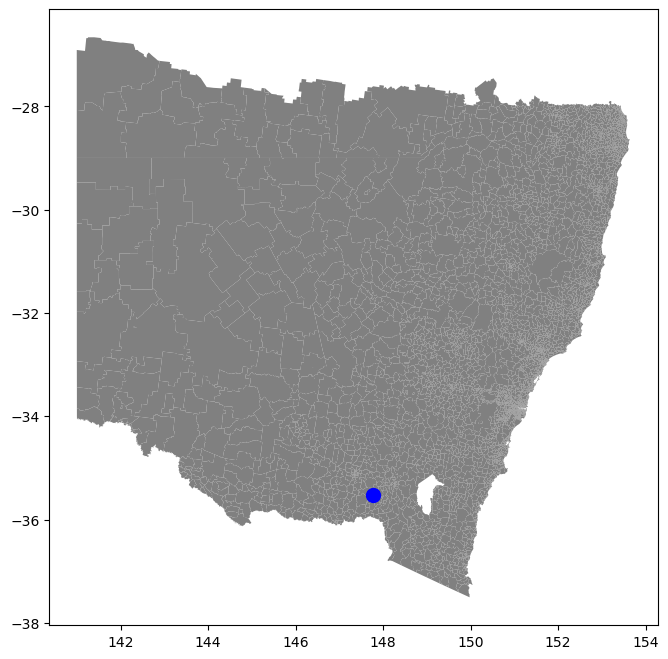

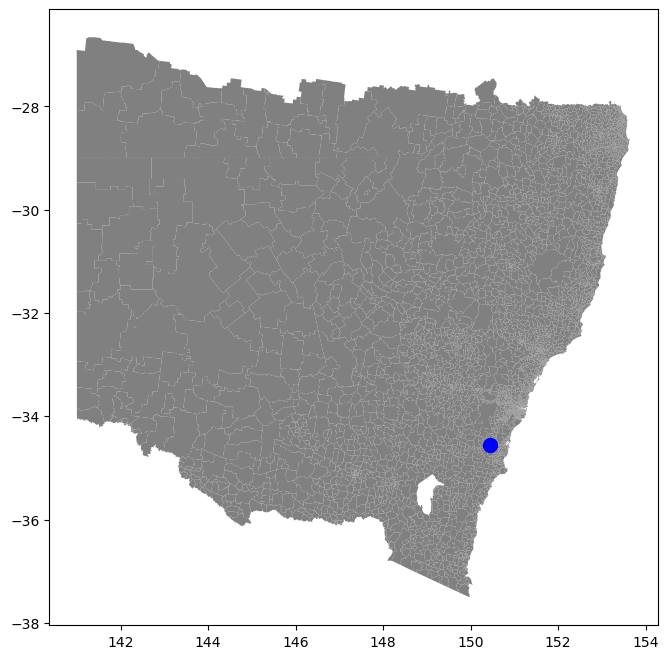

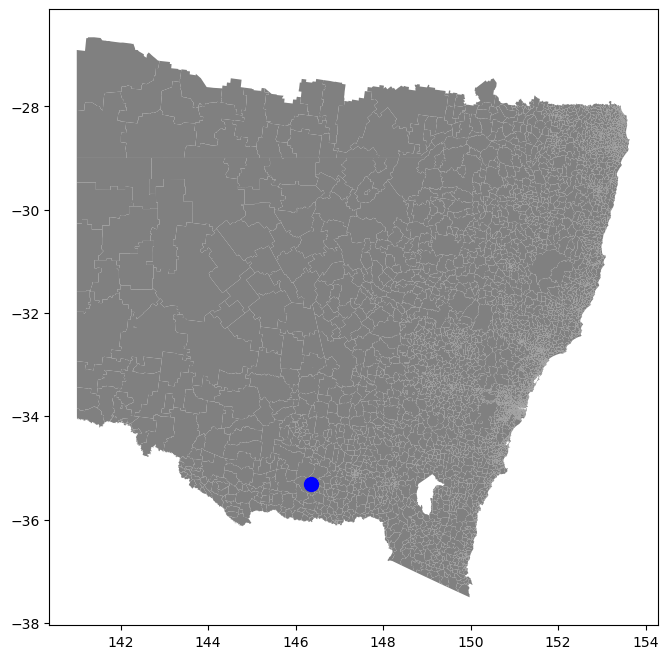

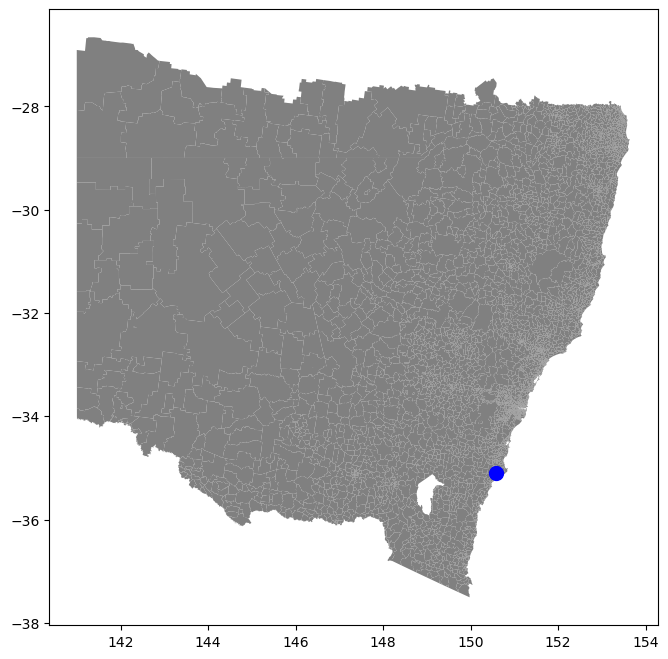

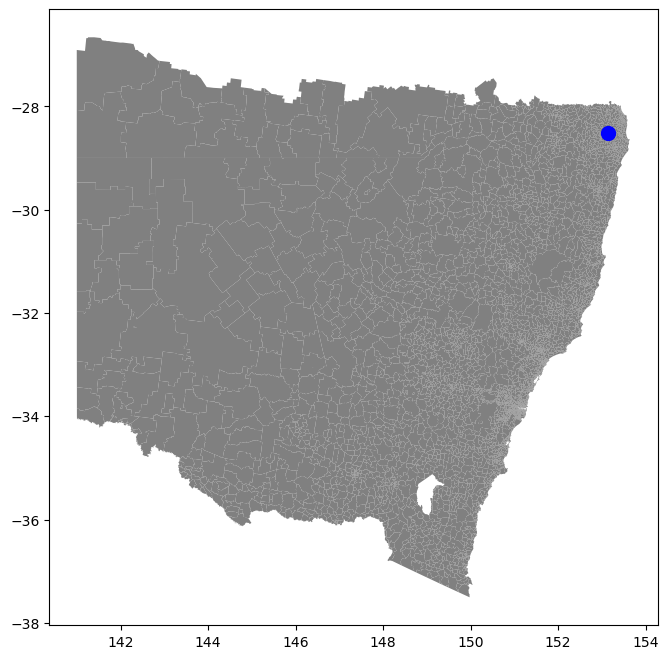

...

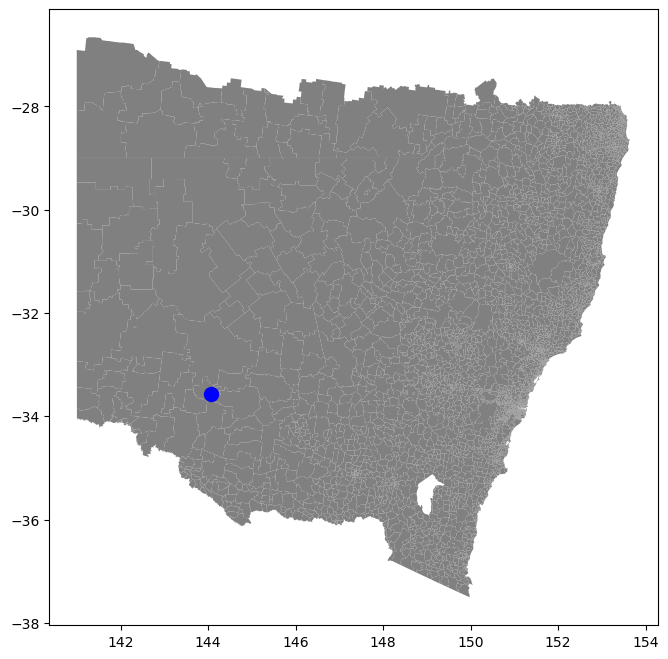

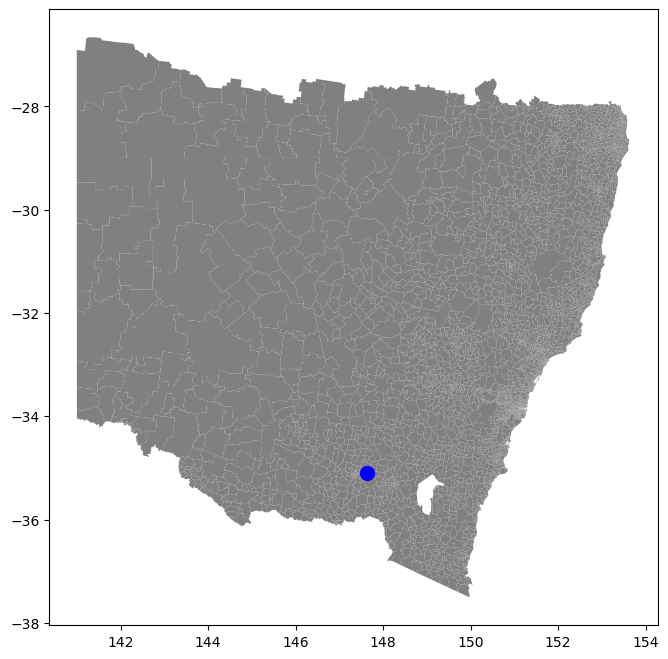

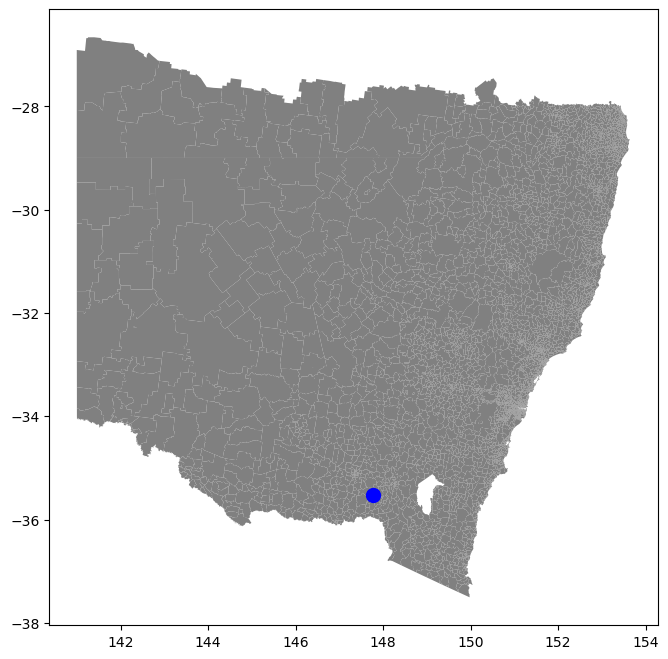

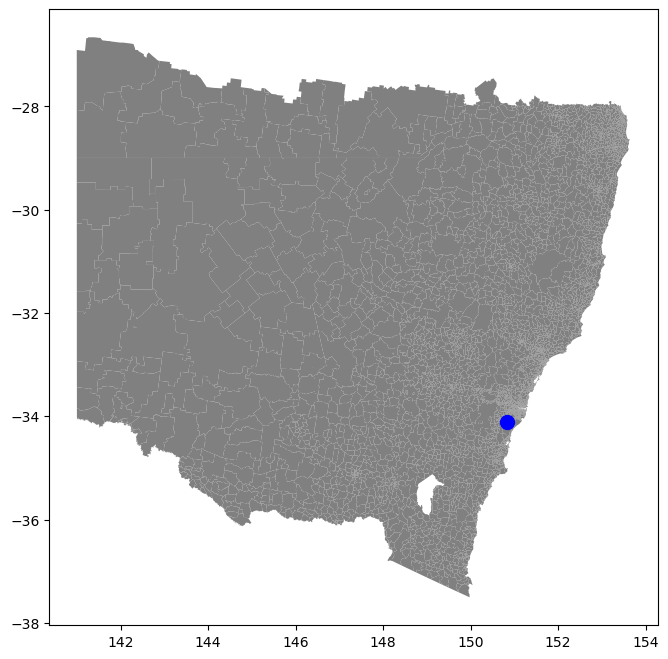

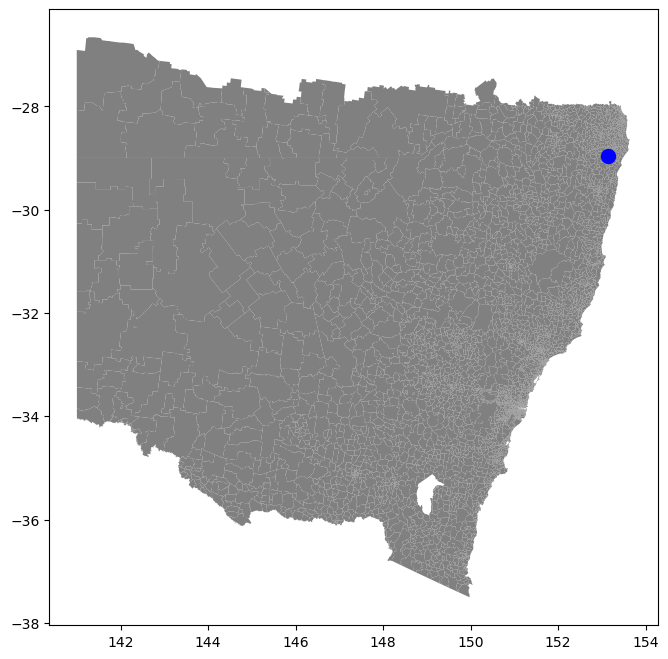

In [6]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
from scipy.stats import gaussian_kde
from scipy.ndimage.filters import maximum_filter
from scipy.spatial.distance import cdist
from sklearn.cluster import KMeans
from scipy.sparse.csgraph import minimum_spanning_tree
import os

# Define paths
excel_file_path = '/Users/coolkarni/Desktop/OneDrive - The University of Melbourne/R1_99_New Events.xlsx'
csv_directory = '/Users/coolkarni/Documents/Documents/Documents/Master thesis Data/BoM Station Dataset/Rainfall Stored values for R1_99 Events/'
output_directory = '/Users/coolkarni/Documents/Documents/Documents/Master thesis Data/BoM Station Dataset/Map_KDE_2Plots/'

# Load event names from the Excel file, skipping NaN values
event_df = pd.read_excel(excel_file_path,sheet_name='Sheet7')
event_names = event_df['Event'].dropna().unique()

# Initialize a list to store names of files that encountered errors
error_files = []

# Set distance threshold (e.g., in degrees, assuming coordinates are in lat/lon)
distance_threshold = 2  # Adjust as needed

# Haversine function to calculate distance between two lat/long coordinates
def haversine(lon1, lat1, lon2, lat2):
    lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    c = 2 * np.arcsin(np.sqrt(a))
    r = 6371  # Radius of earth in kilometers
    return c * r

# Function to find the mean rainfall value of the 5 nearest stations
def find_nearest_stations_mean_rainfall(df, lon, lat, column):
    df['distance'] = df.apply(lambda row: haversine(lon, lat, row['Longitude'], row['Latitude']), axis=1)
    nearest_stations = df.nsmallest(5, 'distance')
    mean_rainfall = nearest_stations[column].mean()
    return mean_rainfall

# Function to connect points within each cluster using Minimum Spanning Tree
def connect_points_within_cluster(points, ax, color):
    if len(points) < 2:
        return
    # Compute the distance matrix
    distance_matrix = cdist(points, points)
    # Compute the MST using the distance matrix
    mst = minimum_spanning_tree(distance_matrix).toarray()
    # Plot the MST
    for i in range(len(points)):
        for j in range(len(points)):
                if mst[i, j] > 0:
                    ax.plot([points[i][0], points[j][0]], [points[i][1], points[j][1]], linestyle='-', color=color, alpha=0.5)

# Process each event
for event_name in event_names:
    # Construct the path to the corresponding CSV file
    csv_file = os.path.join(csv_directory, f"{event_name}.csv")
    
    try:
        # Load the CSV file
        df = pd.read_csv(csv_file)

        # Filter out NaN values in latitude and longitude
        x_cleaned = df[['Latitude', 'Longitude'] + [col for col in df.columns if col.startswith('Rainfall')]].dropna()

        # Read the shapefile (assuming you have this in your directory)
        shapefile_path = '/Users/coolkarni/Documents/Documents/Documents/Master thesis Data/combined_shapefile.shp'
        gdf = gpd.read_file(shapefile_path)

        # Create a grid of points within the bounds of the shapefile
        minx, miny, maxx, maxy = gdf.total_bounds
        xi, yi = np.meshgrid(np.linspace(minx, maxx, 100), np.linspace(miny, maxy, 100))
        positions = np.vstack([xi.ravel(), yi.ravel()])

        # Initialize lists to store coordinates of maxima and their annotations
        global_maxima_coords = []
        filtered_maxima_coords = []
        annotations = []

        # Iterate through each rainfall column and generate plots
        rainfall_columns = [col for col in x_cleaned.columns if col.startswith('Rainfall')]

        for idx, col in enumerate(rainfall_columns, start=1):
            rainfall = x_cleaned[col]

            # Perform Gaussian KDE on the rainfall data
            values = np.vstack([x_cleaned['Longitude'], x_cleaned['Latitude']])
            kde = gaussian_kde(values, weights=rainfall, bw_method='scott')
            zi = kde(positions).reshape(xi.shape)

            # Mask the grid to include only points inside the shapefile geometry
            points = np.vstack((xi.flatten(), yi.flatten())).T
            mask = np.array([gdf.contains(Point(point)).any() for point in points])
            mask = mask.reshape(xi.shape)
            zi = np.where(mask, zi, np.nan)

            # Find global maximum
            global_max_value = np.nanmax(zi)
            global_max_index = np.unravel_index(np.nanargmax(zi), zi.shape)
            global_max_x = xi[global_max_index]
            global_max_y = yi[global_max_index]

            # Find local maxima (peaks)
            local_max = maximum_filter(zi, size=10) == zi
            peaks = np.where(local_max, zi, np.nan)

            # Calculate 50th percentile value of global maximum
            percentile_90 = 0.5 * global_max_value

            # Remove peaks not within 90th percentile of global maximum
            peaks_filtered = np.where(peaks >= percentile_90, peaks, np.nan)

            # Calculate distances from global maximum to each local maximum
            local_max_coords = np.array(list(zip(xi[np.isfinite(peaks_filtered)], yi[np.isfinite(peaks_filtered)])))
            global_max_coords = np.array([[global_max_x, global_max_y]])
            
            # Check if there are any local maxima
            if local_max_coords.shape[0] > 0:
               # Calculate distances from global maximum to each local maximum
               distances = cdist(global_max_coords, local_max_coords)[0]

               # Apply distance threshold to filter out local maxima too close to the global maximum
               valid_indices = distances > distance_threshold
               filtered_peaks_coords = local_max_coords[valid_indices]
               filtered_peaks_values = peaks_filtered[np.isfinite(peaks_filtered)][valid_indices]

               # Proceed with processing filtered peaks...
               for i, (x, y) in enumerate(filtered_peaks_coords, start=1):
                    local_max_rainfall_mean = find_nearest_stations_mean_rainfall(x_cleaned, x, y, col)
                    if local_max_rainfall_mean >= 25.0:
                         filtered_maxima_coords.append((x, y))
                         annotations.append((x, y, f'{idx}'))
            else:
              # No local maxima found, skip this chunk
              print("No local maxima found, skipping filtering.")

            # Find mean rainfall value at the global maximum
            global_max_rainfall_mean = find_nearest_stations_mean_rainfall(x_cleaned, global_max_x, global_max_y, col)

            # Check if global maxima exceeds 25.00 mm threshold
            if global_max_rainfall_mean >= 25.00:
                global_maxima_coords.append((global_max_x, global_max_y))
                annotations.append((global_max_x, global_max_y, f'{idx}'))

                # Store filtered local maxima (peaks) that also exceed 25.00 mm threshold
                for i, (x, y) in enumerate(filtered_peaks_coords, start=1):
                    local_max_rainfall_mean = find_nearest_stations_mean_rainfall(x_cleaned, x, y, col)
                    if local_max_rainfall_mean >= 25.0:
                        filtered_maxima_coords.append((x, y))
                        annotations.append((x, y, f'{idx}'))
            else:
                # If global maxima don't exceed threshold, but some local maxima do, plot those
                for i, (x, y) in enumerate(filtered_peaks_coords, start=1):
                    local_max_rainfall_mean = find_nearest_stations_mean_rainfall(x_cleaned, x, y, col)
                    if local_max_rainfall_mean >= 25.0:
                        filtered_maxima_coords.append((x, y))
                        annotations.append((x, y, f'{idx}'))

        # Combine global and filtered local maxima coordinates
        all_maxima_coords = np.array(global_maxima_coords + filtered_maxima_coords)

        # Define a small deviation threshold (in degrees)
        deviation_threshold = 0.05  # Adjust as needed

        # Divide the map into longitude sections and count points in each section
        long_sections = [140, 144, 148, 154]  # Define longitude section boundaries
        section_counts = [0] * (len(long_sections) - 1)
        
        # Set to store unique points that are counted
        counted_points = set()

        for lon, lat in all_maxima_coords:
           for i in range(len(long_sections) - 1):
            # Check if the point is within the section range
               if long_sections[i] - deviation_threshold < lon < long_sections[i + 1] + deviation_threshold:
                   # Use tuple of coordinates to track unique points
                   counted_points.add((lon, lat))
                   section_counts[i] += 1

        # Check if at least two sections satisfy the criteria
        point_threshold = 1
        satisfying_sections = sum(count > point_threshold for count in section_counts)
        perform_clustering = satisfying_sections >= 2

        if perform_clustering:
            # Perform K-means clustering with 2 clusters as a default
            kmeans = KMeans(n_clusters=2, random_state=0)
            cluster_labels = kmeans.fit_predict(all_maxima_coords)

            # Initialize dictionaries to store points for each cluster
            clusters = {label: [] for label in set(cluster_labels)}

            # Sort points into their respective clusters
            for label, point in zip(cluster_labels, all_maxima_coords):
                clusters[label].append(point)

            # Plotting code
            fig, ax = plt.subplots(figsize=(10, 8))
            gdf.plot(ax=ax, color='gray', edgecolor='none')
            
            # Connect points within the cluster using MST
            connect_points_within_cluster(cluster_points, ax, color)


            
            # Plot points and lines for each cluster
            for label in clusters:
                cluster_points = clusters[label]

                # Choose a color based on the cluster label
                color = 'red' if label == 0 else 'blue'

                # Plot points
                for x, y in cluster_points:
                    ax.plot(x, y, marker='o', color=color, markersize=10)

                # Connect points within the cluster using MST
                connect_points_within_cluster(cluster_points, ax, color)

        else:
            # If no meaningful clusters are found, plot the maxima without clustering
            fig, ax = plt.subplots(figsize=(10, 8))
            gdf.plot(ax=ax, color='gray', edgecolor='none')

            # Plot points for maxima
            for i, (x, y) in enumerate(all_maxima_coords):
               ax.plot(x, y, marker='o', color='blue', markersize=10)

            # Connect points within the maxima using MST
            connect_points_within_cluster(all_maxima_coords, ax, 'blue')

        # If there's only one maxima point, just plot it
        if len(all_maxima_coords) == 1:
           fig, ax = plt.subplots(figsize=(10, 8))
           gdf.plot(ax=ax, color='gray', edgecolor='none')
           for x, y in all_maxima_coords:
               ax.plot(x, y, marker='o', color='blue', markersize=10)

        # Annotate points with numbers
        for x, y, label in annotations:
            ax.text(x, y, label, fontsize=10, ha='center', va='bottom', color='black', weight='bold')

        # Set labels and title
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
        ax.set_title(f'{event_name}')

        # Save the output plot
        plt.savefig(os.path.join(output_directory, f"{event_name}_output.png"))
        plt.close()

    except Exception as e:
        # Append the event name to the error files list
        error_files.append(event_name)
        print(f"Error processing {event_name}: {e}")

# If there are any error files, save them to the new sheet in the existing Excel file
if error_files:
    # Load the existing data from the specified sheet
    try:
        existing_df = pd.read_excel(excel_file_path, sheet_name='IDW', engine='openpyxl')
    except ValueError:
        # If the sheet doesn't exist, create an empty DataFrame
        existing_df = pd.DataFrame()

    # Create a DataFrame for the new error files
    new_errors_df = pd.DataFrame({'Error Files': error_files})

    # Concatenate the existing data with the new error data
    combined_df = pd.concat([existing_df, new_errors_df], ignore_index=True)

    # Save the combined DataFrame back to the same sheet
    with pd.ExcelWriter(excel_file_path, mode='a', engine='openpyxl') as writer:
        combined_df.to_excel(writer, sheet_name='IDW', index=False)
print("Processing complete. Check the output directory for results and the Excel file for any errors.")


No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local ma

/var/folders/1_/_3k8kb7n5vz43s2kfx69bp0c0000gn/T/ipykernel_1891/185277104.py:243: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 8))


No local maxima found, skipping filtering.


/var/folders/1_/_3k8kb7n5vz43s2kfx69bp0c0000gn/T/ipykernel_1891/185277104.py:231: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 8))
/var/folders/1_/_3k8kb7n5vz43s2kfx69bp0c0000gn/T/ipykernel_1891/185277104.py:231: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 8))
/var/folders/1_/_3k8kb7n5vz43s2kfx69bp0c0000gn/T/ipykernel_1891/185277104.py:212: RuntimeWarning: More than 20 figures have be

No local maxima found, skipping filtering.
No local maxima found, skipping filtering.


/var/folders/1_/_3k8kb7n5vz43s2kfx69bp0c0000gn/T/ipykernel_1891/185277104.py:231: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 8))


No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local ma

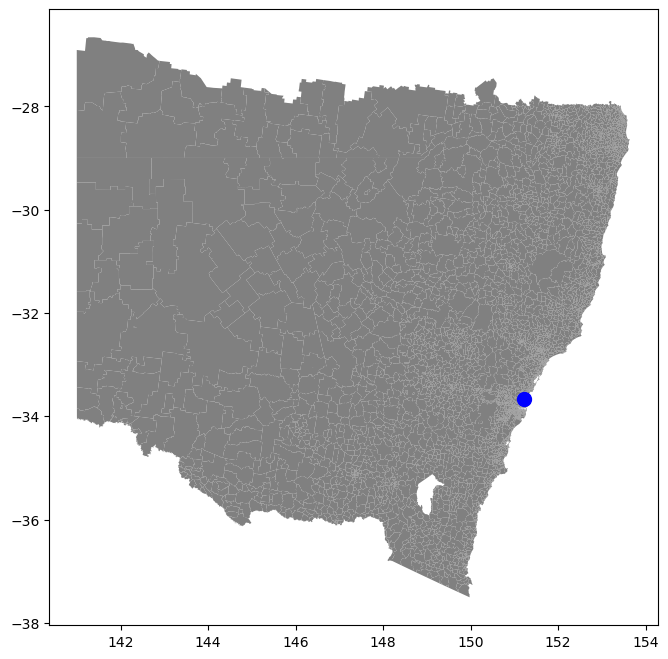

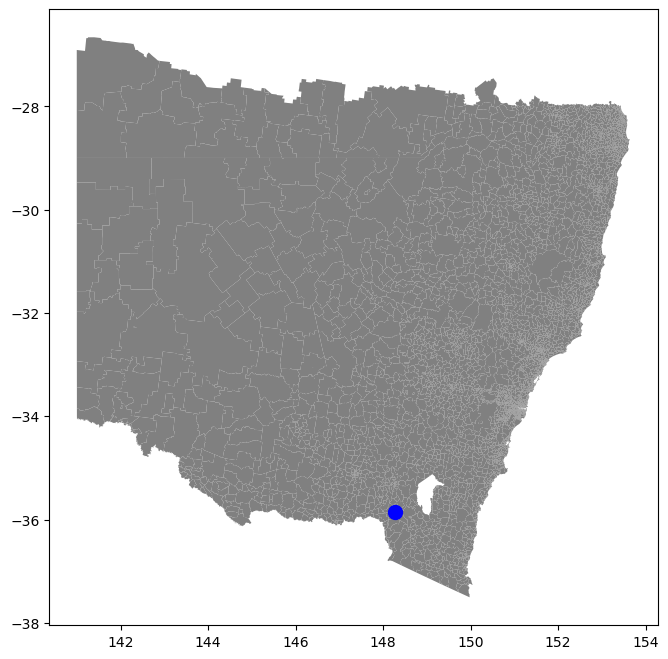

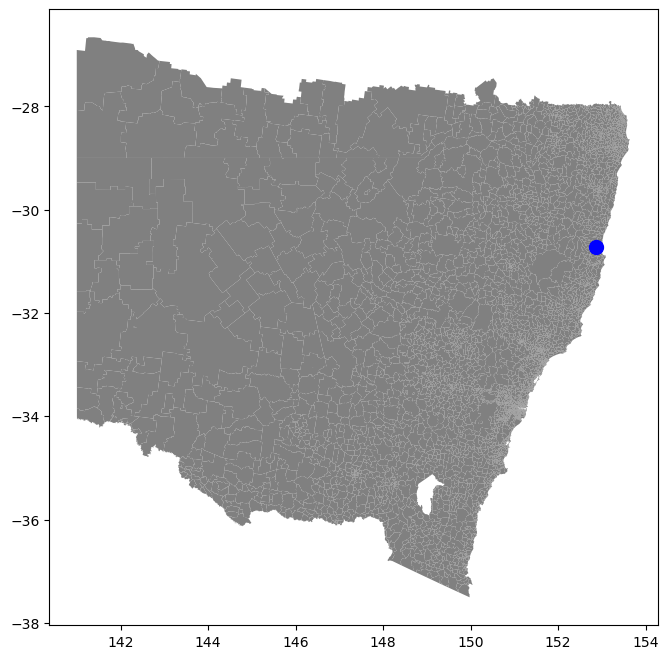

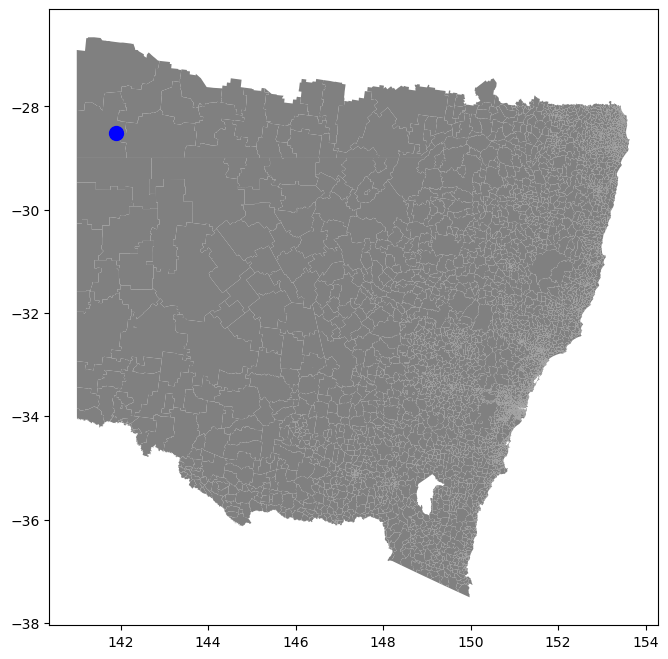

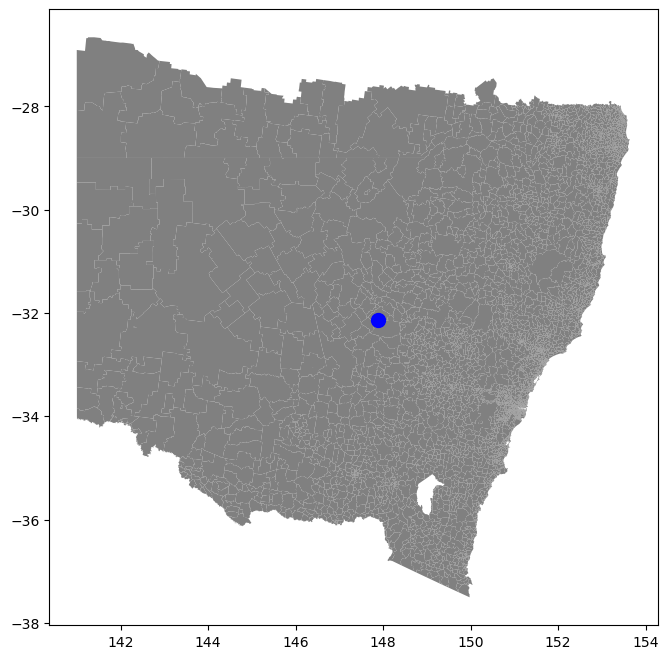

...

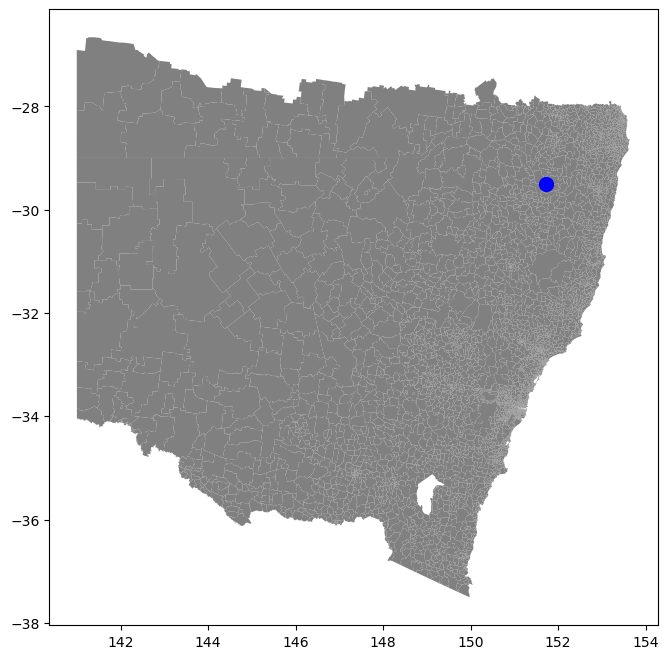

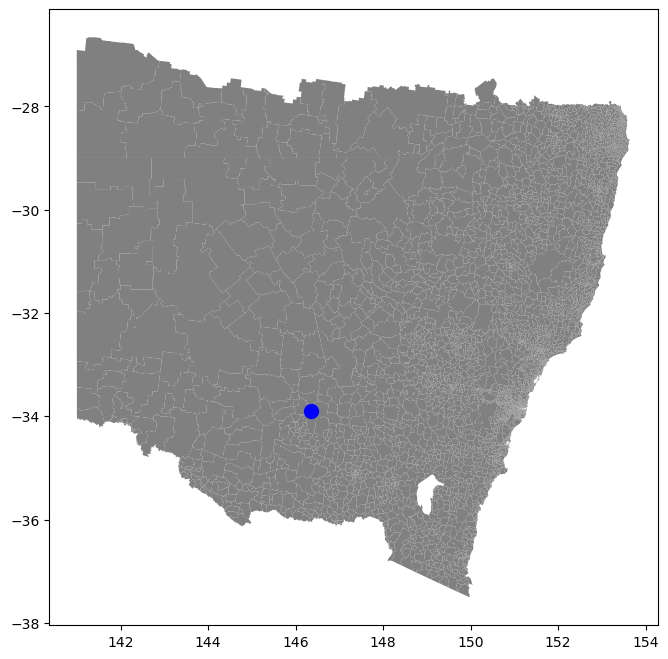

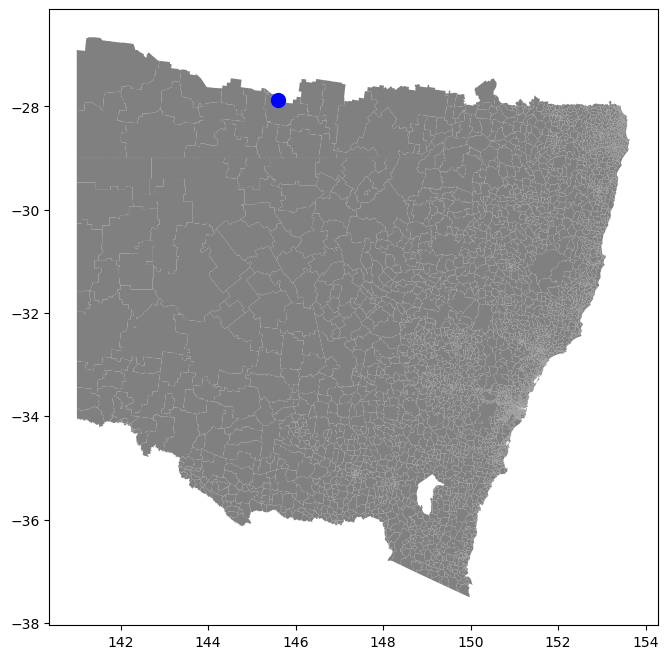

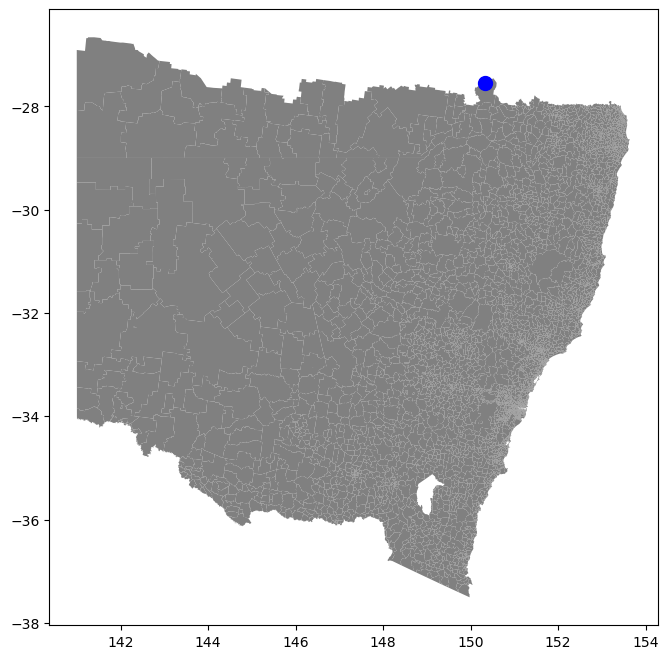

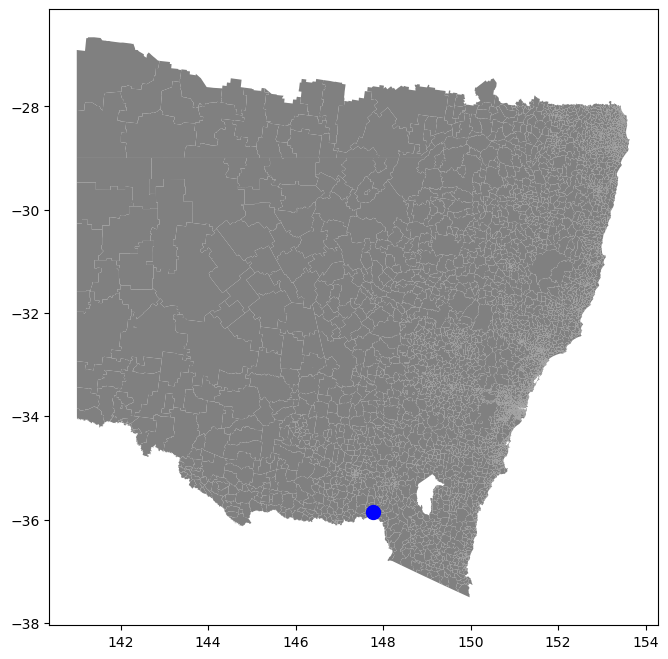

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
from scipy.spatial.distance import cdist
from sklearn.cluster import KMeans
from scipy.ndimage import gaussian_filter,maximum_filter
from scipy.sparse.csgraph import minimum_spanning_tree
import os

# Define paths
excel_file_path = '/Users/coolkarni/Desktop/OneDrive - The University of Melbourne/R1_99_New Events.xlsx'
csv_directory = '/Users/coolkarni/Documents/Documents/Documents/Master thesis Data/BoM Station Dataset/Rainfall Stored values for R1_99 Events/'
output_directory = '/Users/coolkarni/Documents/Documents/Documents/Master thesis Data/BoM Station Dataset/Map_IDW_2Plots/'

# Load event names from the Excel file, skipping NaN values
event_df = pd.read_excel(excel_file_path, sheet_name='Sheet6')
event_names = event_df['Event'].dropna().unique()

# Initialize a list to store names of files that encountered errors
error_files = []

# Set distance threshold (e.g., in degrees, assuming coordinates are in lat/lon)
distance_threshold = 2  # Adjust as needed

# Haversine function to calculate distance between two lat/long coordinates
def haversine(lon1, lat1, lon2, lat2):
    lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    c = 2 * np.arcsin(np.sqrt(a))
    r = 6371  # Radius of earth in kilometers
    return c * r

# Function to find the mean rainfall value of the 5 nearest stations
def find_nearest_stations_mean_rainfall(df, lon, lat, column):
    df['distance'] = df.apply(lambda row: haversine(lon, lat, row['Longitude'], row['Latitude']), axis=1)
    nearest_stations = df.nsmallest(5, 'distance')
    mean_rainfall = nearest_stations[column].mean()
    return mean_rainfall

# Function to perform IDW interpolation
def perform_idw(latitude, longitude, rainfall):
    try:
        # Create a grid for interpolation
        xi, yi = np.meshgrid(np.linspace(min(longitude), max(longitude), 100),
                             np.linspace(min(latitude), max(latitude), 100))
        zi = np.zeros_like(xi)

        for i in range(len(xi)):
            for j in range(len(yi)):
                distances = np.sqrt((longitude.values - xi[i, j])**2 + (latitude.values - yi[i, j])**2)
                weights = 1 / (distances + 1e-6)  # Avoid division by zero
                zi[i, j] = np.sum(weights * rainfall.values) / np.sum(weights)

        zi_smoothed = gaussian_filter(zi, sigma=2)
        return zi_smoothed, None
    except Exception as e:
        return None, str(e)

# Function to connect points within each cluster using Minimum Spanning Tree
def connect_points_within_cluster(points, ax, color):
    if len(points) < 2:
        return
    # Compute the distance matrix
    distance_matrix = cdist(points, points)
    # Compute the MST using the distance matrix
    mst = minimum_spanning_tree(distance_matrix).toarray()
    # Plot the MST
    for i in range(len(points)):
        for j in range(len(points)):
            if mst[i, j] > 0:
                ax.plot([points[i][0], points[j][0]], [points[i][1], points[j][1]], linestyle='-', color=color, alpha=0.5)

# Process each event
for event_name in event_names:
    # Construct the path to the corresponding CSV file
    csv_file = os.path.join(csv_directory, f"{event_name}.csv")
    
    try:
        # Load the CSV file
        df = pd.read_csv(csv_file)

        # Filter out NaN values in latitude and longitude
        x_cleaned = df[['Latitude', 'Longitude'] + [col for col in df.columns if col.startswith('Rainfall')]].dropna()

        # Read the shapefile (assuming you have this in your directory)
        shapefile_path = '/Users/coolkarni/Documents/Documents/Documents/Master thesis Data/combined_shapefile.shp'
        gdf = gpd.read_file(shapefile_path)

        # Create a grid of points within the bounds of the shapefile
        minx, miny, maxx, maxy = gdf.total_bounds
        xi, yi = np.meshgrid(np.linspace(minx, maxx, 100), np.linspace(miny, maxy, 100))
        positions = np.vstack([xi.ravel(), yi.ravel()])

        # Initialize lists to store coordinates of maxima and their annotations
        global_maxima_coords = []
        filtered_maxima_coords = []
        annotations = []

        # Iterate through each rainfall column and generate plots
        rainfall_columns = [col for col in x_cleaned.columns if col.startswith('Rainfall')]

        for idx, col in enumerate(rainfall_columns, start=1):
            rainfall = x_cleaned[col]

            # Perform IDW interpolation
            zi, _ = perform_idw(x_cleaned['Latitude'], x_cleaned['Longitude'], rainfall)

            # Mask the grid to include only points inside the shapefile geometry
            points = np.vstack((xi.flatten(), yi.flatten())).T
            mask = np.array([gdf.contains(Point(point)).any() for point in points])
            mask = mask.reshape(xi.shape)
            zi = np.where(mask, zi, np.nan)

            # Find global maximum
            global_max_value = np.nanmax(zi)
            global_max_index = np.unravel_index(np.nanargmax(zi), zi.shape)
            global_max_x = xi[global_max_index]
            global_max_y = yi[global_max_index]

            # Find local maxima (peaks)
            local_max = maximum_filter(zi, size=10) == zi
            peaks = np.where(local_max, zi, np.nan)

            # Calculate 50th percentile value of global maximum
            percentile_90 = 0.9 * global_max_value

            # Remove peaks not within 90th percentile of global maximum
            peaks_filtered = np.where(peaks >= percentile_90, peaks, np.nan)

            # Calculate distances from global maximum to each local maximum
            local_max_coords = np.array(list(zip(xi[np.isfinite(peaks_filtered)], yi[np.isfinite(peaks_filtered)])))
            global_max_coords = np.array([[global_max_x, global_max_y]])
            
            # Check if there are any local maxima
            if local_max_coords.shape[0] > 0:
                # Calculate distances from global maximum to each local maximum
                distances = cdist(global_max_coords, local_max_coords)[0]

                # Apply distance threshold to filter out local maxima too close to the global maximum
                valid_indices = distances > distance_threshold
                filtered_peaks_coords = local_max_coords[valid_indices]
                filtered_peaks_values = peaks_filtered[np.isfinite(peaks_filtered)][valid_indices]

                # Proceed with processing filtered peaks...
                for i, (x, y) in enumerate(filtered_peaks_coords, start=1):
                    local_max_rainfall_mean = find_nearest_stations_mean_rainfall(x_cleaned, x, y, col)
                    if local_max_rainfall_mean >= 25.0:
                        filtered_maxima_coords.append((x, y))
                        annotations.append((x, y, f'{idx}'))
            else:
                print("No local maxima found, skipping filtering.")

            # Find mean rainfall value at the global maximum
            global_max_rainfall_mean = find_nearest_stations_mean_rainfall(x_cleaned, global_max_x, global_max_y, col)

            # Check if global maxima exceeds 25.00 mm threshold
            if global_max_rainfall_mean >= 25.00:
                global_maxima_coords.append((global_max_x, global_max_y))
                annotations.append((global_max_x, global_max_y, f'{idx}'))

                # Store filtered local maxima (peaks) that also exceed 25.00 mm threshold
                for i, (x, y) in enumerate(filtered_peaks_coords, start=1):
                    local_max_rainfall_mean = find_nearest_stations_mean_rainfall(x_cleaned, x, y, col)
                    if local_max_rainfall_mean >= 25.0:
                        filtered_maxima_coords.append((x, y))
                        annotations.append((x, y, f'{idx}'))
            else:
                for i, (x, y) in enumerate(filtered_peaks_coords, start=1):
                    local_max_rainfall_mean = find_nearest_stations_mean_rainfall(x_cleaned, x, y, col)
                    if local_max_rainfall_mean >= 25.0:
                        filtered_maxima_coords.append((x, y))
                        annotations.append((x, y, f'{idx}'))

        # Combine global and filtered local maxima coordinates
        all_maxima_coords = np.array(global_maxima_coords + filtered_maxima_coords)

        # Divide the map into longitude sections and count points in each section
        long_sections = [140, 144, 148, 154]  # Define longitude section boundaries
        section_counts = [0] * (len(long_sections) - 1)
        
        # Set to store unique points that are counted
        counted_points = set()

        for lon, lat in all_maxima_coords:
            for i in range(len(long_sections) - 1):
                if long_sections[i] - 0.05 < lon < long_sections[i + 1] + 0.05:
                    counted_points.add((lon, lat))
                    section_counts[i] += 1

        # Check if at least two sections satisfy the criteria
        point_threshold = 1
        satisfying_sections = sum(count > point_threshold for count in section_counts)
        perform_clustering = satisfying_sections >= 2

        if perform_clustering:
            # Perform K-means clustering with 2 clusters as a default
            kmeans = KMeans(n_clusters=2, random_state=0)
            cluster_labels = kmeans.fit_predict(all_maxima_coords)

            # Initialize dictionaries to store points for each cluster
            clusters = {label: [] for label in set(cluster_labels)}

            # Sort points into their respective clusters
            for label, point in zip(cluster_labels, all_maxima_coords):
                clusters[label].append(point)

            # Plotting code
            fig, ax = plt.subplots(figsize=(10, 8))
            gdf.plot(ax=ax, color='gray', edgecolor='none')

            # Connect points within the cluster using MST
            for label in clusters:
                cluster_points = clusters[label]

                # Choose a color based on the cluster label
                color = 'red' if label == 0 else 'blue'

                # Plot points
                for x, y in cluster_points:
                    ax.plot(x, y, marker='o', color=color, markersize=10)

                # Connect points within the cluster using MST
                connect_points_within_cluster(cluster_points, ax, color)

        else:
            # If no meaningful clusters are found, plot the maxima without clustering
            fig, ax = plt.subplots(figsize=(10, 8))
            gdf.plot(ax=ax, color='gray', edgecolor='none')

            # Plot points for maxima
            for i, (x, y) in enumerate(all_maxima_coords):
                ax.plot(x, y, marker='o', color='blue', markersize=10)

            # Connect points within the maxima using MST
            connect_points_within_cluster(all_maxima_coords, ax, 'blue')

        # If there's only one maxima point, just plot it
        if len(all_maxima_coords) == 1:
            fig, ax = plt.subplots(figsize=(10, 8))
            gdf.plot(ax=ax, color='gray', edgecolor='none')
            for x, y in all_maxima_coords:
                ax.plot(x, y, marker='o', color='blue', markersize=10)

        # Annotate points with numbers
        for x, y, label in annotations:
            ax.text(x, y, label, fontsize=10, ha='center', va='bottom', color='black', weight='bold')

        # Set labels and title
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
        ax.set_title(f'{event_name}')

        # Save the output plot
        plt.savefig(os.path.join(output_directory, f"{event_name}_output.png"))
        plt.close()

    except Exception as e:
        # Append the event name to the error files list
        error_files.append(event_name)
        print(f"Error processing {event_name}: {e}")

# If there are any error files, save them to the new sheet in the existing Excel file
if error_files:
    # Load the existing data from the specified sheet
    try:
        existing_df = pd.read_excel(excel_file_path, sheet_name='IDW', engine='openpyxl')
    except ValueError:
        # If the sheet doesn't exist, create an empty DataFrame
        existing_df = pd.DataFrame()

    # Create a DataFrame for the new error files
    new_errors_df = pd.DataFrame({'Error Files': error_files})

    # Concatenate the existing data with the new error data
    combined_df = pd.concat([existing_df, new_errors_df], ignore_index=True)

    # Save the combined DataFrame back to the same sheet
    with pd.ExcelWriter(excel_file_path, mode='a', engine='openpyxl') as writer:
        combined_df.to_excel(writer, sheet_name='IDW', index=False)

print("Processing complete. Check the output directory for results and the Excel file for any errors.")


/var/folders/1_/_3k8kb7n5vz43s2kfx69bp0c0000gn/T/ipykernel_1891/3154438363.py:7: DeprecationWarning: Please import `maximum_filter` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  from scipy.ndimage.filters import maximum_filter


No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
Error processing Event 386 - 1858-10-01 to 1858-10-07: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


Error processing Event 387 - 1873-07-23 to 1873-07-29: array must not contain infs or NaNs
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)
/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 391 - 1868-07-17 to 1868-07-23: array must not contain infs or NaNs
Error processing Event 392 - 1869-11-18 to 1869-11-24: array must not contain infs or NaNs
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
Error processing Event 401 - 1892-05-16 to 1892-05-22: aweights cannot be negative


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


Error processing Event 403 - 1895-11-07 to 1895-11-13: array must not contain infs or NaNs
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
Error processing Event 413 - 1876-09-29 to 1876-10-05: array must not contain infs or NaNs


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
Error processing Event 447 - 1887-08-28 to 1887-09-03: aweights cannot be negative
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
Error processing Event 459 - 1895-12-27 to 1896-01-02: The data appears to lie in a lower-dimensional subspace of the space in which it is expr

/var/folders/1_/_3k8kb7n5vz43s2kfx69bp0c0000gn/T/ipykernel_1891/3154438363.py:232: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 8))
/var/folders/1_/_3k8kb7n5vz43s2kfx69bp0c0000gn/T/ipykernel_1891/3154438363.py:221: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 8))


No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
Error processing Event 479 - 1867-10-22 to 1867-10-28: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.
Error processing Event 480 - 1868-05-16 to 1868-05-22: array must not contain infs or NaNs


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
Error processing Event 482 - 1869-11-22 to 1869-11-28: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.
No local maxima found, skipping filtering.
Error processing Event 483 - 1870-06-01 to 1870-06-07: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.
Error pr

/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


Error processing Event 490 - 1871-12-08 to 1871-12-14: array must not contain infs or NaNs
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:583: RuntimeWarning: Degrees of freedom <= 0 for slice
  self._data_covariance = atleast_2d(cov(self.dataset, rowvar=1,
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/opt/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


Error processing Event 493 - 1873-08-14 to 1873-08-20: array must not contain infs or NaNs
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.


/opt/anaconda3/lib/python3.12/site-packages/scipy/stats/_kde.py:208: RuntimeWarning: invalid value encountered in divide
  self._weights /= sum(self._weights)


Error processing Event 496 - 1880-08-08 to 1880-08-14: array must not contain infs or NaNs
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
Error processing Event 504 - 1883-06-20 to 1883-06-26: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, ski

ValueError: Sheet 'IDW' already exists and if_sheet_exists is set to 'error'.

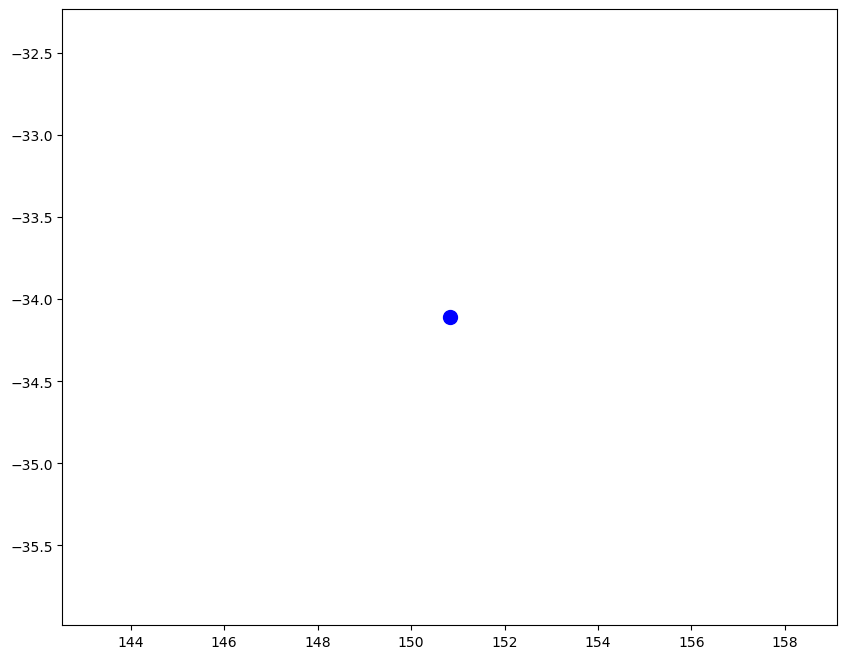

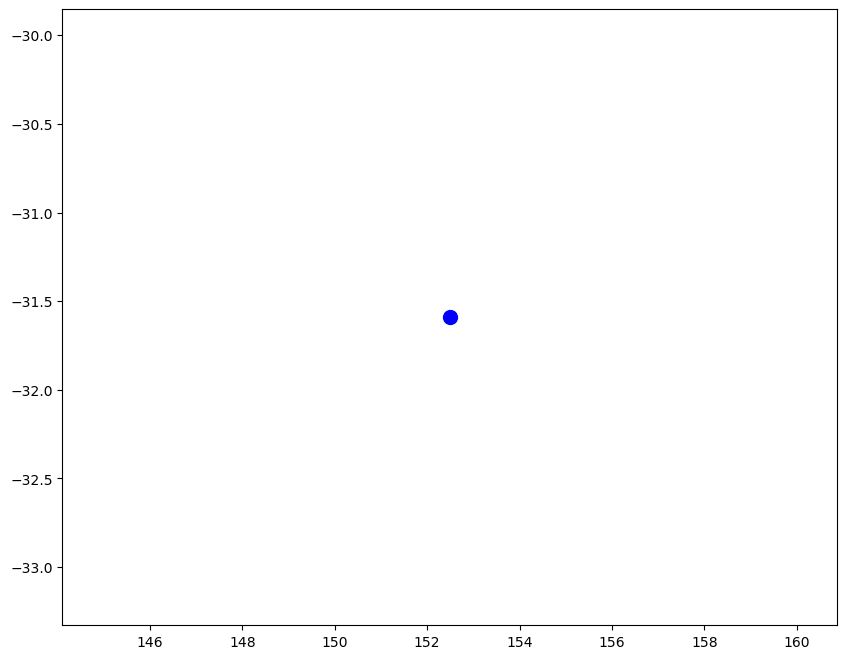

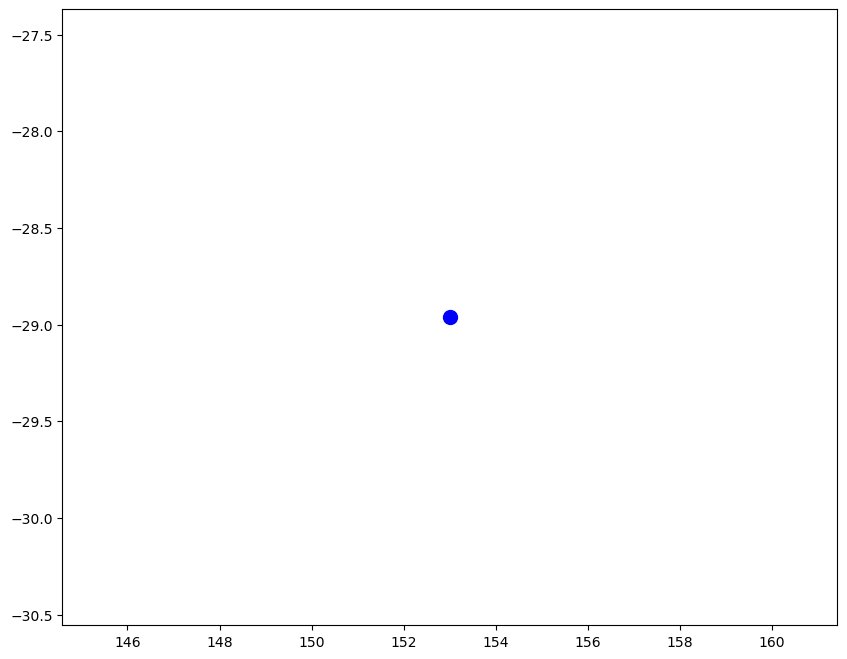

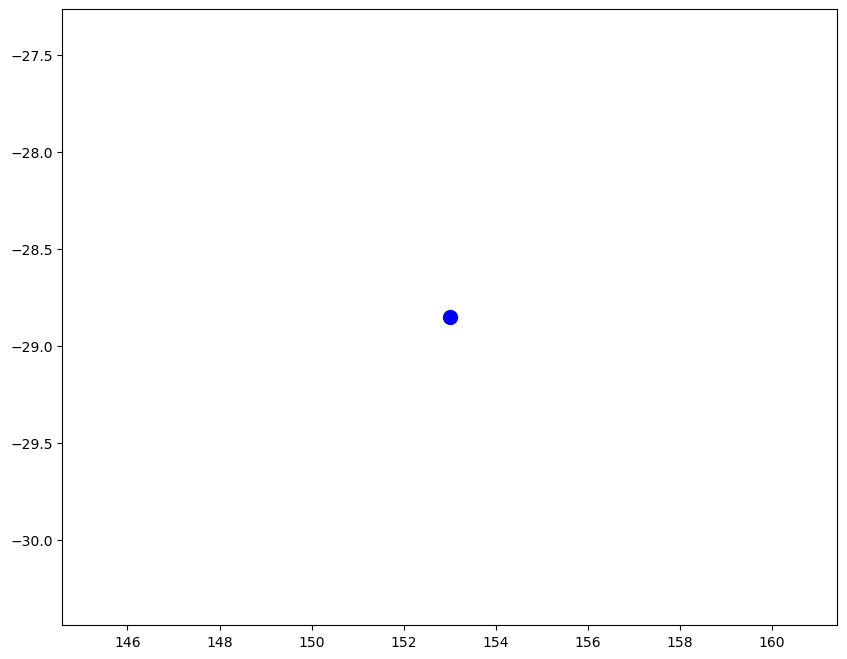

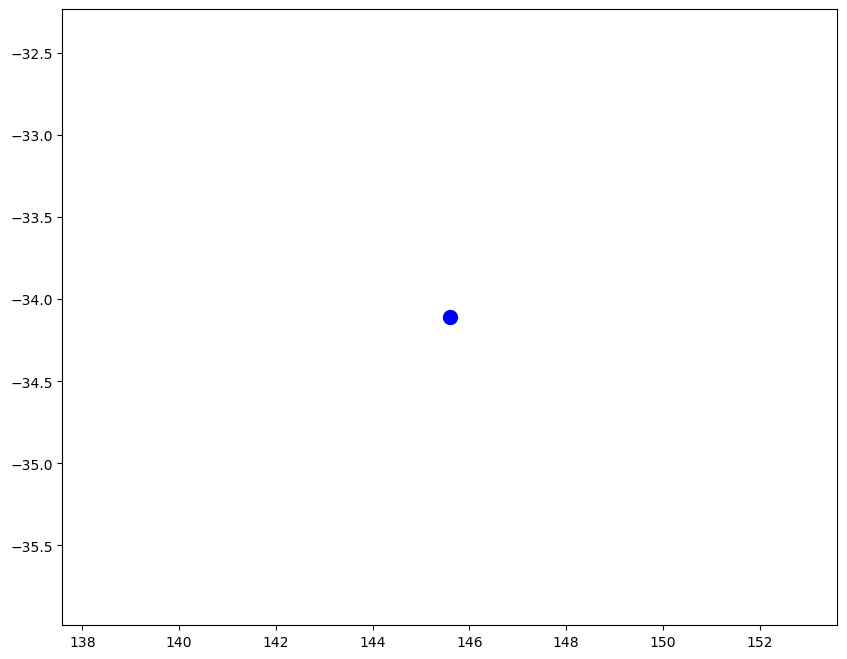

...

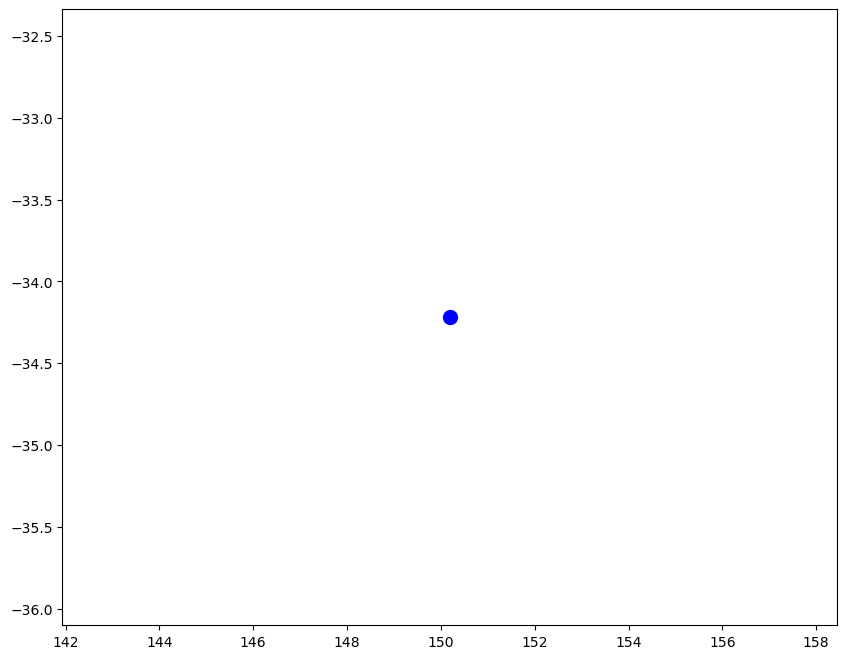

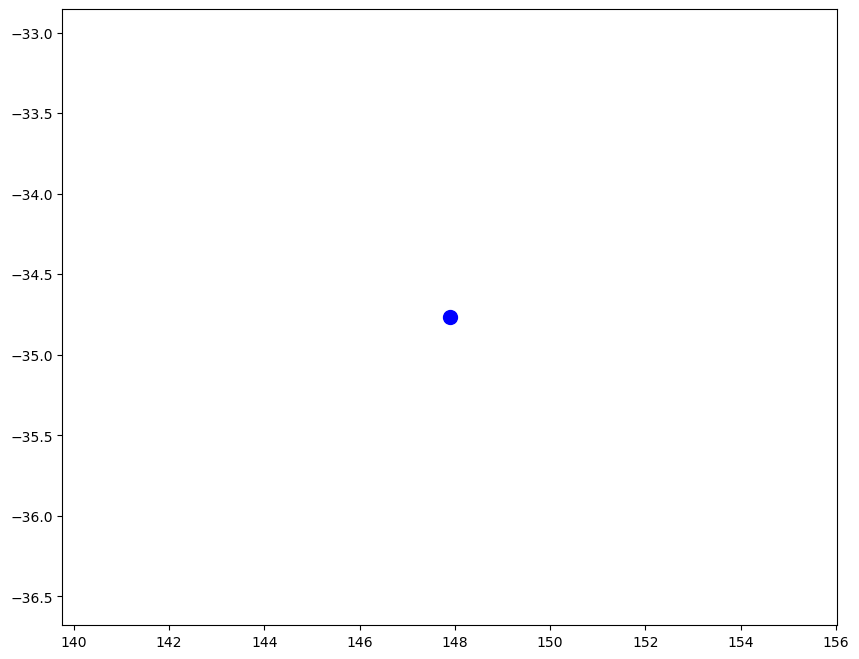

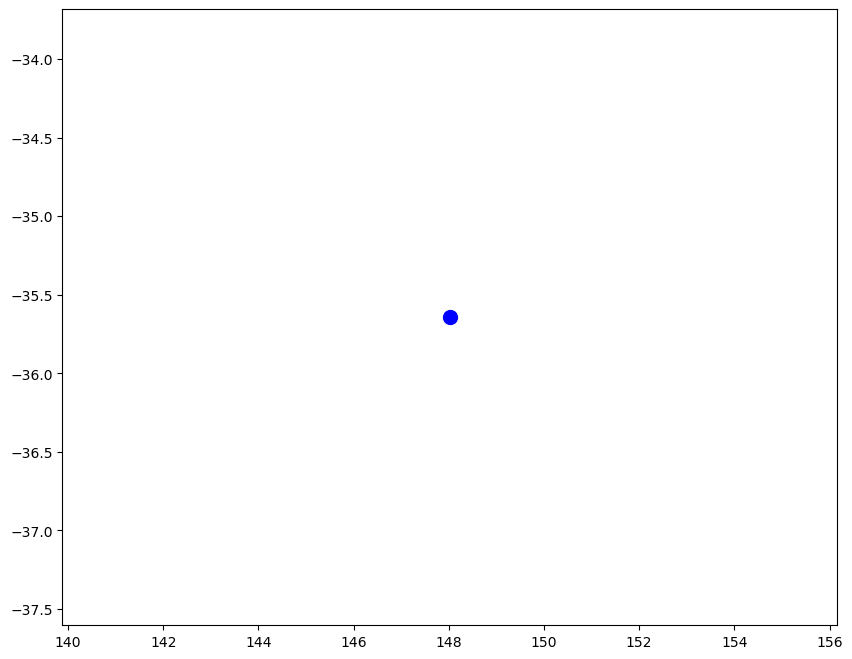

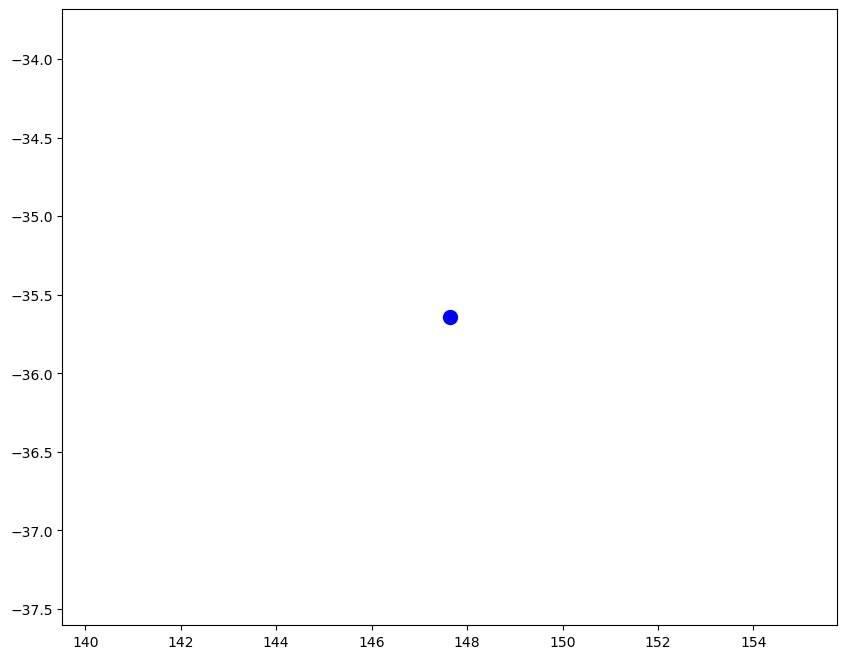

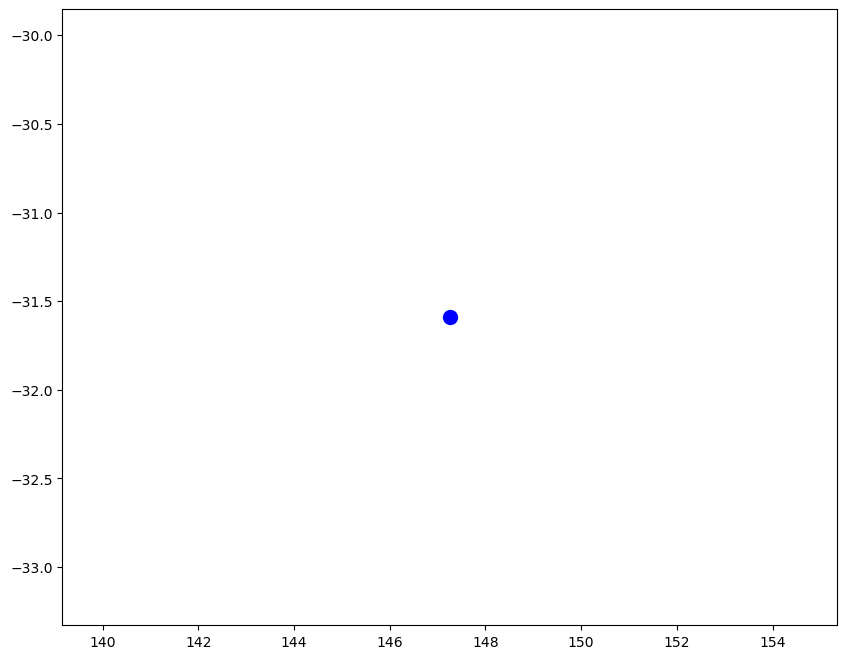

In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
from scipy.stats import gaussian_kde
from scipy.ndimage.filters import maximum_filter
from scipy.spatial.distance import cdist
from sklearn.cluster import KMeans
from scipy.sparse.csgraph import minimum_spanning_tree
import os

# Define paths
excel_file_path = '/Users/coolkarni/Desktop/OneDrive - The University of Melbourne/R1_99_New Events.xlsx'
csv_directory = '/Users/coolkarni/Documents/Documents/Documents/Master thesis Data/BoM Station Dataset/Rainfall Stored values for R1_99 Events/'
output_directory = '/Users/coolkarni/Documents/Documents/Documents/Master thesis Data/BoM Station Dataset/Map_KDE_3Plots/'

# Load event names from the Excel file, skipping NaN values
event_df = pd.read_excel(excel_file_path,sheet_name='Sheet4')
event_names = event_df['Event'].dropna().unique()

# Initialize a list to store names of files that encountered errors
error_files = []

# Set distance threshold (e.g., in degrees, assuming coordinates are in lat/lon)
distance_threshold = 2  # Adjust as needed

# Haversine function to calculate distance between two lat/long coordinates
def haversine(lon1, lat1, lon2, lat2):
    lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    c = 2 * np.arcsin(np.sqrt(a))
    r = 6371  # Radius of earth in kilometers
    return c * r

# Function to find the mean rainfall value of the 5 nearest stations
def find_nearest_stations_mean_rainfall(df, lon, lat, column):
    df['distance'] = df.apply(lambda row: haversine(lon, lat, row['Longitude'], row['Latitude']), axis=1)
    nearest_stations = df.nsmallest(5, 'distance')
    mean_rainfall = nearest_stations[column].mean()
    return mean_rainfall

# Process each event
for event_name in event_names:
    # Construct the path to the corresponding CSV file
    csv_file = os.path.join(csv_directory, f"{event_name}.csv")
    
    try:
        # Load the CSV file
        df = pd.read_csv(csv_file)

        # Filter out NaN values in latitude and longitude
        x_cleaned = df[['Latitude', 'Longitude'] + [col for col in df.columns if col.startswith('Rainfall')]].dropna()

        # Read the shapefile (assuming you have this in your directory)
        shapefile_path = '/Users/coolkarni/Documents/Documents/Documents/Master thesis Data/combined_shapefile.shp'
        gdf = gpd.read_file(shapefile_path)

        # Create a grid of points within the bounds of the shapefile
        minx, miny, maxx, maxy = gdf.total_bounds
        xi, yi = np.meshgrid(np.linspace(minx, maxx, 100), np.linspace(miny, maxy, 100))
        positions = np.vstack([xi.ravel(), yi.ravel()])

        # Initialize lists to store coordinates of maxima and their annotations
        global_maxima_coords = []
        filtered_maxima_coords = []
        annotations = []

        # Iterate through each rainfall column and generate plots
        rainfall_columns = [col for col in x_cleaned.columns if col.startswith('Rainfall')]

        for idx, col in enumerate(rainfall_columns, start=1):
            rainfall = x_cleaned[col]

            # Perform Gaussian KDE on the rainfall data
            values = np.vstack([x_cleaned['Longitude'], x_cleaned['Latitude']])
            kde = gaussian_kde(values, weights=rainfall, bw_method='scott')
            zi = kde(positions).reshape(xi.shape)

            # Mask the grid to include only points inside the shapefile geometry
            points = np.vstack((xi.flatten(), yi.flatten())).T
            mask = np.array([gdf.contains(Point(point)).any() for point in points])
            mask = mask.reshape(xi.shape)
            zi = np.where(mask, zi, np.nan)

            # Find global maximum
            global_max_value = np.nanmax(zi)
            global_max_index = np.unravel_index(np.nanargmax(zi), zi.shape)
            global_max_x = xi[global_max_index]
            global_max_y = yi[global_max_index]

            # Find local maxima (peaks)
            local_max = maximum_filter(zi, size=10) == zi
            peaks = np.where(local_max, zi, np.nan)

            # Calculate 50th percentile value of global maximum
            percentile_90 = 0.5 * global_max_value

            # Remove peaks not within 90th percentile of global maximum
            peaks_filtered = np.where(peaks >= percentile_90, peaks, np.nan)

            # Calculate distances from global maximum to each local maximum
            local_max_coords = np.array(list(zip(xi[np.isfinite(peaks_filtered)], yi[np.isfinite(peaks_filtered)])))
            global_max_coords = np.array([[global_max_x, global_max_y]])
            
            # Check if there are any local maxima
            if local_max_coords.shape[0] > 0:
               # Calculate distances from global maximum to each local maximum
               distances = cdist(global_max_coords, local_max_coords)[0]

               # Apply distance threshold to filter out local maxima too close to the global maximum
               valid_indices = distances > distance_threshold
               filtered_peaks_coords = local_max_coords[valid_indices]
               filtered_peaks_values = peaks_filtered[np.isfinite(peaks_filtered)][valid_indices]

               # Proceed with processing filtered peaks...
               for i, (x, y) in enumerate(filtered_peaks_coords, start=1):
                    local_max_rainfall_mean = find_nearest_stations_mean_rainfall(x_cleaned, x, y, col)
                    if local_max_rainfall_mean >= 25.0:
                         filtered_maxima_coords.append((x, y))
                         annotations.append((x, y, f'{idx}'))
            else:
              # No local maxima found, skip this chunk
              print("No local maxima found, skipping filtering.")

            # Find mean rainfall value at the global maximum
            global_max_rainfall_mean = find_nearest_stations_mean_rainfall(x_cleaned, global_max_x, global_max_y, col)

            # Check if global maxima exceeds 25.00 mm threshold
            if global_max_rainfall_mean >= 25.00:
                global_maxima_coords.append((global_max_x, global_max_y))
                annotations.append((global_max_x, global_max_y, f'{idx}'))

                # Store filtered local maxima (peaks) that also exceed 25.00 mm threshold
                for i, (x, y) in enumerate(filtered_peaks_coords, start=1):
                    local_max_rainfall_mean = find_nearest_stations_mean_rainfall(x_cleaned, x, y, col)
                    if local_max_rainfall_mean >= 25.0:
                        filtered_maxima_coords.append((x, y))
                        annotations.append((x, y, f'{idx}'))
            else:
                # If global maxima don't exceed threshold, but some local maxima do, plot those
                for i, (x, y) in enumerate(filtered_peaks_coords, start=1):
                    local_max_rainfall_mean = find_nearest_stations_mean_rainfall(x_cleaned, x, y, col)
                    if local_max_rainfall_mean >= 25.0:
                        filtered_maxima_coords.append((x, y))
                        annotations.append((x, y, f'{idx}'))

        # Combine global and filtered local maxima coordinates
        all_maxima_coords = np.array(global_maxima_coords + filtered_maxima_coords)

        # Define a small deviation threshold (in degrees)
        deviation_threshold = 0.05  # Adjust as needed

        # Divide the map into longitude sections and count points in each section
        long_sections = [140, 144, 148, 154]  # Define longitude section boundaries
        section_counts = [0] * (len(long_sections) - 1)
        
        # Set to store unique points that are counted
        counted_points = set()

        for lon, lat in all_maxima_coords:
           for i in range(len(long_sections) - 1):
            # Check if the point is within the section range
               if long_sections[i] - deviation_threshold < lon < long_sections[i + 1] + deviation_threshold:
                   # Use tuple of coordinates to track unique points
                   counted_points.add((lon, lat))
                   section_counts[i] += 1

        # Check if at least two sections satisfy the criteria
        point_threshold = 1
        satisfying_sections = sum(count > point_threshold for count in section_counts)
        perform_clustering = satisfying_sections >= 2

        if perform_clustering:
            # Perform K-means clustering with 2 clusters as a default
            kmeans = KMeans(n_clusters=2, random_state=0)
            cluster_labels = kmeans.fit_predict(all_maxima_coords)

            # Initialize dictionaries to store points for each cluster
            clusters = {label: [] for label in set(cluster_labels)}

            # Sort points into their respective clusters
            for label, point in zip(cluster_labels, all_maxima_coords):
                clusters[label].append(point)

            # Plotting code
            fig, ax = plt.subplots(figsize=(10, 8))
            
            # Function to connect points within each cluster using Minimum Spanning Tree
            def connect_points_within_cluster(points, ax, color):
                if len(points) < 2:
                    return
                # Compute the distance matrix
                distance_matrix = cdist(points, points)
                # Compute the MST using the distance matrix
                mst = minimum_spanning_tree(distance_matrix).toarray()
                # Plot the MST
                for i in range(len(points)):
                    for j in range(len(points)):
                        if mst[i, j] > 0:
                            ax.plot([points[i][0], points[j][0]], [points[i][1], points[j][1]], linestyle='-', color=color, alpha=0.5)

            # Plot points and lines for each cluster
            for label in clusters:
                cluster_points = clusters[label]

                # Choose a color based on the cluster label
                color = 'red' if label == 0 else 'blue'

                # Plot points
                for x, y in cluster_points:
                    ax.plot(x, y, marker='o', color=color, markersize=10)

                # Connect points within the cluster using MST
                connect_points_within_cluster(cluster_points, ax, color)

        else:
            # If no meaningful clusters are found, plot the maxima without clustering
            fig, ax = plt.subplots(figsize=(10, 8))
            
            # Plot points for maxima
            for i, (x, y) in enumerate(all_maxima_coords):
               ax.plot(x, y, marker='o', color='blue', markersize=10)

            # Connect points within the maxima using MST
            connect_points_within_cluster(all_maxima_coords, ax, 'blue')

        # If there's only one maxima point, just plot it
        if len(all_maxima_coords) == 1:
           fig, ax = plt.subplots(figsize=(10, 8))
           
           for x, y in all_maxima_coords:
               ax.plot(x, y, marker='o', color='blue', markersize=10)

        # Annotate points with numbers
        for x, y, label in annotations:
            ax.text(x, y, label, fontsize=10, ha='center', va='bottom', color='black', weight='bold')

        

        # Save the output plot
        plt.savefig(os.path.join(output_directory, f"{event_name}_output.png"))
        plt.close()

    except Exception as e:
        # Append the event name to the error files list
        error_files.append(event_name)
        print(f"Error processing {event_name}: {e}")

# If there are any error files, save them to the new sheet in the existing Excel file
if error_files:
    # Load the existing data from the specified sheet
    try:
        existing_df = pd.read_excel(excel_file_path, sheet_name='IDW', engine='openpyxl')
    except ValueError:
        # If the sheet doesn't exist, create an empty DataFrame
        existing_df = pd.DataFrame()

    # Create a DataFrame for the new error files
    new_errors_df = pd.DataFrame({'Error Files': error_files})

    # Concatenate the existing data with the new error data
    combined_df = pd.concat([existing_df, new_errors_df], ignore_index=True)

    # Save the combined DataFrame back to the same sheet
    with pd.ExcelWriter(excel_file_path, mode='a', engine='openpyxl') as writer:
        combined_df.to_excel(writer, sheet_name='IDW', index=False)
print("Processing complete. Check the output directory for results and the Excel file for any errors.")


No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local ma

/var/folders/1_/_3k8kb7n5vz43s2kfx69bp0c0000gn/T/ipykernel_1398/2541094987.py:242: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 8))


No local maxima found, skipping filtering.
No local maxima found, skipping filtering.


/var/folders/1_/_3k8kb7n5vz43s2kfx69bp0c0000gn/T/ipykernel_1398/2541094987.py:230: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(10, 8))


No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local ma

python(3868) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local maxima found, skipping filtering.
No local ma

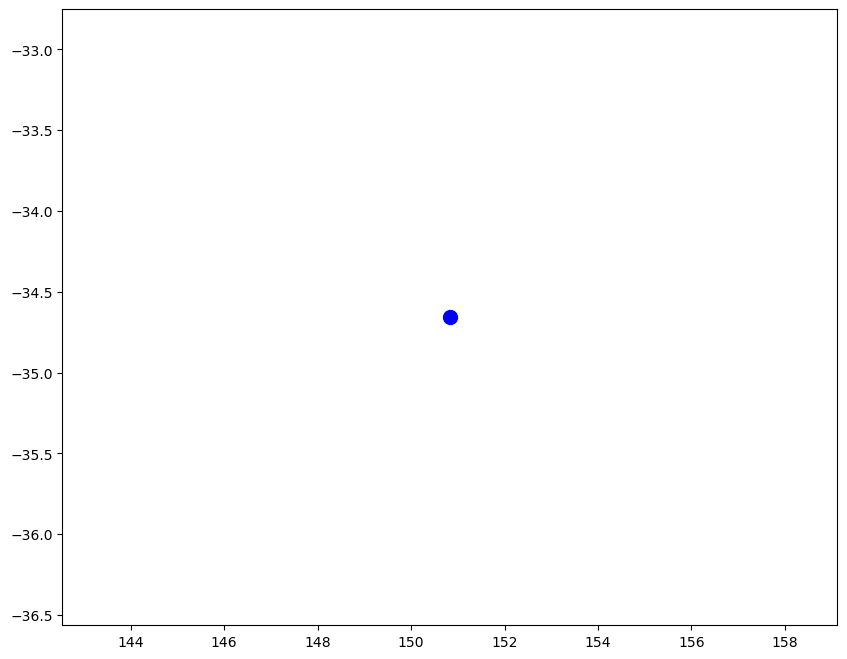

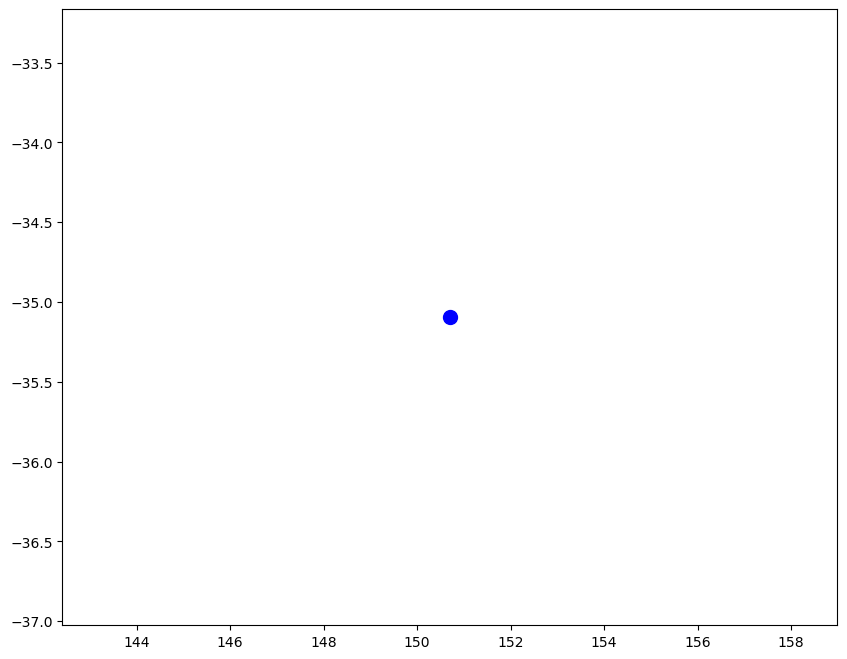

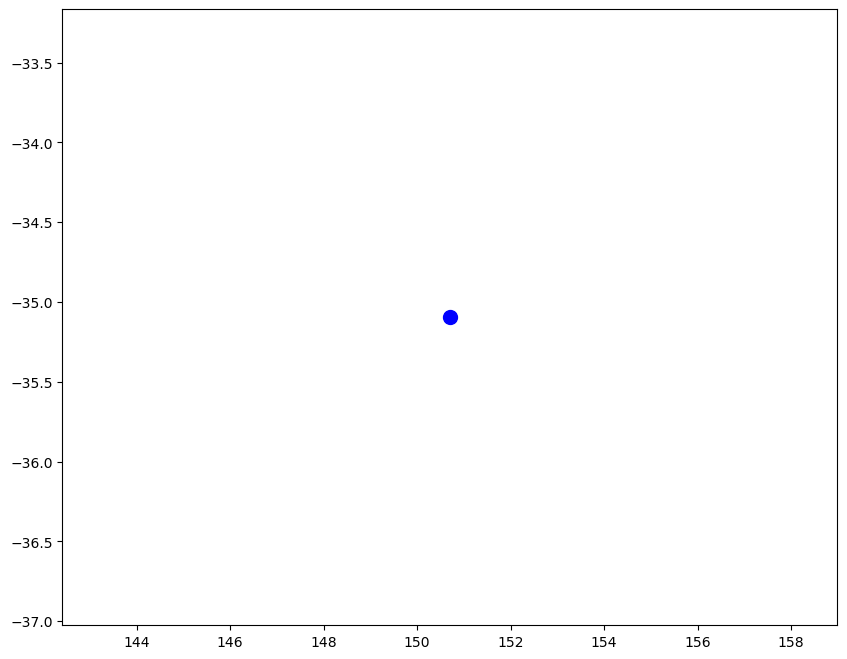

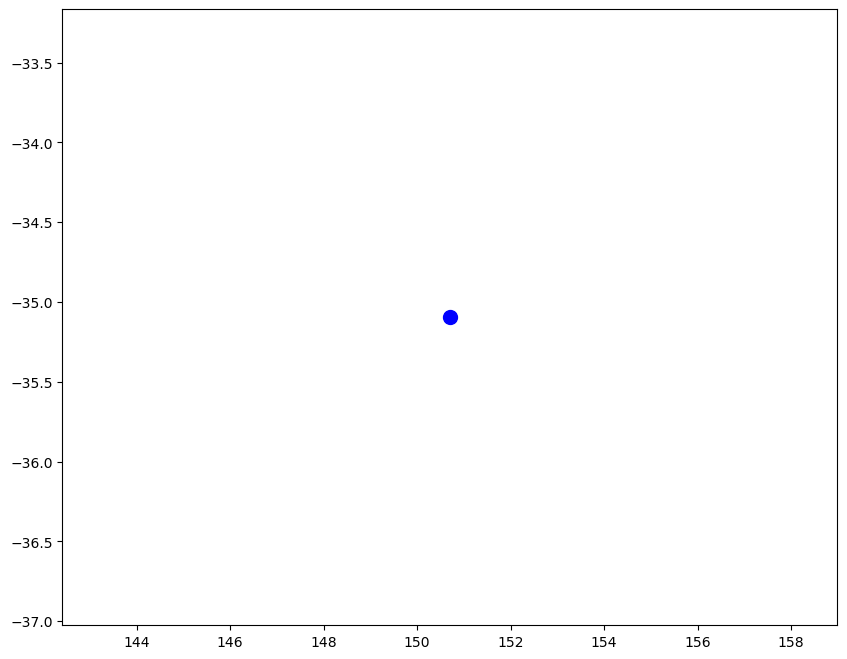

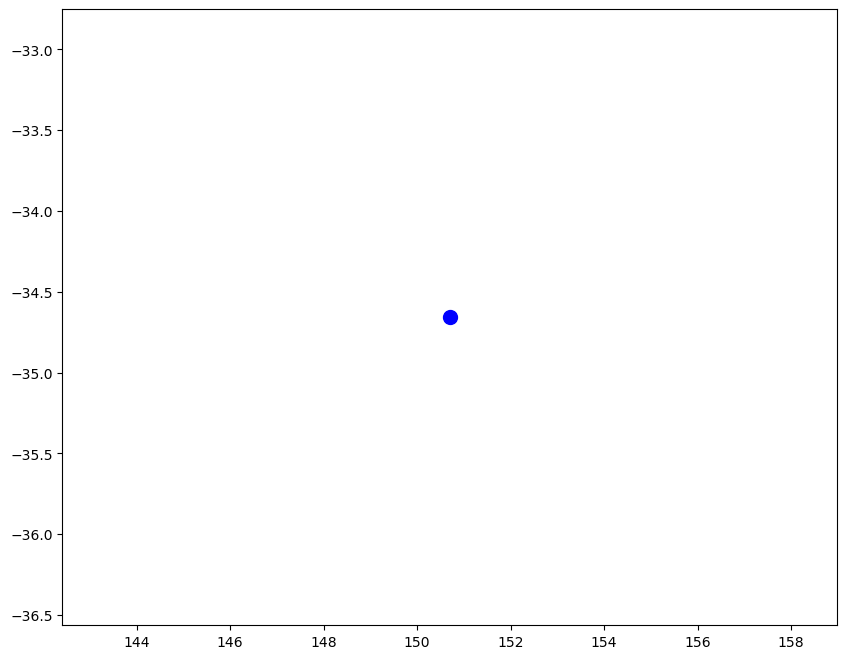

...

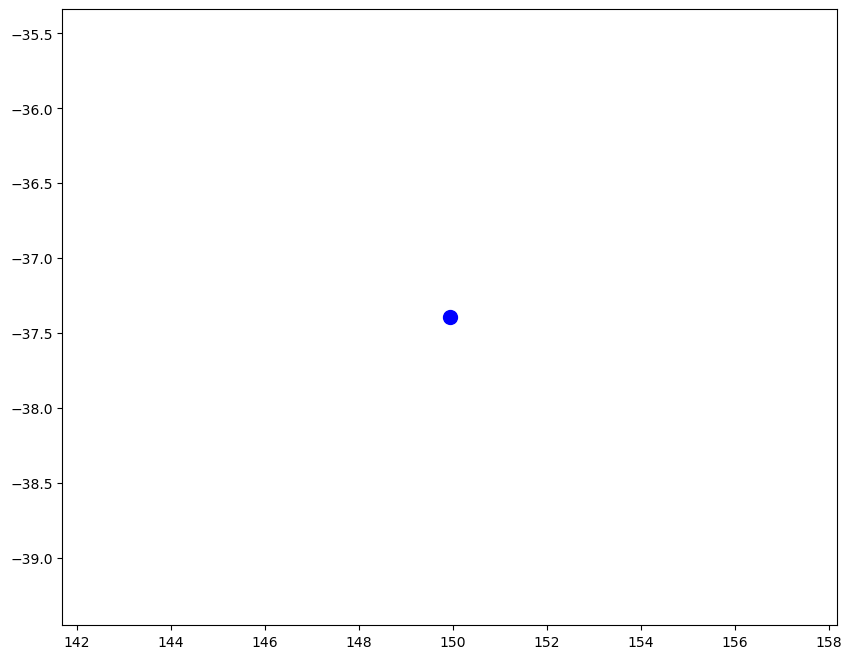

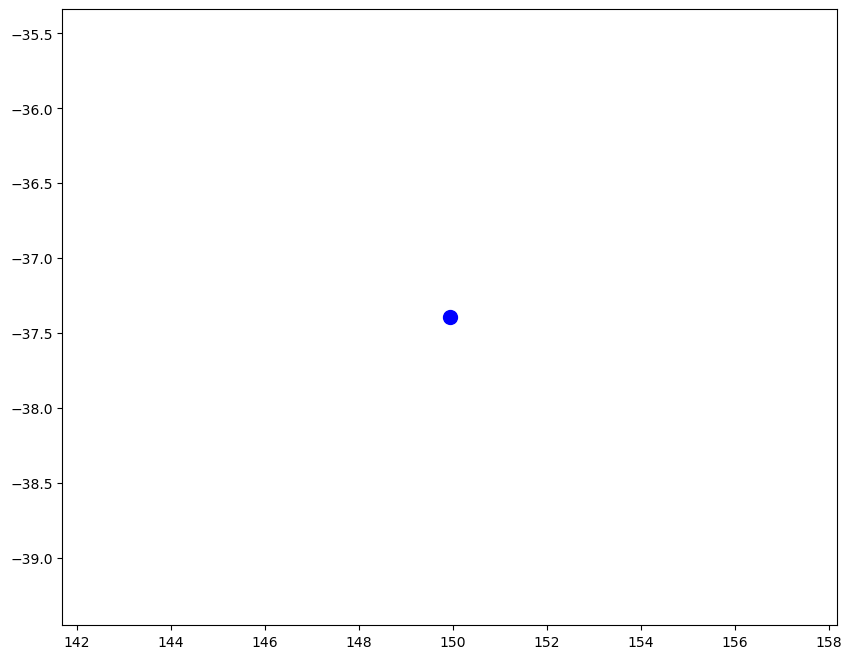

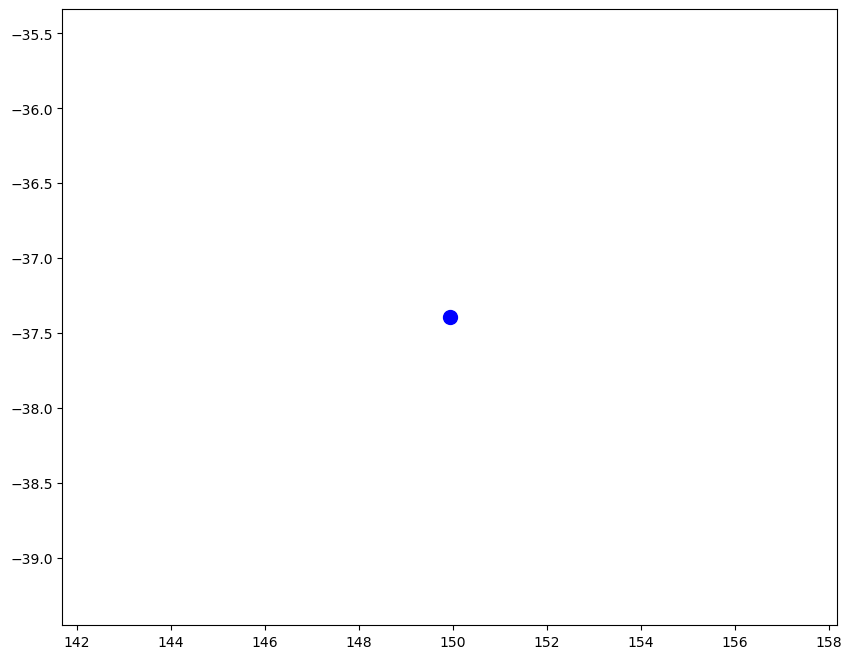

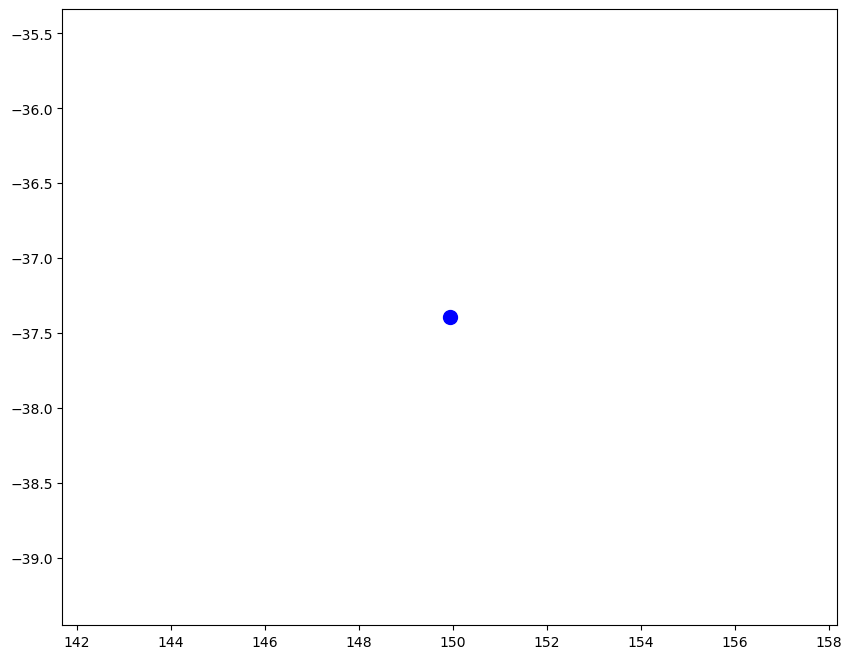

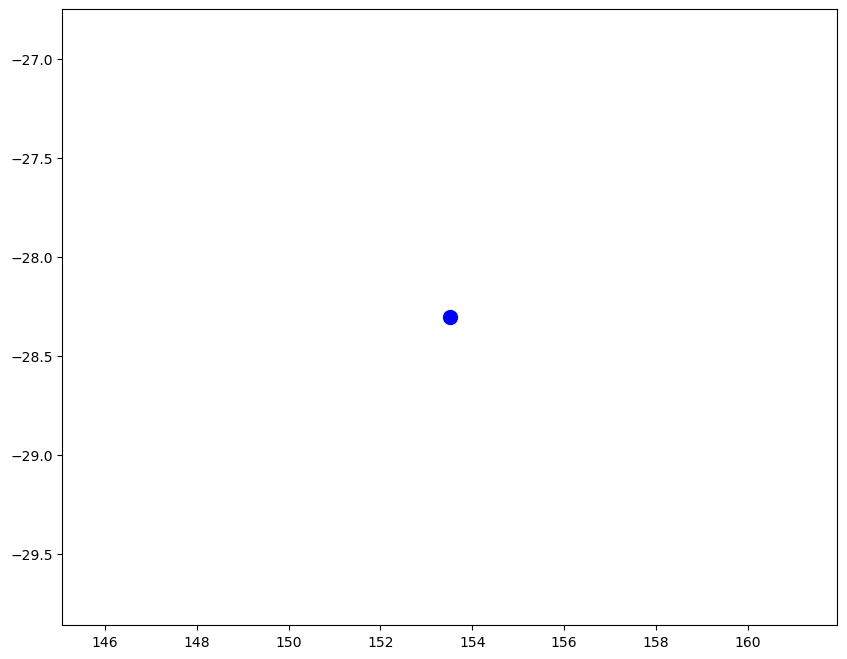

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
from scipy.spatial.distance import cdist
from sklearn.cluster import KMeans
from scipy.ndimage import gaussian_filter,maximum_filter
from scipy.sparse.csgraph import minimum_spanning_tree
import os

# Define paths
excel_file_path = '/Users/coolkarni/Desktop/OneDrive - The University of Melbourne/R1_99_New Events.xlsx'
csv_directory = '/Users/coolkarni/Documents/Documents/Documents/Master thesis Data/BoM Station Dataset/Rainfall Stored values for R1_99 Events/'
output_directory = '/Users/coolkarni/Documents/Documents/Documents/Master thesis Data/BoM Station Dataset/Map_IDW_3Plots/'

# Load event names from the Excel file, skipping NaN values
event_df = pd.read_excel(excel_file_path, sheet_name='Sheet3')
event_names = event_df['Event'].dropna().unique()

# Initialize a list to store names of files that encountered errors
error_files = []

# Set distance threshold (e.g., in degrees, assuming coordinates are in lat/lon)
distance_threshold = 2  # Adjust as needed

# Haversine function to calculate distance between two lat/long coordinates
def haversine(lon1, lat1, lon2, lat2):
    lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    c = 2 * np.arcsin(np.sqrt(a))
    r = 6371  # Radius of earth in kilometers
    return c * r

# Function to find the mean rainfall value of the 5 nearest stations
def find_nearest_stations_mean_rainfall(df, lon, lat, column):
    df['distance'] = df.apply(lambda row: haversine(lon, lat, row['Longitude'], row['Latitude']), axis=1)
    nearest_stations = df.nsmallest(5, 'distance')
    mean_rainfall = nearest_stations[column].mean()
    return mean_rainfall

# Function to perform IDW interpolation
def perform_idw(latitude, longitude, rainfall):
    try:
        # Create a grid for interpolation
        xi, yi = np.meshgrid(np.linspace(min(longitude), max(longitude), 100),
                             np.linspace(min(latitude), max(latitude), 100))
        zi = np.zeros_like(xi)

        for i in range(len(xi)):
            for j in range(len(yi)):
                distances = np.sqrt((longitude.values - xi[i, j])**2 + (latitude.values - yi[i, j])**2)
                weights = 1 / (distances + 1e-6)  # Avoid division by zero
                zi[i, j] = np.sum(weights * rainfall.values) / np.sum(weights)

        zi_smoothed = gaussian_filter(zi, sigma=2)
        return zi_smoothed, None
    except Exception as e:
        return None, str(e)

# Function to connect points within each cluster using Minimum Spanning Tree
def connect_points_within_cluster(points, ax, color):
    if len(points) < 2:
        return
    # Compute the distance matrix
    distance_matrix = cdist(points, points)
    # Compute the MST using the distance matrix
    mst = minimum_spanning_tree(distance_matrix).toarray()
    # Plot the MST
    for i in range(len(points)):
        for j in range(len(points)):
            if mst[i, j] > 0:
                ax.plot([points[i][0], points[j][0]], [points[i][1], points[j][1]], linestyle='-', color=color, alpha=0.5)

# Process each event
for event_name in event_names:
    # Construct the path to the corresponding CSV file
    csv_file = os.path.join(csv_directory, f"{event_name}.csv")
    
    try:
        # Load the CSV file
        df = pd.read_csv(csv_file)

        # Filter out NaN values in latitude and longitude
        x_cleaned = df[['Latitude', 'Longitude'] + [col for col in df.columns if col.startswith('Rainfall')]].dropna()

        # Read the shapefile (assuming you have this in your directory)
        shapefile_path = '/Users/coolkarni/Documents/Documents/Documents/Master thesis Data/combined_shapefile.shp'
        gdf = gpd.read_file(shapefile_path)

        # Create a grid of points within the bounds of the shapefile
        minx, miny, maxx, maxy = gdf.total_bounds
        xi, yi = np.meshgrid(np.linspace(minx, maxx, 100), np.linspace(miny, maxy, 100))
        positions = np.vstack([xi.ravel(), yi.ravel()])

        # Initialize lists to store coordinates of maxima and their annotations
        global_maxima_coords = []
        filtered_maxima_coords = []
        annotations = []

        # Iterate through each rainfall column and generate plots
        rainfall_columns = [col for col in x_cleaned.columns if col.startswith('Rainfall')]

        for idx, col in enumerate(rainfall_columns, start=1):
            rainfall = x_cleaned[col]

            # Perform IDW interpolation
            zi, _ = perform_idw(x_cleaned['Latitude'], x_cleaned['Longitude'], rainfall)

            # Mask the grid to include only points inside the shapefile geometry
            points = np.vstack((xi.flatten(), yi.flatten())).T
            mask = np.array([gdf.contains(Point(point)).any() for point in points])
            mask = mask.reshape(xi.shape)
            zi = np.where(mask, zi, np.nan)

            # Find global maximum
            global_max_value = np.nanmax(zi)
            global_max_index = np.unravel_index(np.nanargmax(zi), zi.shape)
            global_max_x = xi[global_max_index]
            global_max_y = yi[global_max_index]

            # Find local maxima (peaks)
            local_max = maximum_filter(zi, size=10) == zi
            peaks = np.where(local_max, zi, np.nan)

            # Calculate 50th percentile value of global maximum
            percentile_90 = 0.9 * global_max_value

            # Remove peaks not within 90th percentile of global maximum
            peaks_filtered = np.where(peaks >= percentile_90, peaks, np.nan)

            # Calculate distances from global maximum to each local maximum
            local_max_coords = np.array(list(zip(xi[np.isfinite(peaks_filtered)], yi[np.isfinite(peaks_filtered)])))
            global_max_coords = np.array([[global_max_x, global_max_y]])
            
            # Check if there are any local maxima
            if local_max_coords.shape[0] > 0:
                # Calculate distances from global maximum to each local maximum
                distances = cdist(global_max_coords, local_max_coords)[0]

                # Apply distance threshold to filter out local maxima too close to the global maximum
                valid_indices = distances > distance_threshold
                filtered_peaks_coords = local_max_coords[valid_indices]
                filtered_peaks_values = peaks_filtered[np.isfinite(peaks_filtered)][valid_indices]

                # Proceed with processing filtered peaks...
                for i, (x, y) in enumerate(filtered_peaks_coords, start=1):
                    local_max_rainfall_mean = find_nearest_stations_mean_rainfall(x_cleaned, x, y, col)
                    if local_max_rainfall_mean >= 25.0:
                        filtered_maxima_coords.append((x, y))
                        annotations.append((x, y, f'{idx}'))
            else:
                print("No local maxima found, skipping filtering.")

            # Find mean rainfall value at the global maximum
            global_max_rainfall_mean = find_nearest_stations_mean_rainfall(x_cleaned, global_max_x, global_max_y, col)

            # Check if global maxima exceeds 25.00 mm threshold
            if global_max_rainfall_mean >= 25.00:
                global_maxima_coords.append((global_max_x, global_max_y))
                annotations.append((global_max_x, global_max_y, f'{idx}'))

                # Store filtered local maxima (peaks) that also exceed 25.00 mm threshold
                for i, (x, y) in enumerate(filtered_peaks_coords, start=1):
                    local_max_rainfall_mean = find_nearest_stations_mean_rainfall(x_cleaned, x, y, col)
                    if local_max_rainfall_mean >= 25.0:
                        filtered_maxima_coords.append((x, y))
                        annotations.append((x, y, f'{idx}'))
            else:
                for i, (x, y) in enumerate(filtered_peaks_coords, start=1):
                    local_max_rainfall_mean = find_nearest_stations_mean_rainfall(x_cleaned, x, y, col)
                    if local_max_rainfall_mean >= 25.0:
                        filtered_maxima_coords.append((x, y))
                        annotations.append((x, y, f'{idx}'))

        # Combine global and filtered local maxima coordinates
        all_maxima_coords = np.array(global_maxima_coords + filtered_maxima_coords)

        # Divide the map into longitude sections and count points in each section
        long_sections = [140, 144, 148, 154]  # Define longitude section boundaries
        section_counts = [0] * (len(long_sections) - 1)
        
        # Set to store unique points that are counted
        counted_points = set()

        for lon, lat in all_maxima_coords:
            for i in range(len(long_sections) - 1):
                if long_sections[i] - 0.05 < lon < long_sections[i + 1] + 0.05:
                    counted_points.add((lon, lat))
                    section_counts[i] += 1

        # Check if at least two sections satisfy the criteria
        point_threshold = 2
        satisfying_sections = sum(count > point_threshold for count in section_counts)
        perform_clustering = satisfying_sections >= 2

        if perform_clustering:
            # Perform K-means clustering with 2 clusters as a default
            kmeans = KMeans(n_clusters=2, random_state=0)
            cluster_labels = kmeans.fit_predict(all_maxima_coords)

            # Initialize dictionaries to store points for each cluster
            clusters = {label: [] for label in set(cluster_labels)}

            # Sort points into their respective clusters
            for label, point in zip(cluster_labels, all_maxima_coords):
                clusters[label].append(point)

            # Plotting code
            fig, ax = plt.subplots(figsize=(10, 8))
            
            # Connect points within the cluster using MST
            for label in clusters:
                cluster_points = clusters[label]

                # Choose a color based on the cluster label
                color = 'red' if label == 0 else 'blue'

                # Plot points
                for x, y in cluster_points:
                    ax.plot(x, y, marker='o', color=color, markersize=10)

                # Connect points within the cluster using MST
                connect_points_within_cluster(cluster_points, ax, color)

        else:
            # If no meaningful clusters are found, plot the maxima without clustering
            fig, ax = plt.subplots(figsize=(10, 8))
           

            # Plot points for maxima
            for i, (x, y) in enumerate(all_maxima_coords):
                ax.plot(x, y, marker='o', color='blue', markersize=10)

            # Connect points within the maxima using MST
            connect_points_within_cluster(all_maxima_coords, ax, 'blue')

        # If there's only one maxima point, just plot it
        if len(all_maxima_coords) == 1:
            fig, ax = plt.subplots(figsize=(10, 8))
           
            for x, y in all_maxima_coords:
                ax.plot(x, y, marker='o', color='blue', markersize=10)

        # Annotate points with numbers
        for x, y, label in annotations:
            ax.text(x, y, label, fontsize=10, ha='center', va='bottom', color='black', weight='bold')

        

        # Save the output plot
        plt.savefig(os.path.join(output_directory, f"{event_name}_output.png"))
        plt.close()

    except Exception as e:
        # Append the event name to the error files list
        error_files.append(event_name)
        print(f"Error processing {event_name}: {e}")

# If there are any error files, save them to the new sheet in the existing Excel file
if error_files:
    # Load the existing data from the specified sheet
    try:
        existing_df = pd.read_excel(excel_file_path, sheet_name='IDW', engine='openpyxl')
    except ValueError:
        # If the sheet doesn't exist, create an empty DataFrame
        existing_df = pd.DataFrame()

    # Create a DataFrame for the new error files
    new_errors_df = pd.DataFrame({'Error Files': error_files})

    # Concatenate the existing data with the new error data
    combined_df = pd.concat([existing_df, new_errors_df], ignore_index=True)

    # Save the combined DataFrame back to the same sheet
    with pd.ExcelWriter(excel_file_path, mode='a', engine='openpyxl') as writer:
        combined_df.to_excel(writer, sheet_name='IDW', index=False)

print("Processing complete. Check the output directory for results and the Excel file for any errors.")
